# Automating stem cell count

In [1]:
# --------- Mounting Drive and Installing Packages ---------

# Are we using Colab?
try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

# If so, connect to Google account and install needed packages
if IN_COLAB:
    # We mount the drive
    from google.colab import drive
    drive.mount('/content/drive')
    ! ls drive/MyDrive/datasets/

    # We install the packages
    ! pip install czifile
    ! python -m pip install "napari[all]"
    ! python -m pip install -U scikit-image
    ! pip install pyclesperanto-prototype
    ! pip install lxml
    ! pip install stardist


In [2]:
# --------- Imports ---------

# General Imports
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch, Circle
from matplotlib.colors import LogNorm
from matplotlib.lines import Line2D

# Opening Images Imports
import czifile
from pathlib import Path
from lxml import etree


# Visualizing Images Imports
import napari
from napari.utils import nbscreenshot


# Filtering Images Imports
import skimage
import skimage.draw
from skimage import morphology
from skimage import img_as_float
from skimage import exposure
from skimage import filters
from skimage.morphology import reconstruction, disk, white_tophat, square, opening
from skimage.restoration import rolling_ball, denoise_bilateral
from skimage.filters import threshold_otsu
from skimage.measure import regionprops, regionprops_table

from scipy.ndimage import gaussian_filter
from pyclesperanto_prototype import imshow


# Image Segmentation Imports
from stardist.models import StarDist2D
from skimage.segmentation import find_boundaries

# Teselation Imports
from scipy.spatial import Voronoi, voronoi_plot_2d, distance

# Clustering Imports
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

# Bounds for coloring the regions
from shapely.geometry import Polygon, box, GeometryCollection, Point, MultiPolygon, LineString
from shapely.validation import explain_validity, make_valid

# Additional Results
import statsmodels.api as sm
import networkx as nx
from scipy.spatial import Delaunay
from scipy import stats




2024-01-04 20:42:03.790951: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-04 20:42:03.791000: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-04 20:42:03.792780: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-04 20:42:03.985550: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
if not IN_COLAB:
  %gui qt

In [4]:
# --------- Opening Images ---------

# Instantiate a Path object
if IN_COLAB:
  czi_file_path = Path(r"drive/MyDrive/datasets/ESTA - Sph1 Z Stack - CTRL SOX2.czi")
else:
  czi_file_path = Path(r"./data/Sph4 Z Stack - CTRL SOX2.czi")

# Read the image and get the CziFile object
with czifile.CziFile(czi_file_path) as czi:
    img = czi.asarray()  # Store image data in 'img' variable
    czi_object = czi  # Store the CziFile object
    metadata_xml = czi.metadata()
    metadata_tree = etree.fromstring(metadata_xml.encode('utf-8'))
    root = metadata_tree.getroottree().getroot()


In [5]:
# I want the name of the czifile as a string
czi_file_name = os.path.basename(czi_file_path)
print(czi_file_name)

Sph4 Z Stack - CTRL SOX2.czi


In [6]:
czi.shape

(1, 1, 3, 1, 6, 2292, 2292, 1)

In [7]:
czi.axes

'BVCTZYX0'

So, according to this, `img` is an array of:
- B = 1, so one block
- V = 1, so one view
- C = 3, so three channels (which makes sense, they are the optic channel, the one indicating the nuclei and the SOX2 channel)
- T = 1, so a single time frame (i.e. no $t$ component)
- Z = 9, so 9 $z$ slices
- Y = 2292, so we have that many pixels in the $y$ direction (height)
- X = 2292, idem (note that we have a square image)
- '0' = 1, indicating that we have a single sample 


I also checked the metadata, and the spacing is the same than with Sph1.
```python
<Scaling>
      <Items>
        <Distance Id="X">
          <Value>1.2364633517553391e-007</Value>
        </Distance>
        <Distance Id="Y">
          <Value>1.2364633517553394e-007</Value>
        </Distance>
        <Distance Id="Z">
          <Value>1.9999999999999999e-006</Value>
        </Distance>
      </Items>
    </Scaling>
```

In [8]:
# --------- Getting rid of the extra dimensions ---------
image_squeezed = np.squeeze(img)
image_squeezed.shape

(3, 6, 2292, 2292)

In [9]:
# --------- Separating the channels ---------

# The first channel is the corresponding to stemness
stemness_channel = image_squeezed[0, :, :, :]
# Channel 2 is the optic one
optic_channel = image_squeezed[1, :, :, :]
# Channel 3 contains the nuclei
nuclei_channel = image_squeezed[2, :, :, :]

In [10]:
#@title Using Napari for Visualization

if not IN_COLAB:
  viewer = napari.Viewer()
  viewer.add_image(nuclei_channel, colormap='blue', blending='additive')
  viewer.add_image(stemness_channel, colormap='red', blending='additive')
  viewer.add_image(optic_channel, colormap='gray', blending='additive')
  print(viewer.layers)
  # We never close the napari window and can take a screenshot whenever we like
  nbscreenshot(viewer)

[<Image layer 'nuclei_channel' at 0x75480c2a99f0>, <Image layer 'stemness_channel' at 0x754814794970>, <Image layer 'optic_channel' at 0x754807f8e1d0>]


In [11]:
# Z slice to analyze

z_slice = 2

## Stemness Channel

In [12]:
# --------- Processing the stemness channel ---------

stemness_array = np.copy(stemness_channel)

# Convert to float
stemness_floats_array = img_as_float(stemness_array)

h = 0.5

seed = stemness_floats_array - h
mask = stemness_floats_array

dilated = reconstruction(seed, mask, method='dilation')
hdome = stemness_floats_array - dilated

# Adaptive Equalization
hdome_adapteq = exposure.equalize_adapthist(hdome, clip_limit=0.03)

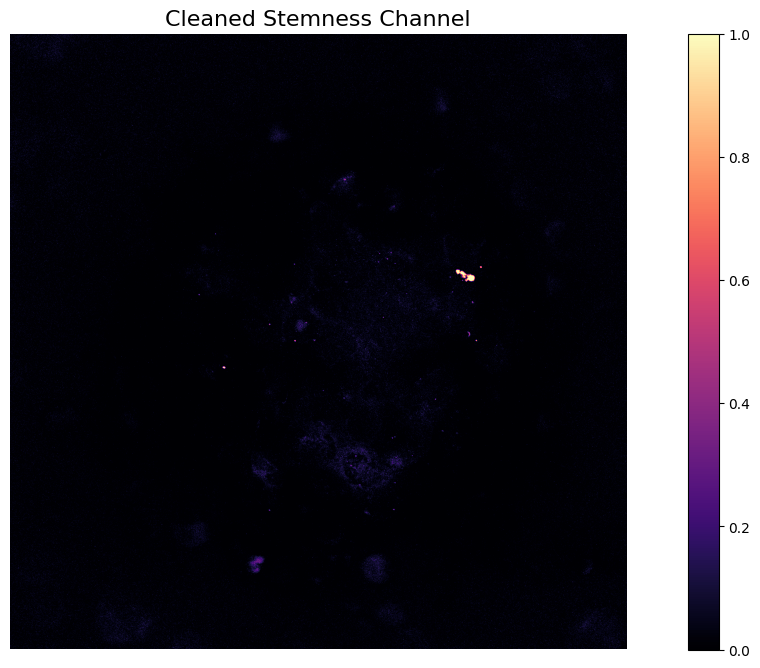

In [13]:
# --------- Visualize the result ---------

fig, ax = plt.subplots(figsize=(16, 8))
ax.imshow(hdome_adapteq[z_slice], cmap='magma')
fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap='magma'), ax=ax)
ax.axis('off')

ax.set_title('Cleaned Stemness Channel', fontsize=16)

# # Saving (Local)
# filename = "/slice_4/sox2_processed.png" # Local path
# plt.savefig(filename)


# # Saving (Colab)
# filename = "/content/sox2_processed.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)
# from google.colab import files
# files.download(filename)




plt.show()  # Display the plot

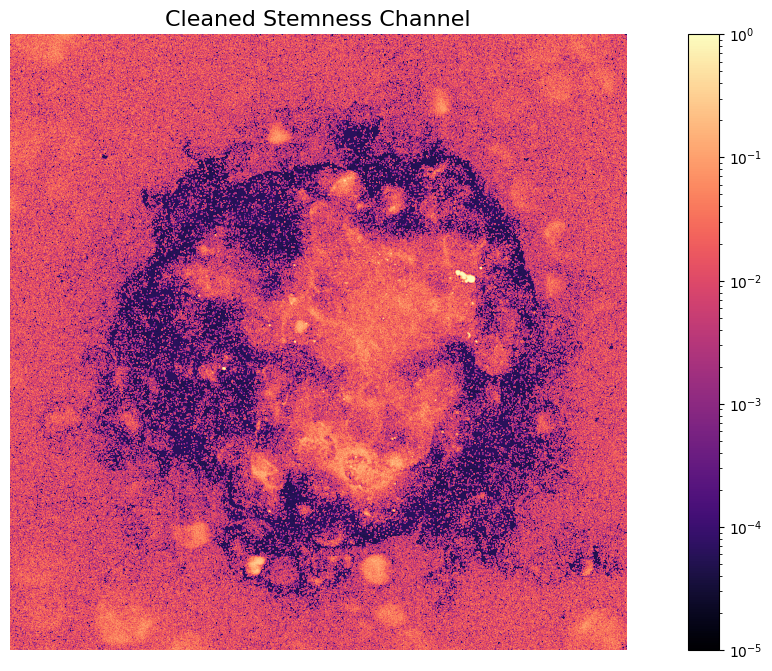

In [14]:
# --------- Visualize the result ---------

fig, ax = plt.subplots(figsize=(16, 8))

norm = LogNorm(vmin=stemness_floats_array[z_slice].min() + 1e-5, vmax=stemness_floats_array[z_slice].max())
cmap = 'magma'

ax.imshow(hdome_adapteq[z_slice], cmap=cmap, norm=norm)
fig.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax)
ax.axis('off')

ax.set_title('Cleaned Stemness Channel', fontsize=16)

# # Saving (Local)
# filename = "/slice_4/sox2_processed.png" # Local path
# plt.savefig(filename)


# # Saving (Colab)
# filename = "/content/sox2_processed.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)
# from google.colab import files
# files.download(filename)




plt.show()  # Display the plot

Notar como en la región donde no hay nada, quedó un ruido apreciable, mucho mayor al que quedó luego de la limpieza al rededor de los objetos. Para tratar con esto es que luego uno le corta la cola inferior a la distribución de intensidad de fluorescencia.

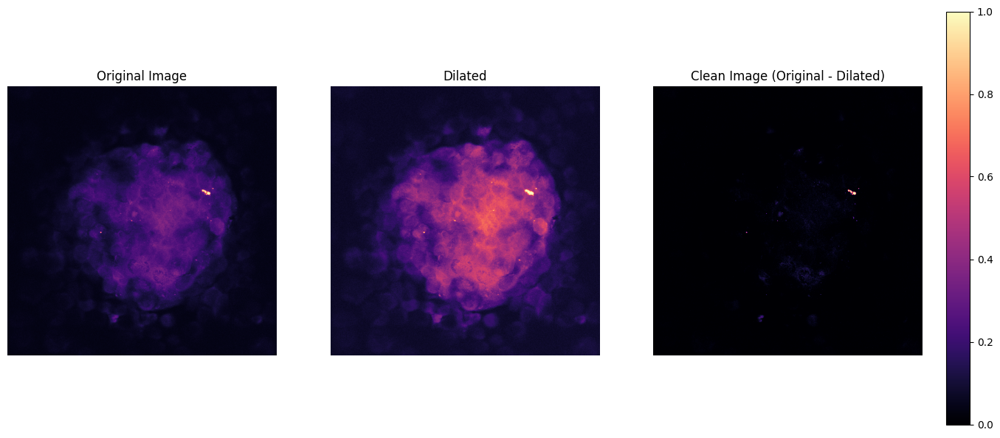

In [15]:
# Your existing code for setting up the figure and axes
fig, (ax0, ax1, ax2) = plt.subplots(nrows=1, ncols=3, figsize=(16, 8))

# First line for linear scale, second line for log scale
norm = None
# norm = LogNorm(vmin=stemness_floats_array[z_slice].min() + 1e-5, vmax=stemness_floats_array[z_slice].max())

# Plot the images with log normalization
# cmap='bwr'
cmap='magma'

ax0.imshow(stemness_floats_array[z_slice], cmap=cmap, norm=norm)
ax0.set_title('Original Image')
ax0.axis('off')

ax1.imshow(dilated[z_slice], cmap=cmap, norm=norm) # , vmin=stemness_floats_array[z_slice].min(), vmax=stemness_floats_array[z_slice].max()
ax1.set_title('Dilated')
ax1.axis('off')

ax2.imshow(hdome[z_slice], cmap=cmap, norm=norm)
ax2.set_title('Clean Image (Original - Dilated)')
ax2.axis('off')

# Add colorbar with log normalization
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # left, bottom, width, height
fig.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax, orientation='vertical')

# fig.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust the rect parameter to make space for the colorbar

plt.show()

## Nuclei Channel

In [16]:
# 0. Converting the original image to float (originally it's a 'uint16')
image_3d = np.copy(nuclei_channel)
image_2d = image_3d[z_slice]

image_normalized = image_3d.astype(np.float32) / 65535.0

# 1. Adaptive Histogram Equalization on the 3D image
image_3d_equalized = exposure.equalize_adapthist(image_3d)

# 2. Extract a 2D slice from the equalized 3D image
image_2d_equalized = image_3d_equalized[z_slice]

# 3. Morphological opening to remove small noise
selem = morphology.disk(2)  # using a disk-shaped structuring element of radius 2
image_2d_opened = morphology.opening(image_2d_equalized, selem)
image_2d_opened = morphology.area_closing(image_2d_opened, area_threshold=150)

# 4. Bilateral Filtering (denoising without bluring edges)
image_opened_bilateral = denoise_bilateral(image_2d_opened, sigma_color=0.05, sigma_spatial=15)

# 5. Load pretrained StarDist 2D model for fluorescent images
model = StarDist2D.from_pretrained('2D_versatile_fluo')

# Perform instance segmentation on the normalized binary image
labels, details = model.predict_instances(image_opened_bilateral)

# Extract boundaries from the labels
boundaries = find_boundaries(labels)

# ----------------------------------

# Overlay boundaries on the opened, filtered image
overlay = np.copy(image_opened_bilateral)
overlay[boundaries] = np.max(image_opened_bilateral)  # setting the boundary pixels to the maximum value of the image for visualization



Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


2024-01-04 20:58:55.645733: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 679477248 exceeds 10% of free system memory.
2024-01-04 20:58:56.189790: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 679477248 exceeds 10% of free system memory.
2024-01-04 20:59:03.294981: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 339738624 exceeds 10% of free system memory.
2024-01-04 20:59:04.665071: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 679477248 exceeds 10% of free system memory.


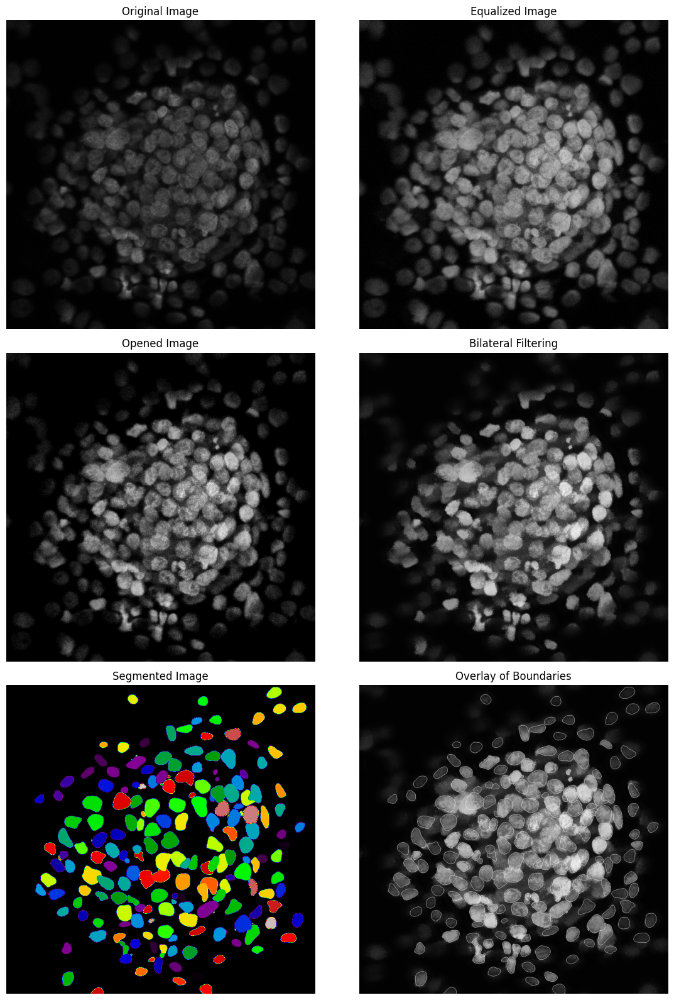

In [17]:
# --------- Visualize the result ---------


# Plotting the original, equalized, opened, and segmented images
fig, axes = plt.subplots(3, 2, figsize=(12, 16))
ax = axes.ravel()

ax[0].imshow(image_2d, cmap='gray')
ax[0].set_title("Original Image")
ax[0].axis('off')

ax[1].imshow(image_2d_equalized, cmap='gray')
ax[1].set_title("Equalized Image")
ax[1].axis('off')

ax[2].imshow(image_2d_opened, cmap='gray')
ax[2].set_title("Opened Image")
ax[2].axis('off')

ax[3].imshow(image_opened_bilateral, cmap='gray')
ax[3].set_title("Bilateral Filtering")
ax[3].axis('off')

ax[4].imshow(labels, cmap='nipy_spectral')
ax[4].set_title("Segmented Image")
ax[4].axis('off')

ax[5].imshow(overlay, cmap='gray')
ax[5].set_title("Overlay of Boundaries")
ax[5].axis('off')

plt.tight_layout()


# # Saving (Local)
# filename = "/slice_4/nuclei_processing.png" # Local path
# plt.savefig(filename)


# # Saving (Colab)
# filename = "/content/sox2_processed.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)
# from google.colab import files
# files.download(filename)



plt.show()

### Generating the DataFrame

In [18]:
# --------- Generation of the DataFrame with geometrical properties of segmented objects ---------

spacing = (1.2364633517553391e-7, 1.2364633517553391e-7)  # in meters for (y, x) dimensions

properties = [
    "label", "area", "centroid", "equivalent_diameter", "bbox_area", "convex_area", "filled_area", "major_axis_length",
    "minor_axis_length", "bbox", "weighted_centroid", "coords",
    "eccentricity", "euler_number", "extent",
    "feret_diameter_max", "max_intensity", "mean_intensity", "min_intensity",
    "orientation", "perimeter", "solidity"
]

# Extract the region properties
regions = regionprops_table(labels, intensity_image=image_opened_bilateral, properties=properties) # , spacing=spacing

# Convert the result to a DataFrame
df = pd.DataFrame(regions)
df


,label,area,centroid-0,centroid-1,equivalent_diameter,bbox_area,convex_area,filled_area,major_axis_length,minor_axis_length,...,eccentricity,euler_number,extent,feret_diameter_max,max_intensity,mean_intensity,min_intensity,orientation,perimeter,solidity
0,1,4959.0,2165.774753,1419.676548,79.460650,6862.0,5058.0,4959.0,99.039683,64.476983,...,0.759059,1,0.722676,99.724621,0.308662,0.246941,0.018840,1.192147,275.521861,0.980427
1,2,3900.0,1191.669231,2062.902564,70.467256,5418.0,3989.0,3900.0,83.411319,61.912836,...,0.670113,1,0.719823,86.700634,0.340098,0.250435,0.031249,1.450369,244.793939,0.977689
2,3,3017.0,1577.684123,1302.208817,61.978736,4092.0,3058.0,3017.0,73.046438,52.881291,...,0.689862,1,0.737292,73.573093,0.549367,0.438122,0.151221,0.687944,206.308658,0.986593
3,4,4383.0,1948.537303,1094.202145,74.703473,5704.0,4495.0,4383.0,97.166314,58.268215,...,0.800244,1,0.768408,97.169954,0.470357,0.341877,0.038968,0.252658,262.994949,0.975083
4,5,4271.0,432.584641,1026.352376,73.742838,5920.0,4334.0,4271.0,88.498728,61.563023,...,0.718393,1,0.721453,88.814413,0.166649,0.103536,0.017936,-0.929167,248.350288,0.985464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,200,12662.0,965.965092,1813.786448,126.971489,16166.0,12864.0,12662.0,138.268919,117.141671,...,0.531271,1,0.783249,143.377125,0.501652,0.320780,0.039437,-0.149564,430.504617,0.984297
200,201,1030.0,1751.157282,1074.922330,36.213764,1428.0,1062.0,1030.0,46.298093,28.749910,...,0.783831,1,0.721289,46.957428,0.191934,0.126584,0.064650,-1.106779,123.982756,0.969868
201,202,37.0,1771.513514,1826.837838,6.863663,48.0,38.0,37.0,7.854193,6.084663,...,0.632326,1,0.770833,8.544004,0.191961,0.110596,0.017115,-1.315866,20.485281,0.973684
202,203,5996.0,1769.322715,1963.342895,87.374735,7221.0,6075.0,5996.0,91.052364,84.449199,...,0.373874,1,0.830356,94.154129,0.140913,0.083985,0.028803,-0.212586,289.722871,0.986996


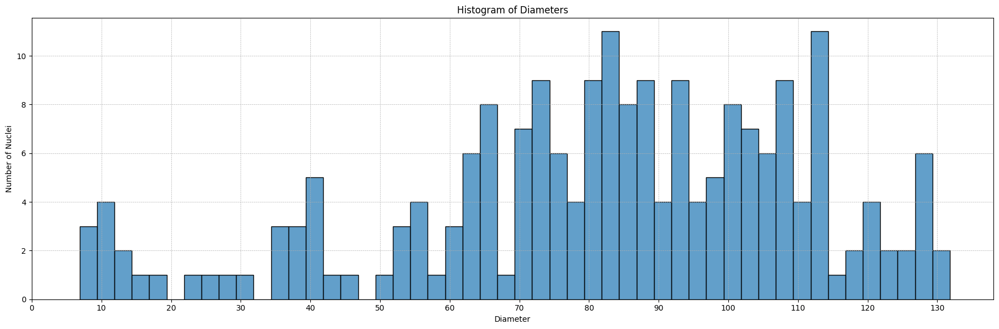

In [19]:
plt.figure(figsize=(18, 6))
sns.histplot(df, x='equivalent_diameter', bins=50, element='bars', stat='count', alpha=0.7)

# Plot customization to resemble the original plot
plt.title('Histogram of Diameters')
plt.xlabel('Diameter')
plt.ylabel('Number of Nuclei')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()


Podría cortar tomando sólo los objetos con diámetro > 24.

In [20]:
# --------- Defining in_spheroid cells ---------
# We consider cells to be in the spheroid if they are within a certain radius from the center.

# 1. Calculate center_of_spheroid FOR IN_SPHEROID (DIFFERENT FROM THE ONE FOR THE ARTIFICIAL POINTS)
center_of_spheroid_aux = df[['centroid-0', 'centroid-1']].mean().values
# we move the center a bit to the bottom left
center_of_spheroid_aux[0] += 0 # 100
center_of_spheroid_aux[1] -= 0 # 100

# 2. Calculate total_spheroid_radius
df['distance_to_center'] = np.sqrt((df['centroid-0'] - center_of_spheroid_aux[0])**2 + 
                                   (df['centroid-1'] - center_of_spheroid_aux[1])**2)
total_spheroid_radius = df['distance_to_center'].max()

# 3. Define alpha and add the 'in_spheroid' column
alpha = 0.5

df['in_spheroid'] = df['distance_to_center'] <= alpha * total_spheroid_radius

# Display counts
df['in_spheroid'].value_counts()


in_spheroid
True     112
False     92
Name: count, dtype: int64

In [21]:
# --------- Voronoi Tessellation ---------
# (including artificial points to limit cell regions)

# Centers of segmented nuclei
centroids = df[['centroid-1', 'centroid-0']].values

# (IN_SPH) Filter centroids for cells within the spheroid
centroids_in_sph = df[df['in_spheroid'] == True][['centroid-1', 'centroid-0']].values

# Calculate the center and the radius for the large circle
center_of_spheroid = np.mean(centroids, axis=0)
total_spheroid_radius = np.max(np.sqrt(np.sum((centroids - center_of_spheroid)**2, axis=1)))

# (IN_SPH) Recalculate the center and the radius for the large circle using only the centroids within the spheroid
center_of_spheroid_in_sph = center_of_spheroid_aux[::-1]  # this had the 0 component first, but we want the 1 component first
total_spheroid_radius_in_sph = alpha * total_spheroid_radius

# Define the radius of the large bounding circle
gamma = 1.2
large_circle_radius = gamma * total_spheroid_radius
large_circle_radius_in_sph = gamma * total_spheroid_radius_in_sph

# Generate points on the large circle to bound the Voronoi cells
num_artificial_points = 100
angles = np.linspace(0, 2 * np.pi, num_artificial_points, endpoint=False)
artificial_points_x = center_of_spheroid[0] + large_circle_radius * np.cos(angles)
artificial_points_y = center_of_spheroid[1] + large_circle_radius * np.sin(angles)
artificial_points = np.stack((artificial_points_x, artificial_points_y), axis=1)

# (IN_SPH) Generate points on the large circle to bound the Voronoi cells
artificial_points_x_in_sph = center_of_spheroid_in_sph[0] + large_circle_radius_in_sph * np.cos(angles)
artificial_points_y_in_sph = center_of_spheroid_in_sph[1] + large_circle_radius_in_sph * np.sin(angles)
artificial_points_in_sph = np.stack((artificial_points_x_in_sph, artificial_points_y_in_sph), axis=1)

# Combine the original centroids with the artificial points
all_points = np.vstack((centroids, artificial_points))
all_points_in_sph = np.vstack((centroids_in_sph, artificial_points_in_sph))  # Only centroids within the spheroid

# Calculate the Voronoi diagram for all combined points
vor = Voronoi(all_points)

# (IN_SPH) Calculate the Voronoi diagram for points within the spheroid (ONLY FOR PLOTTING PURPOSES)
vor_in_sph = Voronoi(all_points_in_sph)


In [22]:
# --------- Counting Fluorescence Intensity in each region ---------
# (excluding artificial points)

sox2_img = hdome[z_slice]
# sox2_img = average_hdome_adapteq

# Create a blank image for Voronoi segmentation
voronoi_regions = np.zeros_like(sox2_img, dtype=int)

intensity_sums = [0] * len(centroids)  # Initialize intensity sums with zeros

# Iterate through each original point's region
for point_idx, region_idx in enumerate(vor.point_region[:len(centroids)]):  # Only original points
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0:  # Check if the region is not infinite and not empty
        polygon_points = [vor.vertices[i] for i in region]
        polygon = Polygon(polygon_points)

        # Fix any invalid polygons
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # Draw the polygon to get the region
        rr, cc = skimage.draw.polygon(polygon.exterior.xy[1], polygon.exterior.xy[0], voronoi_regions.shape)
        voronoi_regions[rr, cc] = point_idx + 1  # Add 1 to avoid using zero as a label
        intensity_sums[point_idx] += np.sum(sox2_img[rr, cc])  # Update the intensity sum for this region

# Add the intensity sums to the dataframe
df['Fluorescence_Intensity'] = intensity_sums

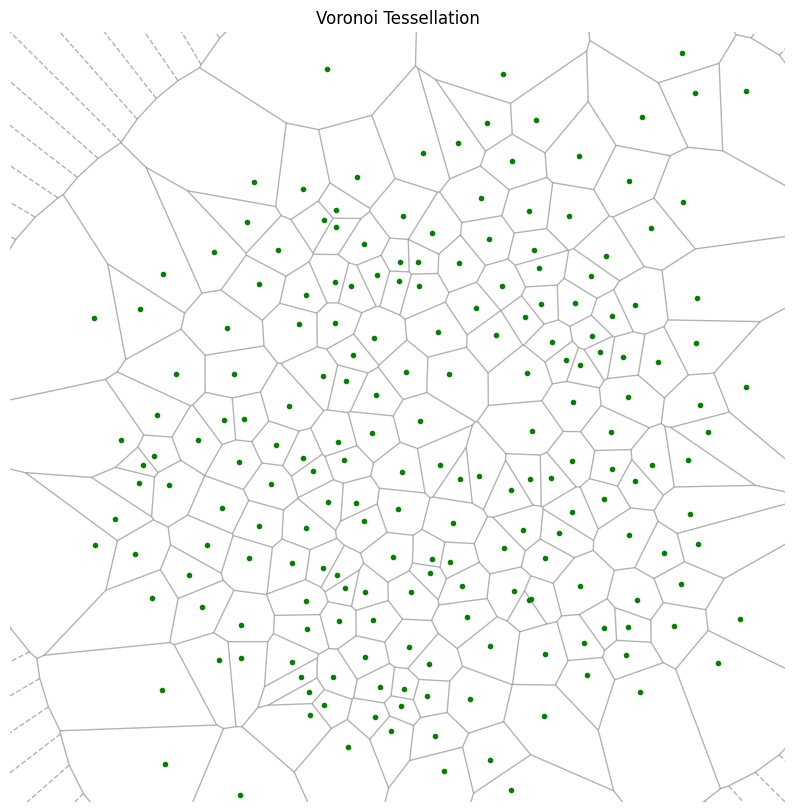

In [23]:
# --------- Voronoi Tessellation ---------

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid


ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation')
plt.axis('off')

plt.show()

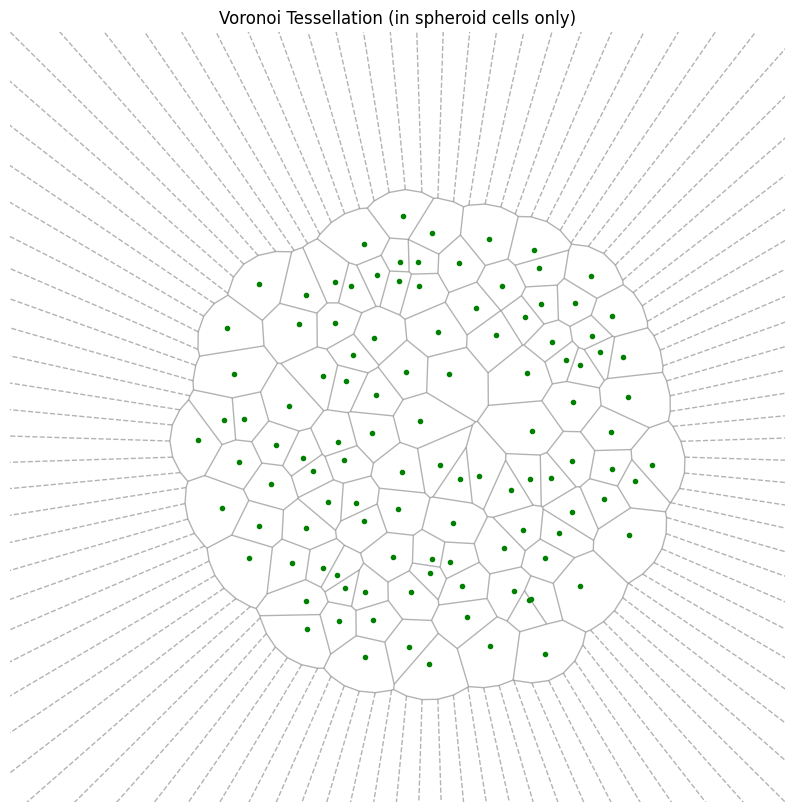

In [24]:
# --------- Voronoi Tessellation IN_SPH ---------

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor_in_sph, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Display the centroids
for (r, c) in centroids_in_sph:
    ax.plot(r, c, 'g.')  # green dot for each centroid


ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation (in spheroid cells only)')
plt.axis('off')

plt.show()

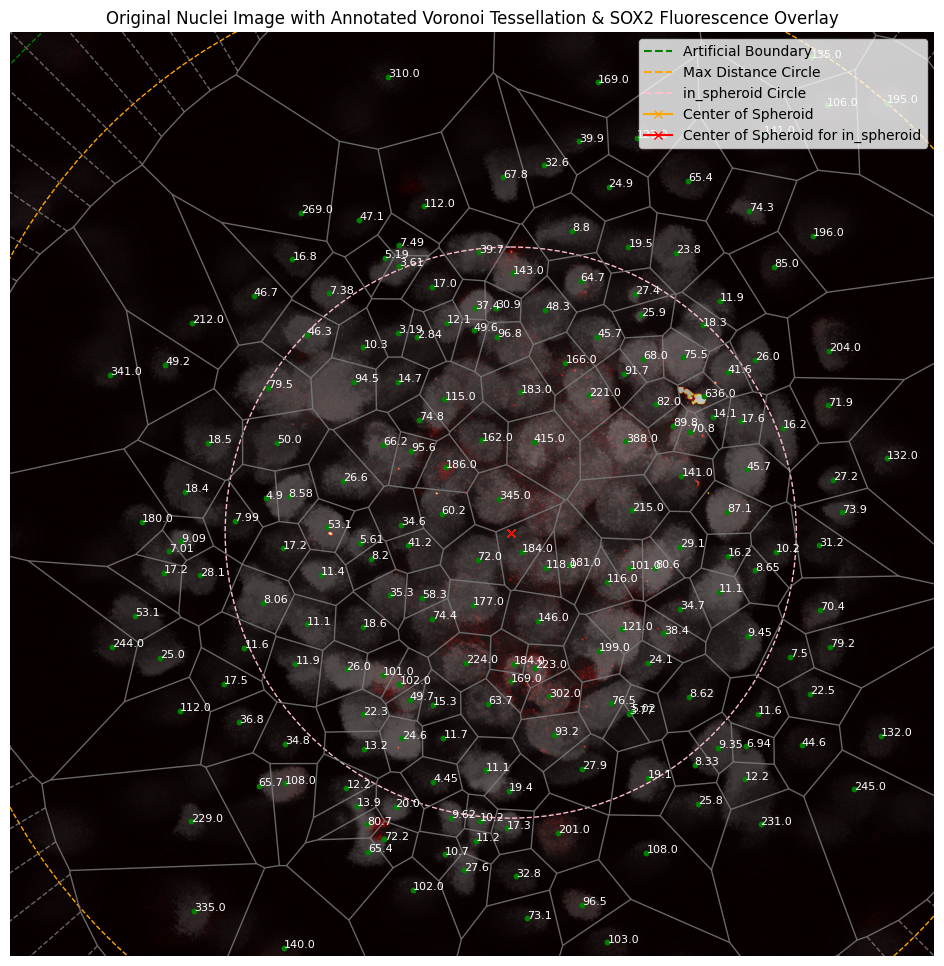

In [25]:
# --------- Regions, Nuclei and SOX2 Overlay ---------

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(12, 12)) # I used a 10x10 figure for the original image, 12x12 is better for the annotated one
ax.imshow(image_opened_bilateral, cmap='gray')


# ---

# Center of spheroid
ax.plot(*center_of_spheroid[::1], color='orange', marker='x')
ax.plot(*center_of_spheroid_aux[::-1], color='red', marker='x')


# Artificial Boundary Circle
circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
ax.add_patch(circle)

# Max distance circle
circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
ax.add_patch(circle)

# in_spheroid Circle
circle = Circle(center_of_spheroid_aux[::-1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
ax.add_patch(circle)

# ---

# Annotate each centroid with its Fluorescence_Intensity, using only the first two significant digits
for idx, (r, c) in enumerate(centroids):
    intensity = df.at[idx, 'Fluorescence_Intensity']
    intensity = float(f'{intensity:.3g}')
    ax.plot(r, c, 'g.')  # Mark the centroid
    ax.text(r, c, str(intensity), color='white', fontsize=8)  # Annotate with intensity

# ---


# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.8)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid


# Let's include the legend for the circles and the centers
legend_labels = [Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
                 Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
                 Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle'),
                 Line2D([0], [0], color='orange', marker='x', label='Center of Spheroid'),
                 Line2D([0], [0], color='red', marker='x', label='Center of Spheroid for in_spheroid')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Annotated Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

Nota: Diámetro usando círculo `in_spheroid`

Si no queremos tener en cuenta las células que están disgregadas (y que, por lo tanto, no pertenecen al esferoide) podemos tomar el radio del círculo que usamos para decidir cuáles pertenecían al esferoide como el radio del esferoide (o sea, usar el círculo rosa de la celda anterior).

In [26]:
def get_node(path, root_node):
    """
    Retrieve a specific node by path.
    """
    elements = root_node.xpath(path)
    if elements:
        return elements[0]
    else:
        raise ValueError(f"No node found for path: {path}")

# Attempt to retrieve the scaling information
try:
    scaling_x_attrib = get_node('//Scaling/Items/Distance[1]', root_node=root).attrib
    scaling_x_value = get_node('//Scaling/Items/Distance[1]/Value[1]', root_node=root).text
    scaling_y_attrib = get_node('//Scaling/Items/Distance[2]', root_node=root).attrib
    scaling_y_value = get_node('//Scaling/Items/Distance[2]/Value[1]', root_node=root).text

    print("X Scaling Attributes:", scaling_x_attrib)
    print("X Scaling Value:", scaling_x_value)
    print("Y Scaling Attributes:", scaling_y_attrib)
    print("Y Scaling Value:", scaling_y_value)
    
    # Convert the scaling values from strings to floats
    spacing_x = float(scaling_x_value)
    spacing_y = float(scaling_y_value)
    print(f'Spacing (micrometers): x = {spacing_x*1e6}, y = {spacing_y*1e6}')
    
except Exception as e:
    print("Error retrieving scaling information:", e)


X Scaling Attributes: {'Id': 'X'}
X Scaling Value: 1.2364633517553391e-007
Y Scaling Attributes: {'Id': 'Y'}
Y Scaling Value: 1.2364633517553394e-007
Spacing (micrometers): x = 0.12364633517553392, y = 0.12364633517553394


In [27]:
# # meters per pixel in y and x dimensions
# spacing_y, spacing_x = 1.2364633517553391e-7, 1.2364633517553391e-7

if spacing_x==spacing_y:
    spheroid_radius_microns = alpha * total_spheroid_radius * spacing[0] * 1e6
    print(f'Spheroid radius: {spheroid_radius_microns:.2f} microns')
else:
    print('Warning: spacing in x and y dimensions are different. This case is not handled yet.')

In [28]:
# As the difference is really small, we can just use the average
print(f'Difference between spacing in x and y dimensions: {spacing_x - spacing_y:.2e} meters')
approx_spacing = (spacing_x + spacing_y) / 2
approx_spheroid_radius_microns = alpha * total_spheroid_radius * approx_spacing * 1e6
print(f'*Approximate* spheroid radius: {approx_spheroid_radius_microns:.2f} microns')


Difference between spacing in x and y dimensions: -2.65e-23 meters
*Approximate* spheroid radius: 87.58 microns


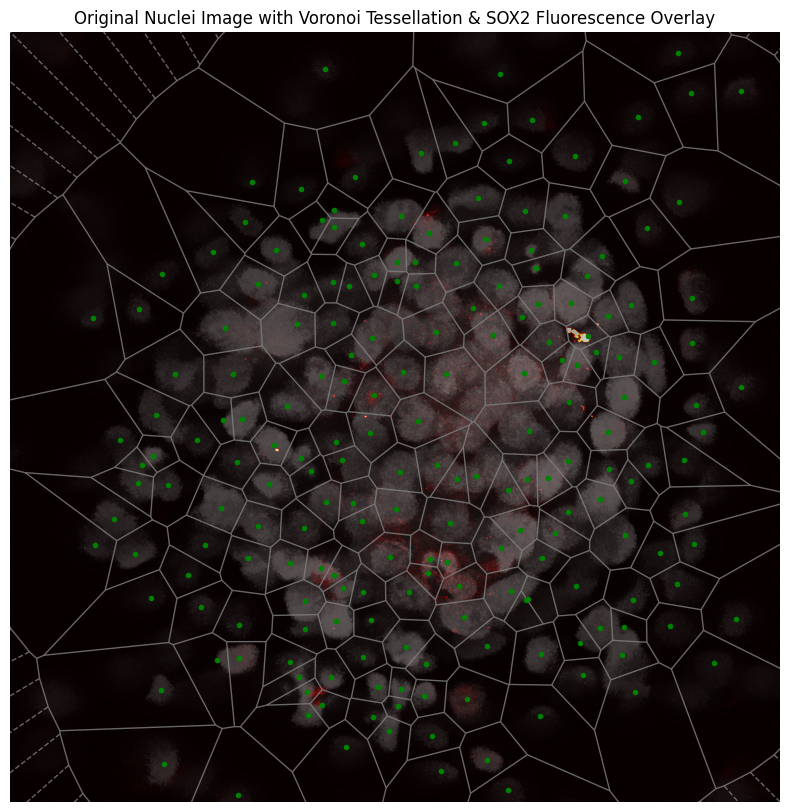

In [29]:
# --------- Regions, Nuclei and SOX2 Overlay ---------

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10)) # I used a 10x10 figure for the original image, 12x12 is better for the annotated one
ax.imshow(image_opened_bilateral, cmap='gray')

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# # Annotate each centroid with its Fluorescence_Intensity, using only the first two significant digits
# for idx, (r, c) in enumerate(centroids):
#     intensity = df.at[idx, 'Fluorescence_Intensity']
#     intensity = float(f'{intensity:.3g}')
#     ax.plot(r, c, 'g.')  # Mark the centroid
#     ax.text(r, c, str(intensity), color='white', fontsize=8)  # Annotate with intensity

# ---


# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.8)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid


# # Let's include the legend for the circles
# legend_labels = [Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

# ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

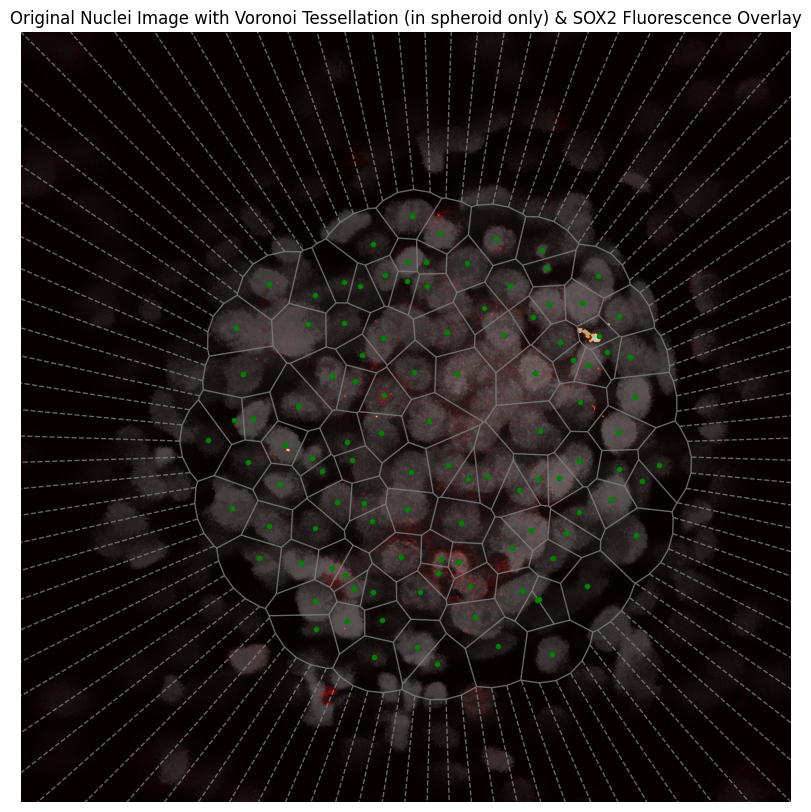

In [30]:
# --------- Regions, Nuclei and SOX2 Overlay ---------

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10)) # I used a 10x10 figure for the original image, 12x12 is better for the annotated one
ax.imshow(image_opened_bilateral, cmap='gray')

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# # Annotate each centroid with its Fluorescence_Intensity, using only the first two significant digits
# for idx, (r, c) in enumerate(centroids):
#     intensity = df.at[idx, 'Fluorescence_Intensity']
#     intensity = float(f'{intensity:.3g}')
#     ax.plot(r, c, 'g.')  # Mark the centroid
#     ax.text(r, c, str(intensity), color='white', fontsize=8)  # Annotate with intensity

# ---


# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor_in_sph, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.8)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids_in_sph:
    ax.plot(r, c, 'g.')  # green dot for each centroid


# # Let's include the legend for the circles
# legend_labels = [Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

# ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation (in spheroid only) & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

## Stem and Differentiated Cell Clustering

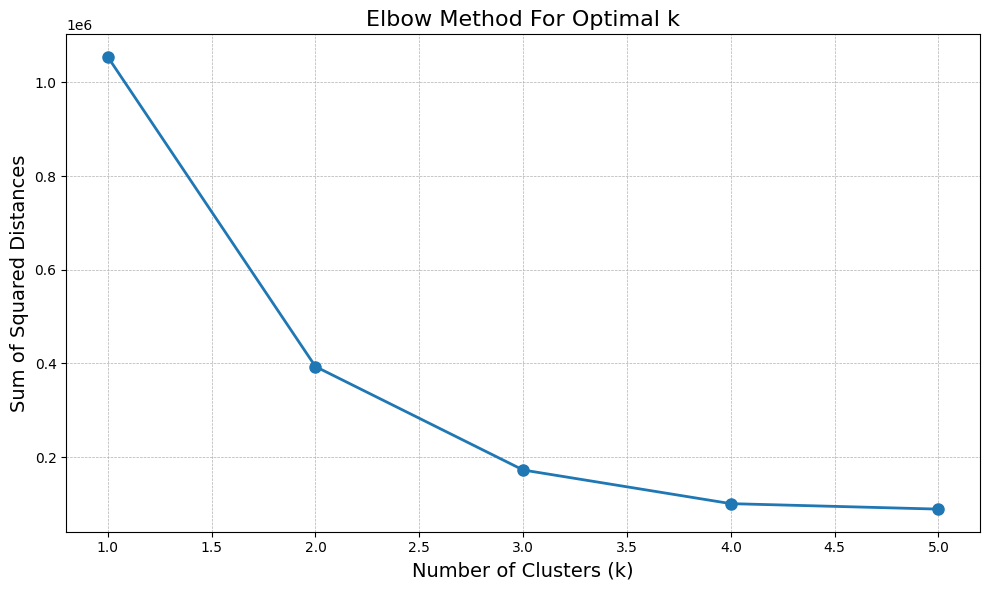

In [31]:
# --------- Elbow plot for cluster number ---------

# Extract fluorescence intensity values from the DataFrame
fluorescence_intensities = df['Fluorescence_Intensity'].loc[df["in_spheroid"]==True].values.reshape(-1, 1)

# Calculate sum of squared distances (SSD) for different values of k
ssd = []
range_n_clusters = range(1, 6)

for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++', n_init='auto', random_state=42)
    kmeans.fit(fluorescence_intensities)
    ssd.append(kmeans.inertia_)

# Plot the SSD values against k to visualize the elbow
plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, ssd, 'o-', linewidth=2, markersize=8)
plt.xlabel('Number of Clusters (k)', fontsize=14)
plt.ylabel('Sum of Squared Distances', fontsize=14)
plt.title('Elbow Method For Optimal k', fontsize=16)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

In [32]:
# ======== Original Way ========

# Filter out regions with Fluorescence_Intensity <= 180
filtered_df = df[df['Fluorescence_Intensity'] <= 180].copy()  # Use copy() to ensure we're working on a copy

# Reshape the Fluorescence_Intensity data for clustering
X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

# Set a seed for reproducibility
random_state = 42

# Perform GMM clustering with k=2, using the random_state for reproducibility
gmm = GaussianMixture(n_components=2, random_state=random_state)
gmm.fit(X)

# Get the clustering labels
labels = gmm.predict(X)

# Compute the mean fluorescence intensity for each cluster
cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

# Identify the labels of the clusters with higher and lower mean intensities
label_higher_intensity = cluster_means.argmax()
label_lower_intensity = cluster_means.argmin()

# Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
labels[labels == label_lower_intensity] = 0
labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

# Assign the corrected labels to the filtered dataframe
filtered_df.loc[:, 'filtered_GMM_stemness'] = labels


# Assign the corrected labels to the filtered dataframe
filtered_df.loc[:, 'filtered_GMM_stemness'] = labels

# Create a new column in the original dataframe for the mapped labels, initialized to NaN
df['filtered_GMM_stemness'] = np.nan

# Map the GMM_stemness labels back to the original df
df.update(filtered_df['filtered_GMM_stemness'])

# Set the values to 1 where Fluorescence_Intensity > 180
df.loc[df['Fluorescence_Intensity'] > 180, 'filtered_GMM_stemness'] = 1


In [33]:
# ========== NEW CLUSTERING EXCLUDING CELLS OUTSIDE THE SPHEROID (still with <180 fliter) ==========

# Filter out regions with Fluorescence_Intensity <= 180 and in_spheroid = True
filtered_df = df[(df['Fluorescence_Intensity'] <= 180) & (df['in_spheroid'])].copy()

# Reshape the Fluorescence_Intensity data for clustering
X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

# Set a seed for reproducibility
random_state = 42

# Perform GMM clustering with k=2, using the random_state for reproducibility
gmm = GaussianMixture(n_components=2, random_state=random_state)
gmm.fit(X)


# Get the clustering labels
labels = gmm.predict(X)

# Compute the mean fluorescence intensity for each cluster
cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

# Identify the labels of the clusters with higher and lower mean intensities
label_higher_intensity = cluster_means.argmax()
label_lower_intensity = cluster_means.argmin()

# Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
labels[labels == label_lower_intensity] = 0
labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

# Assign the corrected labels to the filtered dataframe
filtered_df.loc[:, 'filtered_in_spheroid_GMM_stemness'] = labels

# Create a new column in the original dataframe for the mapped labels, initialized to NaN
df['filtered_in_spheroid_GMM_stemness'] = np.nan

# Map the GMM_stemness labels back to the original df
df.update(filtered_df[['filtered_in_spheroid_GMM_stemness']])

# Set the values to 1 where Fluorescence_Intensity > 180 and in_spheroid = True
df.loc[(df['Fluorescence_Intensity'] > 180) & (df['in_spheroid']), 'filtered_in_spheroid_GMM_stemness'] = 1


In [34]:
# ========== CUTTING DISTRIBUTION TAILS ==========

# Calculate the 5th and 95th percentile values of Fluorescence_Intensity
lower_threshold = df['Fluorescence_Intensity'].quantile(0.05)
upper_threshold = df['Fluorescence_Intensity'].quantile(0.95)

# Initialize the 'tails_cut_GMM_stemness' column with NaN
df['tails_cut_GMM_stemness'] = np.nan

# Assign 0 to the 5% lowest intensity regions (non-stem)
df.loc[df['Fluorescence_Intensity'] <= lower_threshold, 'tails_cut_GMM_stemness'] = 0

# Assign 1 to the 95% highest intensity regions (stem)
df.loc[df['Fluorescence_Intensity'] >= upper_threshold, 'tails_cut_GMM_stemness'] = 1

# Filter the dataframe for the regions to be included in GMM clustering
filtered_df = df[(df['Fluorescence_Intensity'] > lower_threshold) & (df['Fluorescence_Intensity'] < upper_threshold)].copy()

# Reshape the Fluorescence_Intensity data for clustering
X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

# Set a seed for reproducibility
random_state = 42

# Perform GMM clustering with k=2, using the random_state for reproducibility
gmm = GaussianMixture(n_components=2, random_state=random_state)
gmm.fit(X)


# Get the clustering labels
labels = gmm.predict(X)

# Compute the mean fluorescence intensity for each cluster
cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

# Identify the labels of the clusters with higher and lower mean intensities
label_higher_intensity = cluster_means.argmax()
label_lower_intensity = cluster_means.argmin()

# Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
labels[labels == label_lower_intensity] = 0
labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

# Assign the corrected labels to the filtered dataframe
filtered_df.loc[:, 'tails_cut_GMM_stemness'] = labels

# Update the original dataframe with the GMM clustering results
df.update(filtered_df['tails_cut_GMM_stemness'])



In [35]:
df['tails_cut_GMM_stemness'].value_counts()

tails_cut_GMM_stemness
1.0    111
0.0     93
Name: count, dtype: int64

In [36]:
df['tails_cut_GMM_stemness'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 204 entries, 0 to 203
Series name: tails_cut_GMM_stemness
Non-Null Count  Dtype  
--------------  -----  
204 non-null    float64
dtypes: float64(1)
memory usage: 1.7 KB


In [37]:
# ========== EXCLUDING CELLS OUTSIDE THE SPHEROID AND CUTTING DISTRIBUTION TAILS ==========


# Calculate the 5th and 95th percentile values of Fluorescence_Intensity within the spheroid
lower_threshold = df[df['in_spheroid']]['Fluorescence_Intensity'].quantile(0.05)
upper_threshold = df[df['in_spheroid']]['Fluorescence_Intensity'].quantile(0.95)

# Initialize the 'tails_cut_in_spheroid_GMM_stemness' column with NaN (into which we'll map the GMM labels)
df['tails_cut_in_spheroid_GMM_stemness'] = np.nan

# Assign 0 to the 5% lowest intensity regions within the spheroid (non-stem)
df.loc[(df['Fluorescence_Intensity'] <= lower_threshold) & (df['in_spheroid']), 'tails_cut_in_spheroid_GMM_stemness'] = 0

# Assign 1 to the 95% highest intensity regions within the spheroid (stem)
df.loc[(df['Fluorescence_Intensity'] >= upper_threshold) & (df['in_spheroid']), 'tails_cut_in_spheroid_GMM_stemness'] = 1

# Filter the dataframe for the regions to be included in GMM clustering (inside the spheroid and not in the tails)
filtered_df = df[(df['Fluorescence_Intensity'] > lower_threshold) & 
                 (df['Fluorescence_Intensity'] < upper_threshold) & 
                 (df['in_spheroid'])].copy()

# Reshape the Fluorescence_Intensity data for clustering
X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

# Set a seed for reproducibility
random_state = 42

# Perform GMM clustering with k=2, using the random_state for reproducibility
gmm = GaussianMixture(n_components=2, random_state=random_state)
gmm.fit(X)


# Get the clustering labels
labels = gmm.predict(X)

# Compute the mean fluorescence intensity for each cluster
cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

# Identify the labels of the clusters with higher and lower mean intensities
label_higher_intensity = cluster_means.argmax()
label_lower_intensity = cluster_means.argmin()

# Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
labels[labels == label_lower_intensity] = 0
labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

# Assign the corrected labels to the filtered dataframe
filtered_df.loc[:, 'tails_cut_in_spheroid_GMM_stemness'] = labels


# Map the GMM_stemness labels back to the original df
df.update(filtered_df[['tails_cut_in_spheroid_GMM_stemness']])

# Note: Regions outside the spheroid or in the tails are already handled with NaN or the set values (0 and 1)


In [38]:
df[['label', 'Fluorescence_Intensity', 'filtered_GMM_stemness', 'filtered_in_spheroid_GMM_stemness', 'tails_cut_GMM_stemness', 'tails_cut_in_spheroid_GMM_stemness']].loc[df['Fluorescence_Intensity']>85].loc[df['Fluorescence_Intensity']<95].sort_values(by='Fluorescence_Intensity')

,label,Fluorescence_Intensity,filtered_GMM_stemness,filtered_in_spheroid_GMM_stemness,tails_cut_GMM_stemness,tails_cut_in_spheroid_GMM_stemness
79,80,87.140024,1.0,1.0,1.0,1.0
189,190,89.848493,1.0,1.0,1.0,1.0
47,48,91.725353,1.0,1.0,1.0,1.0
145,146,93.210880,1.0,1.0,1.0,1.0
183,184,94.471321,1.0,1.0,1.0,1.0


### Summary

In [39]:
# ========== CALCULATING SUMMARY STATISTICS ==========

# ====== General Information ======
czi_file_name = os.path.basename(czi_file_path)
total_cells = df.shape[0]
cells_in_spheroid = df.loc[df['in_spheroid']==True].shape[0]
cells_outside_spheroid = df.loc[df['in_spheroid']==False].shape[0]


# ====== For 'filtered_GMM_stemness' ======
filtered_GMM_stemness_ones = df['filtered_GMM_stemness'].sum()
percentage_filtered_GMM_stemness_ones = filtered_GMM_stemness_ones / df.shape[0] * 100


# ====== For 'filtered_in_spheroid_GMM_stemness' ======
filtered_in_spheroid_GMM_stemness_ones = df['filtered_in_spheroid_GMM_stemness'].sum()
percentage_in_sph_filtered_in_spheroid_GMM_stemness_ones = filtered_in_spheroid_GMM_stemness_ones / df.loc[df['in_spheroid']==True].shape[0] * 100
percentage_total_filtered_in_spheroid_GMM_stemness_ones = filtered_in_spheroid_GMM_stemness_ones / df.shape[0] * 100


# ====== For 'tails_cut_GMM_stemness' ======
tails_cut_GMM_stemness_ones = df['tails_cut_GMM_stemness'].sum()
percentage_tails_cut_GMM_stemness_ones = tails_cut_GMM_stemness_ones / df.shape[0] * 100


# ====== For 'tails_cut_in_spheroid_GMM_stemness' ======
tails_cut_in_spheroid_GMM_stemness_ones = df['tails_cut_in_spheroid_GMM_stemness'].sum()
percentage_in_sph_tails_cut_in_spheroid_GMM_stemness_ones = tails_cut_in_spheroid_GMM_stemness_ones / df.loc[df['in_spheroid']==True].shape[0] * 100
percentage_total_tails_cut_in_spheroid_GMM_stemness_ones = tails_cut_in_spheroid_GMM_stemness_ones / df.shape[0] * 100


# ====== Calculate thresholds for each feature ======
def calculate_thresholds(df, feature):
    # Sort the DataFrame by Fluorescence_Intensity
    sorted_df = df.sort_values(by='Fluorescence_Intensity')
    # Identify the max intensity for class 0 and min intensity for class 1
    max_intensity_class_0 = sorted_df[sorted_df[feature] == 0]['Fluorescence_Intensity'].max()
    min_intensity_class_1 = sorted_df[sorted_df[feature] == 1]['Fluorescence_Intensity'].min()
    # Calculate the average to define the threshold
    return (max_intensity_class_0 + min_intensity_class_1) / 2.0

# Calculate thresholds
threshold_filtered_GMM = calculate_thresholds(df, 'filtered_GMM_stemness')
threshold_filtered_in_spheroid = calculate_thresholds(df[df['in_spheroid']==True], 'filtered_in_spheroid_GMM_stemness')
threshold_tails_cut = calculate_thresholds(df, 'tails_cut_GMM_stemness')
threshold_tails_cut_in_spheroid = calculate_thresholds(df[df['in_spheroid']==True], 'tails_cut_in_spheroid_GMM_stemness')


# ========== PRINTING THE SUMMARY STATISTICS ==========
print('-------------------- SUMMARY ------------------------')

# General information
print(f"File name: {czi_file_name}")
print(f'Slice: {z_slice}')
print(f"Total number of cells: {total_cells}")
print(f"Number of cells in the spheroid: {cells_in_spheroid}")
print(f"Number of cells outside the spheroid: {cells_outside_spheroid}")
print('--------------------------------------------')

# For 'filtered_GMM_stemness'
print(f"Number of CSCs according to filtered_GMM_stemness: {filtered_GMM_stemness_ones}")
print(f'Corresponding number of DCCs: {total_cells - filtered_GMM_stemness_ones}')
print(f'They represent {percentage_filtered_GMM_stemness_ones:.2f}% of the total number of cells.')
print(f'The threshold is roughly at a fluorescence intensity of {threshold_filtered_GMM:.4f}.')
print('--------------------------------------------')

# For 'filtered_in_spheroid_GMM_stemness'
print(f"Number of CSCs according to filtered_in_spheroid_GMM_stemness: {filtered_in_spheroid_GMM_stemness_ones}")
print(f'Corresponding number of DCCs: {cells_in_spheroid - filtered_in_spheroid_GMM_stemness_ones}')
print(f'They represent {percentage_total_filtered_in_spheroid_GMM_stemness_ones:.2f}% of the total number of cells,')
print(f'and {percentage_in_sph_filtered_in_spheroid_GMM_stemness_ones:.2f}% of the number of cells in the spheroid.')
print(f'The threshold is roughly at a fluorescence intensity of {threshold_filtered_in_spheroid:.4f}.')
print('--------------------------------------------')

# For 'tails_cut_GMM_stemness'
print(f"Number of CSCs according to tails_cut_GMM_stemness: {tails_cut_GMM_stemness_ones}")
print(f'Corresponding number of DCCs: {total_cells - tails_cut_GMM_stemness_ones}')
print(f'They represent {percentage_tails_cut_GMM_stemness_ones:.2f}% of the total number of cells.')
print(f'The threshold is roughly at a fluorescence intensity of {threshold_tails_cut:.4f}.')
print('--------------------------------------------')

# For 'tails_cut_in_spheroid_GMM_stemness'
print(f"Number of CSCs according to tails_cut_in_spheroid_GMM_stemness: {tails_cut_in_spheroid_GMM_stemness_ones}")
print(f'Corresponding number of DCCs: {cells_in_spheroid - tails_cut_in_spheroid_GMM_stemness_ones}')
print(f'They represent {percentage_total_tails_cut_in_spheroid_GMM_stemness_ones:.2f}% of the total number of cells,')
print(f'and {percentage_in_sph_tails_cut_in_spheroid_GMM_stemness_ones:.2f}% of the number of cells in the spheroid.')
print(f'The threshold is roughly at a fluorescence intensity of {threshold_tails_cut_in_spheroid:.4f}.')
print('--------------------------------------------')


-------------------- SUMMARY ------------------------
File name: Sph4 Z Stack - CTRL SOX2.czi
Slice: 2
Total number of cells: 204
Number of cells in the spheroid: 112
Number of cells outside the spheroid: 92
--------------------------------------------
Number of CSCs according to filtered_GMM_stemness: 117.0
Corresponding number of DCCs: 87.0
They represent 57.35% of the total number of cells.
The threshold is roughly at a fluorescence intensity of 33.7074.
--------------------------------------------
Number of CSCs according to filtered_in_spheroid_GMM_stemness: 68.0
Corresponding number of DCCs: 44.0
They represent 33.33% of the total number of cells,
and 60.71% of the number of cells in the spheroid.
The threshold is roughly at a fluorescence intensity of 29.9941.
--------------------------------------------
Number of CSCs according to tails_cut_GMM_stemness: 111.0
Corresponding number of DCCs: 93.0
They represent 54.41% of the total number of cells.
The threshold is roughly at a fl

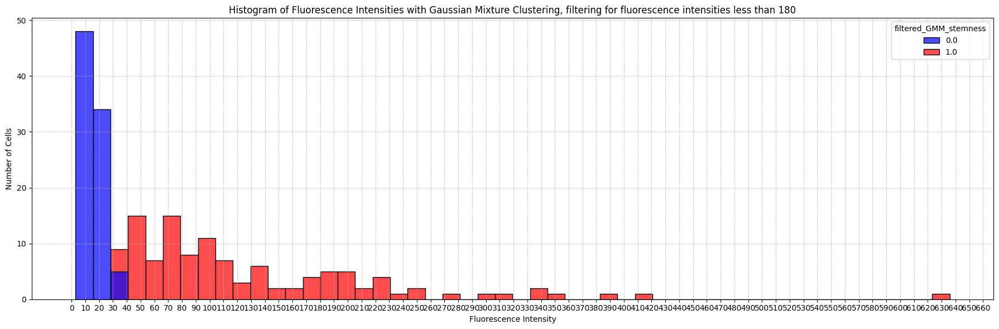

In [40]:
plt.figure(figsize=(18, 6))
sns.histplot(df, x='Fluorescence_Intensity', hue='filtered_GMM_stemness', bins=50, palette=['blue', 'red'], element='bars', stat='count', common_norm=False, alpha=0.7)

# Plot customization to resemble the original plot
plt.title('Histogram of Fluorescence Intensities with Gaussian Mixture Clustering, filtering for fluorescence intensities less than 180')
plt.xlabel('Fluorescence Intensity')
plt.ylabel('Number of Cells')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()



# # Save the plot to your computer
# filename = "/content/histogram_GMM-means-filtered-intensity<180_clustering.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)

# # To download the file to your local machine from Colab
# from google.colab import files
# files.download(filename)



plt.show()

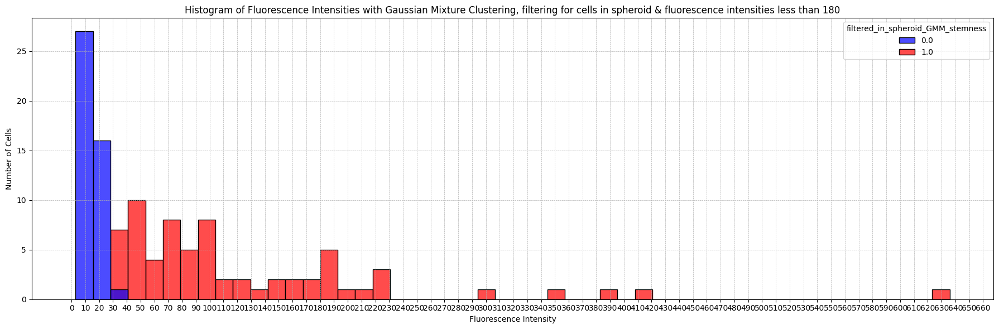

In [41]:
# ========== NEW CLUSTERING EXCLUDING CELLS OUTSIDE THE SPHEROID ==========

plt.figure(figsize=(18, 6))
df_in_spheroid = df.loc[df['in_spheroid']==True].copy()
sns.histplot(df_in_spheroid, x='Fluorescence_Intensity', hue='filtered_in_spheroid_GMM_stemness', bins=50, palette=['blue', 'red'], element='bars', stat='count', common_norm=False, alpha=0.7)

# Plot customization to resemble the original plot
plt.title('Histogram of Fluorescence Intensities with Gaussian Mixture Clustering, filtering for cells in spheroid & fluorescence intensities less than 180')
plt.xlabel('Fluorescence Intensity')
plt.ylabel('Number of Cells')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()



# # Save the plot to your computer
# filename = "/content/histogram_GMM-means-filtered-intensity<180_clustering.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)

# # To download the file to your local machine from Colab
# from google.colab import files
# files.download(filename)



plt.show()

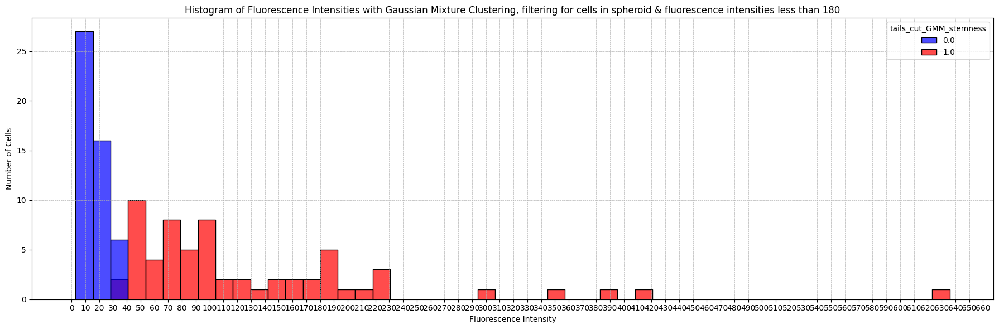

In [42]:
# ========== CUTTING DISTRIBUTION TAILS ==========

plt.figure(figsize=(18, 6))
df_in_spheroid = df.loc[df['in_spheroid']==True].copy()
sns.histplot(df_in_spheroid, x='Fluorescence_Intensity', hue='tails_cut_GMM_stemness', bins=50, palette=['blue', 'red'], element='bars', stat='count', common_norm=False, alpha=0.7)

# Plot customization to resemble the original plot
plt.title('Histogram of Fluorescence Intensities with Gaussian Mixture Clustering, filtering for cells in spheroid & fluorescence intensities less than 180')
plt.xlabel('Fluorescence Intensity')
plt.ylabel('Number of Cells')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()



# # Save the plot to your computer
# filename = "/content/histogram_GMM-means-filtered-intensity<180_clustering.png"  # Path to save the plot in Colab's virtual environment
# plt.savefig(filename)

# # To download the file to your local machine from Colab
# from google.colab import files
# files.download(filename)



plt.show()

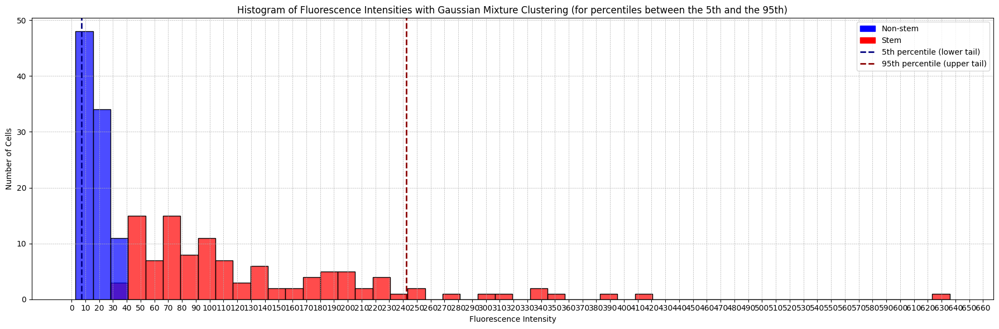

In [43]:
# ========== CUTTING DISTRIBUTION TAILS: TAILS INDICATED ==========

plt.figure(figsize=(18, 6))

# In this case, we do NOT filter for cells in the spheroid, so we use the original df
df_in_spheroid = df

# Main histogram plot for 'tails_cut_GMM_stemness'
sns.histplot(df_in_spheroid, x='Fluorescence_Intensity', hue='tails_cut_GMM_stemness', bins=50, palette=['blue', 'red'], element='bars', stat='count', common_norm=False, alpha=0.7)

# Calculate the 5th and 95th percentile values
lower_threshold = df_in_spheroid['Fluorescence_Intensity'].quantile(0.05)
upper_threshold = df_in_spheroid['Fluorescence_Intensity'].quantile(0.95)

# Plotting vertical lines to indicate the 5th and 95th percentile thresholds
lower_tail_line = plt.axvline(x=lower_threshold, color='navy', linestyle='--', linewidth=2)
upper_tail_line = plt.axvline(x=upper_threshold, color='darkred', linestyle='--', linewidth=2)

# Plot customization to resemble the original plot
plt.title('Histogram of Fluorescence Intensities with Gaussian Mixture Clustering (for percentiles between the 5th and the 95th)')
plt.xlabel('Fluorescence Intensity')
plt.ylabel('Number of Cells')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

# Create custom legend
legend_elements = [Patch(facecolor='blue', edgecolor='blue', label='Non-stem'),
                   Patch(facecolor='red', edgecolor='red', label='Stem'),
                   Line2D([0], [0], color='navy', linestyle='--', linewidth=2, label='5th percentile (lower tail)'),
                   Line2D([0], [0], color='darkred', linestyle='--', linewidth=2, label='95th percentile (upper tail)')]

plt.legend(handles=legend_elements)

plt.show()



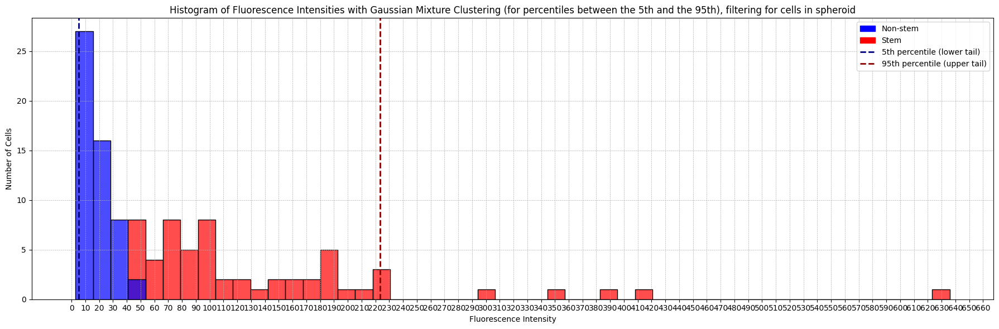

In [44]:
# ========== EXCLUDING CELLS OUTSIDE THE SPHEROID AND CUTTING DISTRIBUTION TAILS ==========


plt.figure(figsize=(18, 6))

# Create a dataframe for cells in the spheroid
df_in_spheroid = df.loc[df['in_spheroid'] == True].copy()

# Main histogram plot for 'tails_cut_GMM_stemness'
sns.histplot(df_in_spheroid, x='Fluorescence_Intensity', hue='tails_cut_in_spheroid_GMM_stemness', bins=50, palette=['blue', 'red'], element='bars', stat='count', common_norm=False, alpha=0.7)

# Calculate the 5th and 95th percentile values
lower_threshold = df_in_spheroid['Fluorescence_Intensity'].quantile(0.05)
upper_threshold = df_in_spheroid['Fluorescence_Intensity'].quantile(0.95)

# Plotting vertical lines to indicate the 5th and 95th percentile thresholds
lower_tail_line = plt.axvline(x=lower_threshold, color='navy', linestyle='--', linewidth=2)
upper_tail_line = plt.axvline(x=upper_threshold, color='darkred', linestyle='--', linewidth=2)

# Plot customization to resemble the original plot
plt.title('Histogram of Fluorescence Intensities with Gaussian Mixture Clustering (for percentiles between the 5th and the 95th), filtering for cells in spheroid')
plt.xlabel('Fluorescence Intensity')
plt.ylabel('Number of Cells')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

# Create custom legend
legend_elements = [Patch(facecolor='blue', edgecolor='blue', label='Non-stem'),
                   Patch(facecolor='red', edgecolor='red', label='Stem'),
                   Line2D([0], [0], color='navy', linestyle='--', linewidth=2, label='5th percentile (lower tail)'),
                   Line2D([0], [0], color='darkred', linestyle='--', linewidth=2, label='95th percentile (upper tail)')]

plt.legend(handles=legend_elements)

plt.show()


Notar como la línea del percentil 5 se mueve a la derecha. Esto tiene que ver con que excluir células fuera del esferoide, es excluir las sueltas y algunas del borde. Las del borde suelen tener mucha limpieza de SOX2 a su alrededor, por lo que pueden ser altas o bajas según la teselación de ese caso particular. Las que están lejos del esferoide (sueltas), pueden tener mucho SOX2 porque la limpieza no las afecta tanto, pero en general involucran áreas que casi no tienen SOX2 en primer lugar. Como resultado, si bien pueden haber excepciones por los motivos mencionados, excluir células fuera del esferoide puede ya estarme excluyendo fluorescencias bajas (lo que mueve la línea del percentil 5 a la derecha).

In [45]:
# Save the DataFrame to a CSV

# Define the directory path
directory = f"./results/sph4_reprocessed/" # slice_{z_slice}/
csv_file_path = os.path.join(directory, f"sph4_slice_{z_slice}_artificial_boundary.csv")

# # Save the DataFrame to a CSV in the specified directory
# df.to_csv(csv_file_path, index=False)


## Plots

### Criterion: `filtered_GMM_stemness`

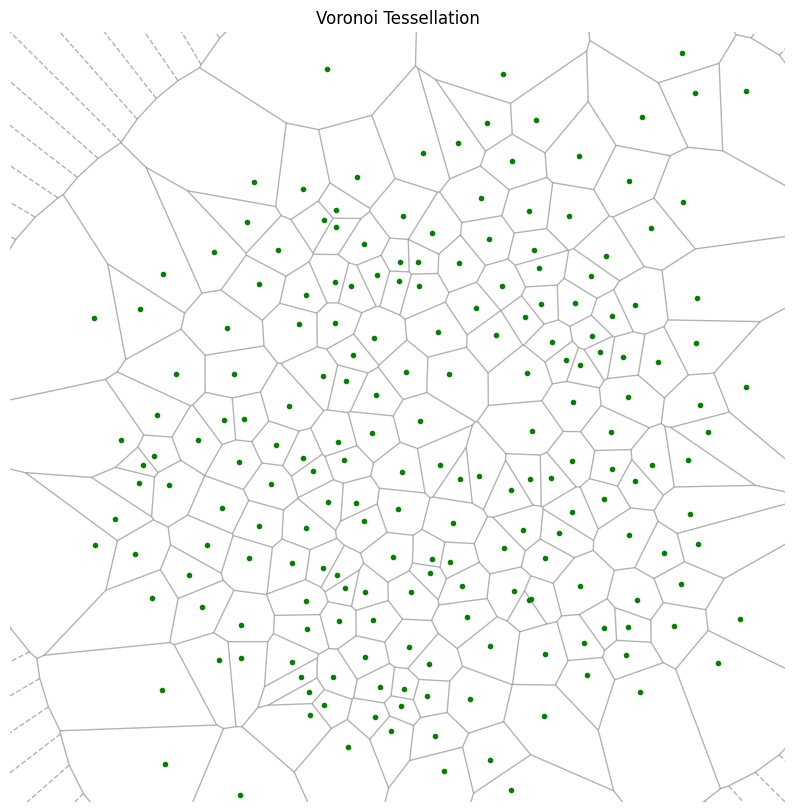

In [46]:
# ========== CRITERION: filtered_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'filtered_GMM_stemness'] # tails_cut_in_spheroid_GMM_stemness filtered_GMM_stemness
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# # Display the colored Voronoi overlay
# ax.imshow(voronoi_overlay, alpha=0.8)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

# ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation')
plt.axis('off')

plt.show()

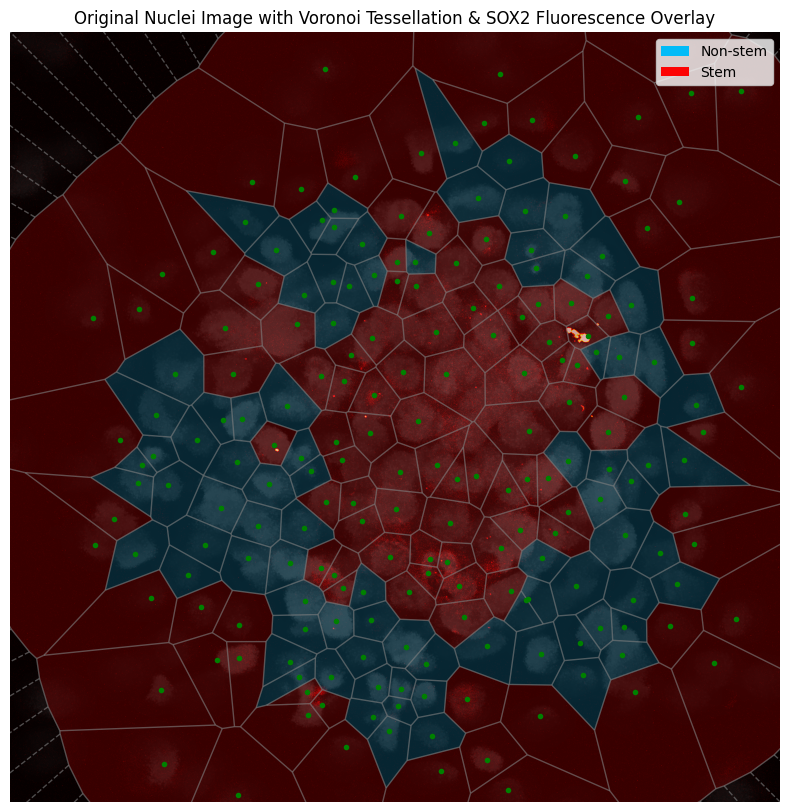

In [47]:
# ========== CRITERION: filtered_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'filtered_GMM_stemness'] # tails_cut_in_spheroid_GMM_stemness filtered_GMM_stemness
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.5)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

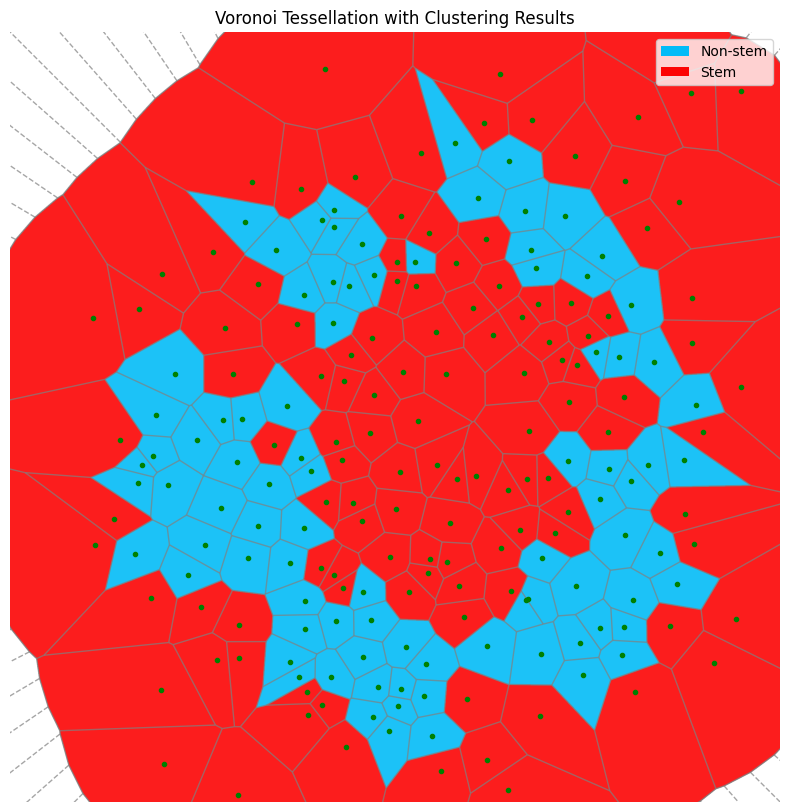

In [48]:
# ========== CRITERION: filtered_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'filtered_GMM_stemness'] # tails_cut_in_spheroid_GMM_stemness filtered_GMM_stemness
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.9)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.7)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation with Clustering Results')
plt.axis('off')

plt.show()

### Criterion: `filtered_in_spheroid_GMM_stemness`

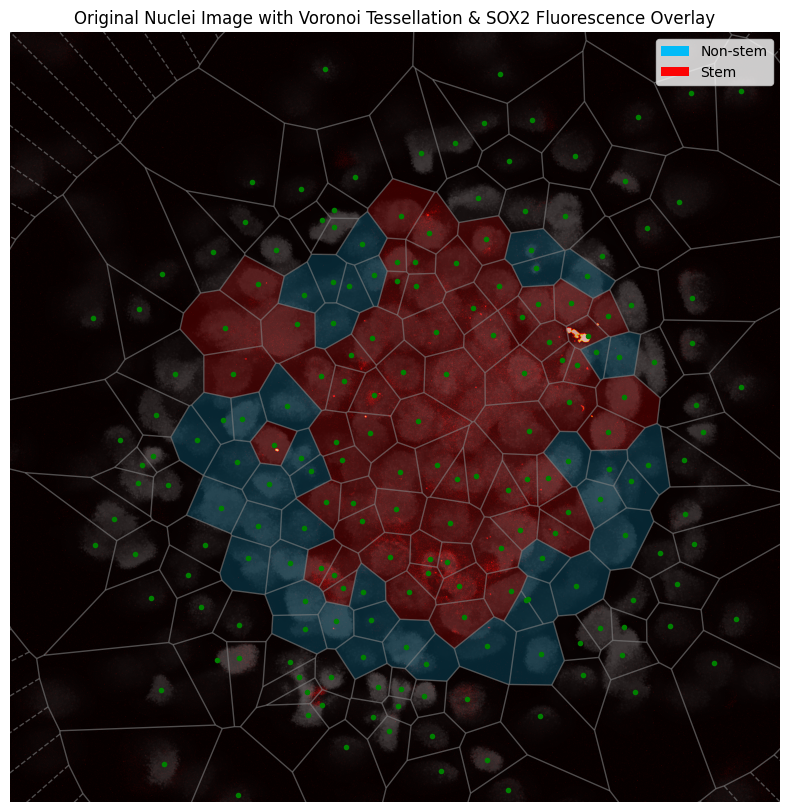

In [49]:
# ========== CRITERION: filtered_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'filtered_in_spheroid_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.5)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

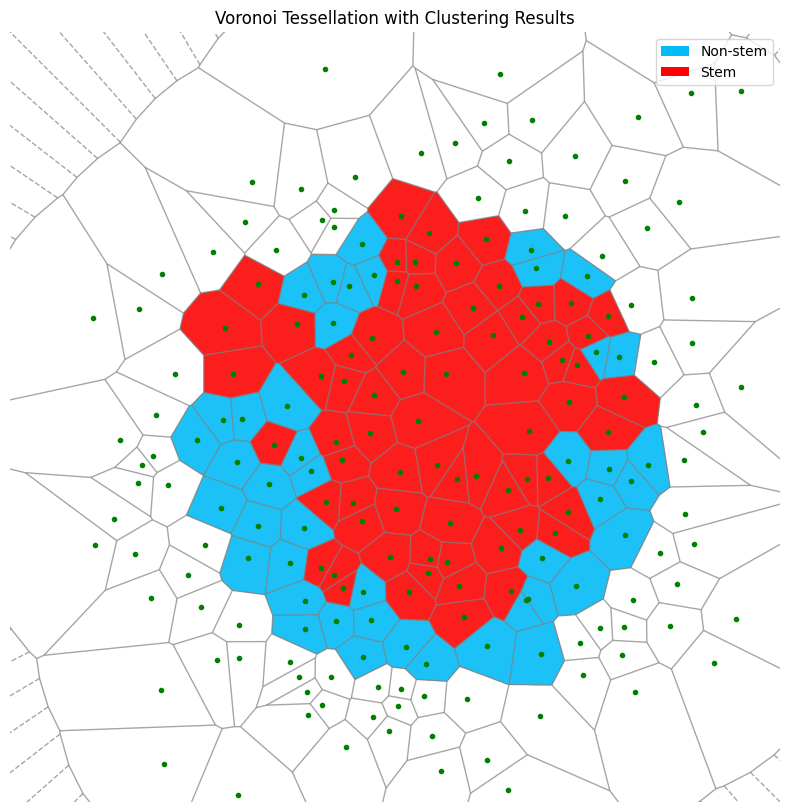

In [50]:
# ========== CRITERION: filtered_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'filtered_in_spheroid_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.9)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.7)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation with Clustering Results')
plt.axis('off')

plt.show()

### Criterion: `tails_cut_GMM_stemness`

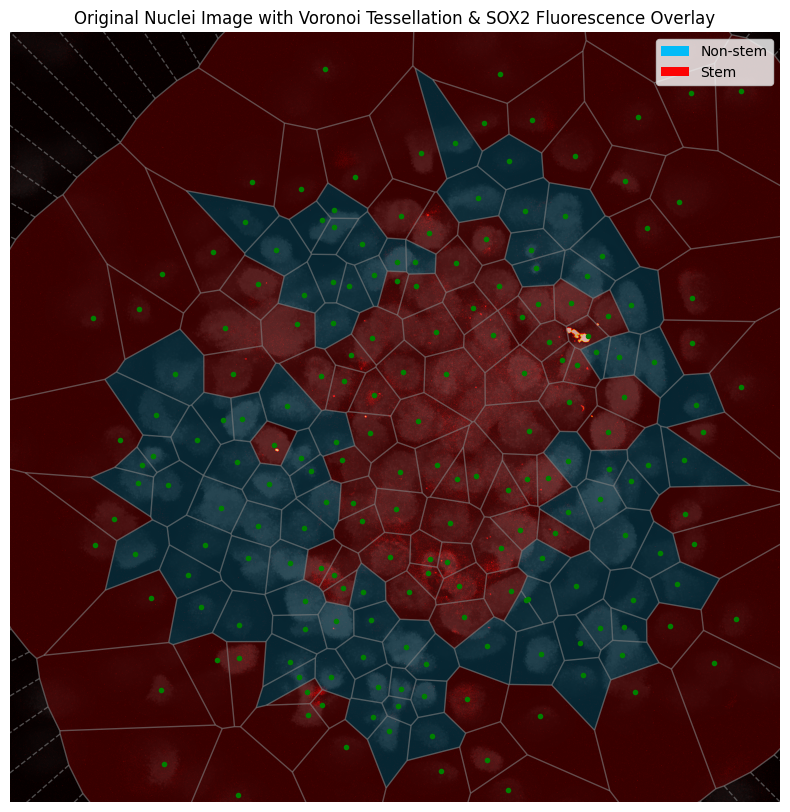

In [51]:
# ========== CRITERION: tails_cut_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.5)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

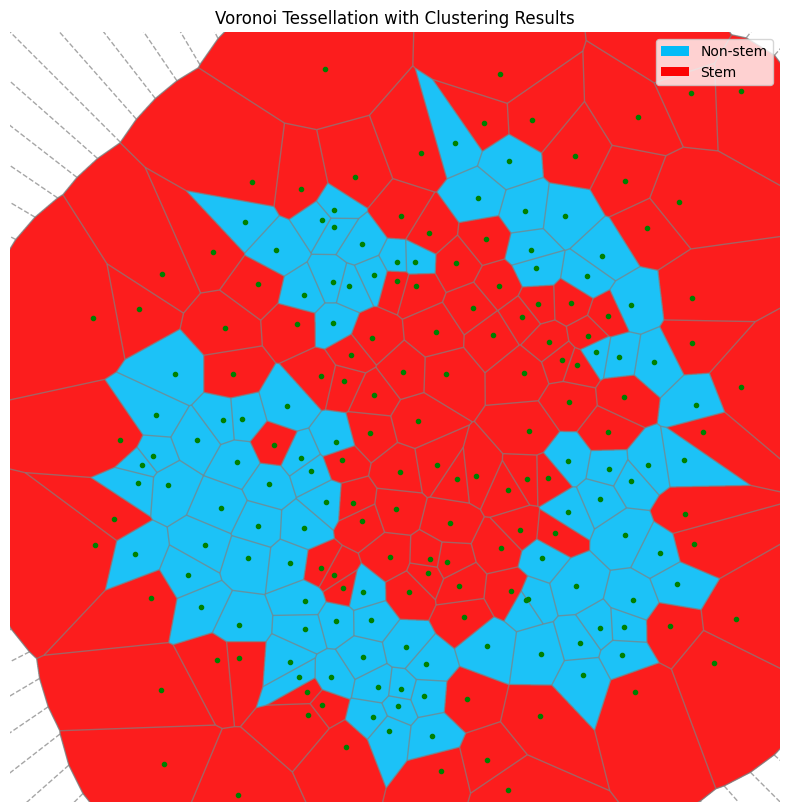

In [52]:
# ========== CRITERION: tails_cut_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.9)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.7)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation with Clustering Results')
plt.axis('off')

plt.show()

### Criterion: `tails_cut_in_spheroid_GMM_stemness`

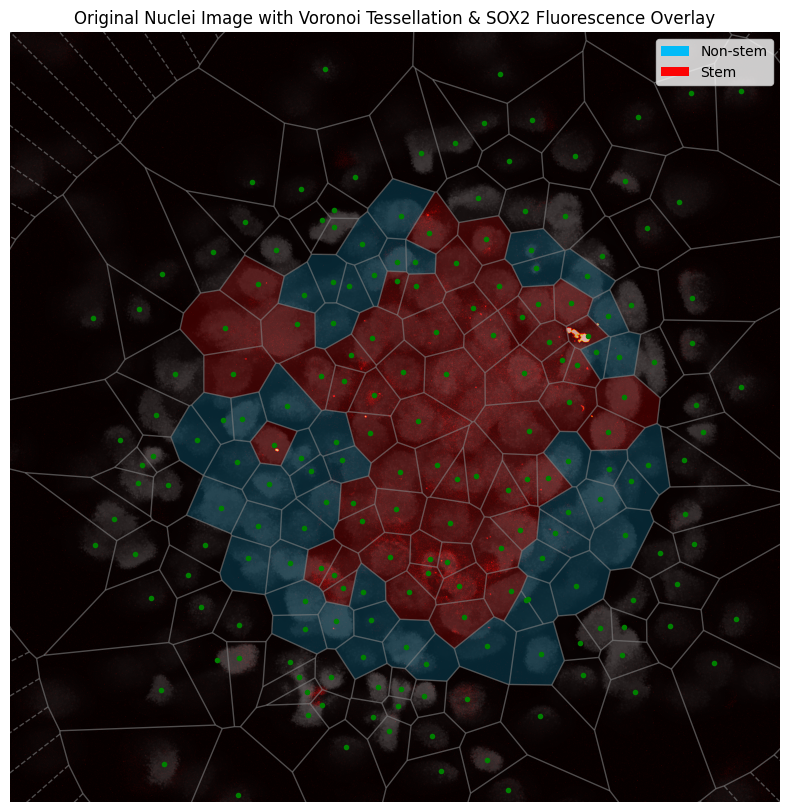

In [53]:
# ========== CRITERION: tails_cut_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_in_spheroid_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.5)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

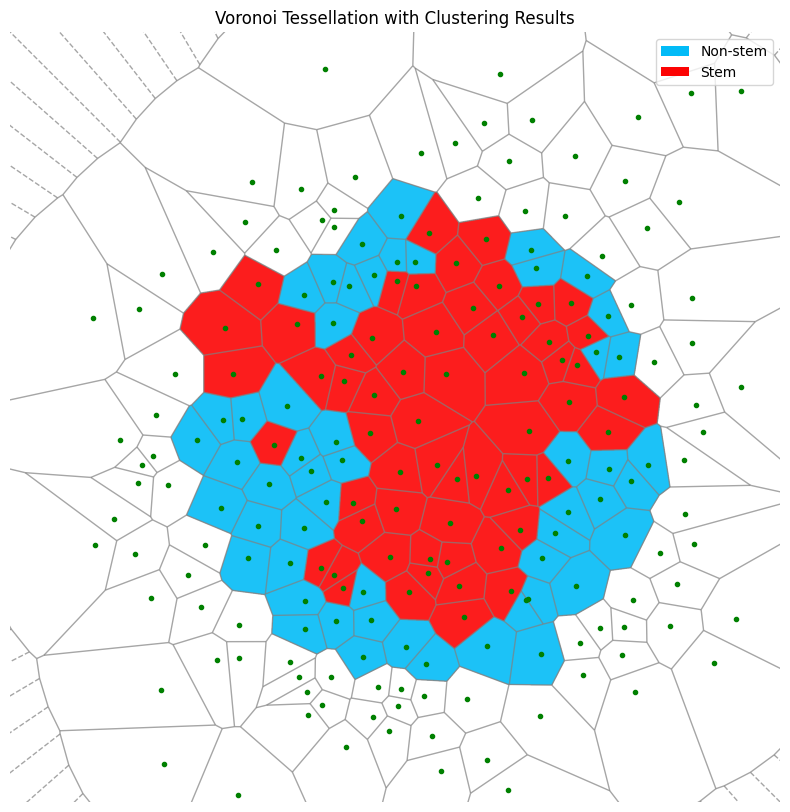

In [54]:
# ========== CRITERION: tails_cut_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids):  # Ensure we only color the original points
        polygon = [vor.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame
        original_idx = df.iloc[point_idx].name
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_in_spheroid_GMM_stemness'] # CRITERON HERE
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.9)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.7)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation with Clustering Results')
plt.axis('off')

plt.show()

Repetimos lo anterior, pero graficando el `vor_in_sph` (i.e., graficamos el Voronoi sin los puntos con `in_spheroid=False`).

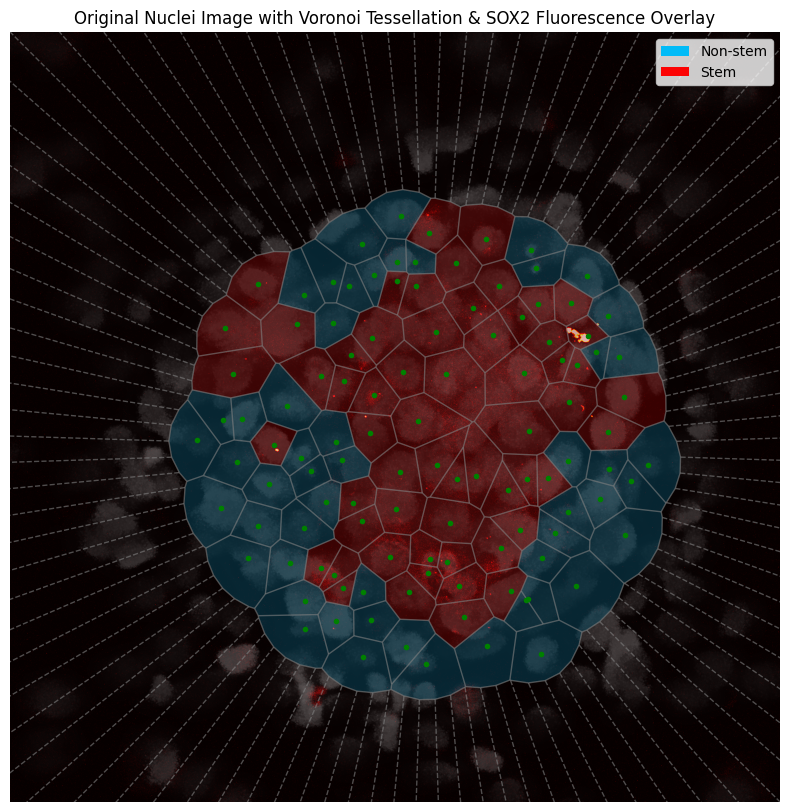

In [55]:
# ========== CRITERION: tails_cut_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Create a mapping from the 'in_spheroid' centroids to their original DataFrame index
in_spheroid_indices = df[df['in_spheroid'] == True].index

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor_in_sph.point_region):
    region = vor_in_sph.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids_in_sph):  # Ensure we only color the original points
        polygon = [vor_in_sph.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame using the mapping
        original_idx = in_spheroid_indices[point_idx]
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_in_spheroid_GMM_stemness']
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple


# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.5)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor_in_sph, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.6)

# Overlay the fluorescence channel using a colormap.
ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids_in_sph:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Original Nuclei Image with Voronoi Tessellation & SOX2 Fluorescence Overlay')
plt.axis('off')

plt.show()

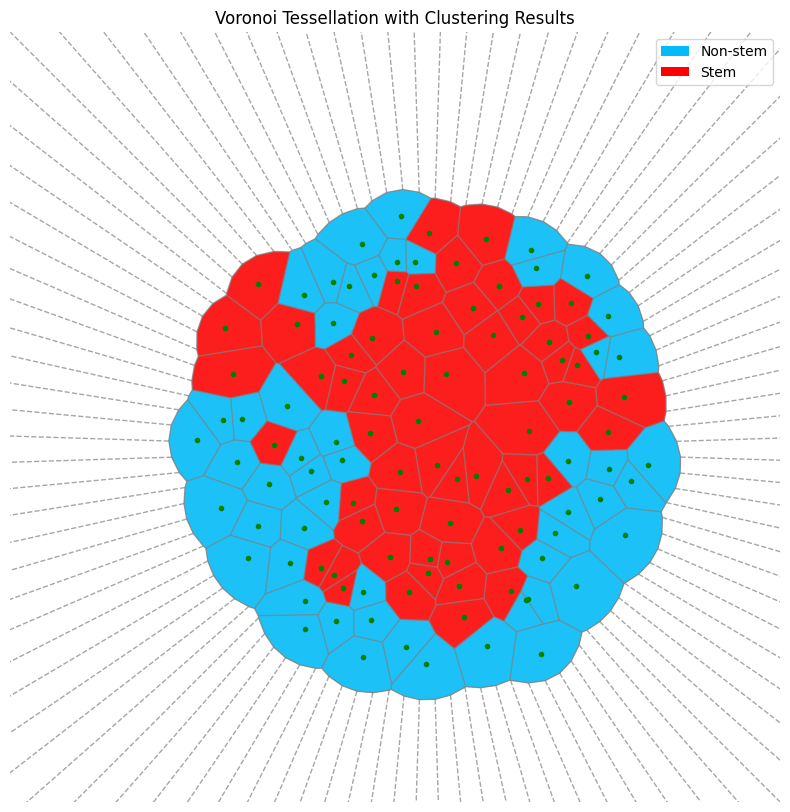

In [56]:
# ========== CRITERION: tails_cut_in_spheroid_GMM_stemness ==========


# Define a soft, pastel colormap
pastel_cmap = ListedColormap(['#02bbf7', '#fc0303'])  # light blue and light red

# Start the plot and display the original image
fig, ax = plt.subplots(figsize=(10, 10))
# ax.imshow(image_opened_bilateral, cmap='gray')

# Create an empty image to overlay the Voronoi regions
voronoi_overlay = np.zeros(image_opened_bilateral.shape + (4,), dtype=np.uint8)  # 4 for RGBA

# ---

# # Center of spheroid
# ax.plot(*center_of_spheroid[::1], color='orange', marker='x')

# # Coloring Circle
# circle = Circle(center_of_spheroid[::1], large_circle_radius, fill=False, color='green', linestyle='--', label='Artificial Boundary')
# ax.add_patch(circle)

# # Max distance circle
# circle = Circle(center_of_spheroid[::1], total_spheroid_radius, fill=False, color='orange', linestyle='--', label='Max Distance Circle')
# ax.add_patch(circle)

# # in_spheroid Circle
# circle = Circle(center_of_spheroid[::1], alpha * total_spheroid_radius, fill=False, color='pink', linestyle='--', label='in_spheroid Circle')
# ax.add_patch(circle)

# ---

# Create a mapping from the 'in_spheroid' centroids to their original DataFrame index
in_spheroid_indices = df[df['in_spheroid'] == True].index

# Fill the Voronoi regions with color based on 'tails_cut_in_spheroid_GMM_stemness'
for point_idx, region_idx in enumerate(vor_in_sph.point_region):
    region = vor_in_sph.regions[region_idx]
    if not -1 in region and len(region) > 0 and point_idx < len(centroids_in_sph):  # Ensure we only color the original points
        polygon = [vor_in_sph.vertices[i] for i in region]
        rr, cc = skimage.draw.polygon([p[1] for p in polygon], [p[0] for p in polygon], image_opened_bilateral.shape)
        
        # Get the corresponding index in the original DataFrame using the mapping
        original_idx = in_spheroid_indices[point_idx]
        
        # Get the color based on 'tails_cut_in_spheroid_GMM_stemness'
        stemness_value = df.at[original_idx, 'tails_cut_in_spheroid_GMM_stemness']
        
        # Check if stemness_value is not NaN before setting the color
        if not np.isnan(stemness_value):
            color = pastel_cmap(stemness_value)
            voronoi_overlay[rr, cc] = np.array(color)*255  # Assuming 'color' is an RGBA tuple

# Display the colored Voronoi overlay
ax.imshow(voronoi_overlay, alpha=0.9)  # Adjust alpha for desired transparency

# Overlay the Voronoi diagram without the points, with yellow lines for boundaries
voronoi_plot_2d(vor_in_sph, ax=ax, show_points=False, show_vertices=False, line_colors='gray', line_width=1, line_alpha=0.7)

# # Overlay the fluorescence channel using a colormap.
# ax.imshow(hdome[z_slice], cmap='hot', alpha=0.6)  # Adjust alpha for desired transparency of overlay

# Display the centroids
for (r, c) in centroids_in_sph:
    ax.plot(r, c, 'g.')  # green dot for each centroid

# Legend for the Voronoi region colors
legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
                 Patch(facecolor=pastel_cmap(1), label='Stem')]

# # Let's include the legend for the circles
# legend_labels = [Patch(facecolor=pastel_cmap(0), label='Non-stem'), 
#                  Patch(facecolor=pastel_cmap(1), label='Stem'),
#                  Line2D([0], [0], color='green', linestyle='--', label='Artificial Boundary'),
#                  Line2D([0], [0], color='orange', linestyle='--', label='Max Distance Circle'),
#                  Line2D([0], [0], color='pink', linestyle='--', label='in_spheroid Circle')]

ax.legend(handles=legend_labels, loc='upper right')

ax.set_xlim([0, image_opened_bilateral.shape[1]])
ax.set_ylim([image_opened_bilateral.shape[0], 0])
ax.set_title('Voronoi Tessellation with Clustering Results')
plt.axis('off')

plt.show()

## Random State Statistics
### Criterion: `tails_cut_GMM_stemness`
The clustering appears to vary significantly depending on the seed (`random_state`). Let's take a criterion and do the clustering for several different seeds. For this test, I'll use the `tails_cut_GMM_stemness` criterion. I do not use the `tails_cut_in_spheroid_GMM_stemness` criterion because in this case, every cell outside the spheroid gets classified as a non-stem cell.

In [57]:
# Let's check the stemness of the ones outside the spheroid
df.loc[df['in_spheroid'] == False, ['label', 'tails_cut_in_spheroid_GMM_stemness', 'tails_cut_GMM_stemness', 'filtered_in_spheroid_GMM_stemness', 'filtered_GMM_stemness']]

,label,tails_cut_in_spheroid_GMM_stemness,tails_cut_GMM_stemness,filtered_in_spheroid_GMM_stemness,filtered_GMM_stemness
0,1,NaN,1.0,NaN,1.0
1,2,NaN,1.0,NaN,1.0
3,4,NaN,0.0,NaN,0.0
4,5,NaN,1.0,NaN,1.0
6,7,NaN,0.0,NaN,0.0
...,...,...,...,...,...
188,189,NaN,1.0,NaN,1.0
194,195,NaN,0.0,NaN,0.0
196,197,NaN,1.0,NaN,1.0
201,202,NaN,0.0,NaN,0.0


In [58]:
# ========== MANY SEEDS FOR GMM CLUSTERING CUTTING DISTRIBUTION TAILS ==========


# Function to calculate thresholds for each feature
def calculate_thresholds(sorted_df, feature):
    max_intensity_class_0 = sorted_df[sorted_df[feature] == 0]['Fluorescence_Intensity'].max()
    min_intensity_class_1 = sorted_df[sorted_df[feature] == 1]['Fluorescence_Intensity'].min()
    return (max_intensity_class_0 + min_intensity_class_1) / 2.0

# Prepare the DataFrame to store the results
results_df = pd.DataFrame(columns=['algorithm', 'random_state', 'num_stem_cells', 'num_non_stem_cells', 'stem_fraction', 'FI_threshold'])

# Generate a large batch of random numbers for seeds
random_states = np.random.randint(0, 1000, size=100)  # 100 different seeds

for random_state in random_states:
    # Start with a fresh copy of the Fluorescence_Intensity data
    current_df = df[['Fluorescence_Intensity', 'in_spheroid']].copy()
    
    # Calculate the 5th and 95th percentile values of Fluorescence_Intensity
    lower_threshold = current_df['Fluorescence_Intensity'].quantile(0.05)
    upper_threshold = current_df['Fluorescence_Intensity'].quantile(0.95)

    # Initialize the 'tails_cut_GMM_stemness' column with NaN
    current_df['tails_cut_GMM_stemness'] = np.nan

    # Assign 0 to the 5% lowest intensity regions (non-stem)
    current_df.loc[current_df['Fluorescence_Intensity'] <= lower_threshold, 'tails_cut_GMM_stemness'] = 0

    # Assign 1 to the 95% highest intensity regions (stem)
    current_df.loc[current_df['Fluorescence_Intensity'] >= upper_threshold, 'tails_cut_GMM_stemness'] = 1

    # Filter the dataframe for the regions to be included in GMM clustering
    filtered_df = current_df[(current_df['Fluorescence_Intensity'] > lower_threshold) & (current_df['Fluorescence_Intensity'] < upper_threshold)].copy()

    # Reshape the Fluorescence_Intensity data for clustering
    X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

    # Perform GMM clustering with the current random state
    gmm = GaussianMixture(n_components=2, random_state=random_state)
    gmm.fit(X)
    labels = gmm.predict(X)

    # Compute the mean fluorescence intensity for each cluster
    cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

    # Identify the labels of the clusters with higher and lower mean intensities
    label_higher_intensity = cluster_means.argmax()
    label_lower_intensity = cluster_means.argmin()

    # Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
    labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
    labels[labels == label_lower_intensity] = 0
    labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

    # Assign the corrected labels to the filtered dataframe
    filtered_df.loc[:, 'tails_cut_GMM_stemness'] = labels

    # Update the original dataframe with the GMM clustering results
    current_df.update(filtered_df['tails_cut_GMM_stemness'])

    # Calculate summary statistics
    num_stem_cells = current_df['tails_cut_GMM_stemness'].sum()
    num_non_stem_cells = current_df['tails_cut_GMM_stemness'].count() - num_stem_cells
    stem_fraction = num_stem_cells / current_df['tails_cut_GMM_stemness'].count() * 100
    FI_threshold = calculate_thresholds(current_df, 'tails_cut_GMM_stemness')

    # Store the results
    temp_df = pd.DataFrame({'algorithm': ['GMM'],
                            'random_state': [random_state],
                            'num_stem_cells': [num_stem_cells],
                            'num_non_stem_cells': [num_non_stem_cells],
                            'stem_fraction': [stem_fraction],
                            'FI_threshold': [FI_threshold]})
    results_df = pd.concat([results_df, temp_df], ignore_index=True)

# Display or save the results
results_df
# results_df.to_csv('gmm_clustering_variability.csv', index=False)



3500701756.py (75): The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.


,algorithm,random_state,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
0,GMM,286,111.0,93.0,54.411765,37.892996
1,GMM,411,111.0,93.0,54.411765,37.892996
2,GMM,61,111.0,93.0,54.411765,37.892996
3,GMM,281,111.0,93.0,54.411765,37.892996
4,GMM,71,111.0,93.0,54.411765,37.892996
...,...,...,...,...,...,...
95,GMM,686,111.0,93.0,54.411765,37.892996
96,GMM,352,111.0,93.0,54.411765,37.892996
97,GMM,426,111.0,93.0,54.411765,37.892996
98,GMM,94,111.0,93.0,54.411765,37.892996


In [59]:
results_df.describe()

,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
count,100.0,100.0,1.000000e+02,1.000000e+02
mean,111.0,93.0,5.441176e+01,3.789300e+01
std,0.0,0.0,3.570612e-14,7.141223e-15
min,111.0,93.0,5.441176e+01,3.789300e+01
25%,111.0,93.0,5.441176e+01,3.789300e+01
50%,111.0,93.0,5.441176e+01,3.789300e+01
75%,111.0,93.0,5.441176e+01,3.789300e+01
max,111.0,93.0,5.441176e+01,3.789300e+01


In [60]:
results_df['FI_threshold'].value_counts()

FI_threshold
37.892996    100
Name: count, dtype: int64

En general, se concentran en los dos mismo valores (71 y 75), y pocas veces se queda al medio. Creo que esto tiene que ver con si la gaussiana mayor se inicializa a la izquierda o a la derecha.

---

Tendríamos que probar qué pasa con otros criterios y tratar de incluirlos en la estadística. Podríamos cambiar los percentiles que cortamos en las colas o el algoritmo (además de los otros 3 criterios que usamos antes).

In [61]:
# ========== MANY SEEDS FOR K-MEANS CLUSTERING CUTTING DISTRIBUTION TAILS ==========

# Generate a large batch of random numbers for seeds
random_states = np.random.randint(0, 1000, size=100)  # 100 different seeds

for random_state in random_states:
    # Start with a fresh copy of the Fluorescence_Intensity data
    current_df = df[['Fluorescence_Intensity', 'in_spheroid']].copy()
    
    # Calculate the 5th and 95th percentile values of Fluorescence_Intensity
    lower_threshold = current_df['Fluorescence_Intensity'].quantile(0.05)
    upper_threshold = current_df['Fluorescence_Intensity'].quantile(0.95)

    # Initialize the 'tails_cut_kmeans_stemness' column with NaN
    current_df['tails_cut_kmeans_stemness'] = np.nan

    # Assign 0 to the 5% lowest intensity regions (non-stem)
    current_df.loc[current_df['Fluorescence_Intensity'] <= lower_threshold, 'tails_cut_kmeans_stemness'] = 0

    # Assign 1 to the 95% highest intensity regions (stem)
    current_df.loc[current_df['Fluorescence_Intensity'] >= upper_threshold, 'tails_cut_kmeans_stemness'] = 1

    # Filter the dataframe for the regions to be included in clustering
    filtered_df = current_df[(current_df['Fluorescence_Intensity'] > lower_threshold) & (current_df['Fluorescence_Intensity'] < upper_threshold)].copy()

    # Reshape the Fluorescence_Intensity data for clustering
    X = filtered_df['Fluorescence_Intensity'].values.reshape(-1, 1)

    # Perform k-means clustering with the current random state
    kmeans = KMeans(n_clusters=2, n_init=20 , random_state=random_state)
    kmeans.fit(X)
    labels = kmeans.predict(X)

    # Compute the mean fluorescence intensity for each cluster
    cluster_means = np.array([filtered_df['Fluorescence_Intensity'][labels == i].mean() for i in np.unique(labels)])

    # Identify the labels of the clusters with higher and lower mean intensities
    label_higher_intensity = cluster_means.argmax()
    label_lower_intensity = cluster_means.argmin()

    # Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
    labels[labels == label_higher_intensity] = 2  # Use 2 as a temporary label to avoid confusion during replacement
    labels[labels == label_lower_intensity] = 0
    labels[labels == 2] = 1  # Finally replace temporary label 2 with 1

    # Assign the corrected labels to the filtered dataframe
    filtered_df.loc[:, 'tails_cut_kmeans_stemness'] = labels

    # Update the original dataframe with the clustering results
    current_df.update(filtered_df['tails_cut_kmeans_stemness'])

    # Calculate summary statistics
    num_stem_cells = current_df['tails_cut_kmeans_stemness'].sum()
    num_non_stem_cells = current_df['tails_cut_kmeans_stemness'].count() - num_stem_cells
    stem_fraction = num_stem_cells / current_df['tails_cut_kmeans_stemness'].count() * 100
    FI_threshold = calculate_thresholds(current_df, 'tails_cut_kmeans_stemness')

    # Store the results
    temp_df = pd.DataFrame({'algorithm': ['k-means'],
                            'random_state': [random_state],
                            'num_stem_cells': [num_stem_cells],
                            'num_non_stem_cells': [num_non_stem_cells],
                            'stem_fraction': [stem_fraction],
                            'FI_threshold': [FI_threshold]})
    results_df = pd.concat([results_df, temp_df], ignore_index=True)
    
# Display or save the results
results_df
# results_df.to_csv('clustering_variability.csv', index=False)


,algorithm,random_state,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
0,GMM,286,111.0,93.0,54.411765,37.892996
1,GMM,411,111.0,93.0,54.411765,37.892996
2,GMM,61,111.0,93.0,54.411765,37.892996
3,GMM,281,111.0,93.0,54.411765,37.892996
4,GMM,71,111.0,93.0,54.411765,37.892996
...,...,...,...,...,...,...
195,k-means,681,61.0,143.0,29.901961,93.841100
196,k-means,311,61.0,143.0,29.901961,93.841100
197,k-means,798,60.0,144.0,29.411765,95.022015
198,k-means,381,61.0,143.0,29.901961,93.841100


In [62]:
results_df.describe()

,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
count,200.000000,200.000000,200.000000,200.000000
mean,85.880000,118.120000,42.098039,66.008758
std,25.184856,25.184856,12.345518,28.188583
min,60.000000,93.000000,29.411765,37.892996
25%,61.000000,93.000000,29.901961,37.892996
50%,86.000000,118.000000,42.156863,65.867048
75%,111.000000,143.000000,54.411765,93.841100
max,111.000000,144.000000,54.411765,95.022015


In [63]:
results_df['FI_threshold'].value_counts()

FI_threshold
37.892996    100
93.841100     76
95.022015     24
Name: count, dtype: int64

In [64]:
# Let's filtere by k-means
kmeans_df = results_df[results_df['algorithm'] == 'k-means']
kmeans_df.describe()

,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
count,100.000000,100.000000,100.000000,100.000000
mean,60.760000,143.240000,29.784314,94.124520
std,0.429235,0.429235,0.210409,0.506890
min,60.000000,143.000000,29.411765,93.841100
25%,61.000000,143.000000,29.901961,93.841100
50%,61.000000,143.000000,29.901961,93.841100
75%,61.000000,143.000000,29.901961,93.841100
max,61.000000,144.000000,29.901961,95.022015


In [65]:
kmeans_df['FI_threshold'].value_counts()

FI_threshold
93.841100    76
95.022015    24
Name: count, dtype: int64

K-means da un umbral un poco más bajo, pero bastante parecido (sólo suma 7 células madre aproximadamente).

In [114]:
# Save the DataFrame to a CSV

# Define the directory path
directory = f"./results/sph1_reprocessed/slice_{z_slice}/"
csv_file_path = os.path.join(directory, f"clustering_analysis_sph1_slice_{z_slice}.csv")

# # Save the DataFrame to a CSV in the specified directory
# df.to_csv(csv_file_path, index=False)

### Criterion: `tails_cut_in_spheroid_GMM_stemness`
Since we're adopting this criterion, I should do it with this for consistency.

#### GMM

In [66]:
# ========== MANY SEEDS FOR GMM CLUSTERING CUTTING DISTRIBUTION TAILS ==========


# Function to calculate thresholds for each feature
def calculate_thresholds(sorted_df, feature):
    max_intensity_class_0 = sorted_df[sorted_df[feature] == 0]['Fluorescence_Intensity'].max()
    min_intensity_class_1 = sorted_df[sorted_df[feature] == 1]['Fluorescence_Intensity'].min()
    return (max_intensity_class_0 + min_intensity_class_1) / 2.0

# List to store the results
results_list_in_spheroid_GMM = []

# Generate a large batch of random numbers for seeds
random_states_in_spheroid = np.random.randint(0, 1000, size=100)  # 100 different seeds

for random_state in random_states_in_spheroid:
    # Filter the dataframe for in_spheroid cells and copy their Fluorescence_Intensity
    in_spheroid_df = df[df['in_spheroid'] == True][['Fluorescence_Intensity']].copy()
    
    # Calculate the 5th and 95th percentile values of Fluorescence_Intensity within the spheroid
    lower_threshold_in_spheroid = in_spheroid_df['Fluorescence_Intensity'].quantile(0.05)
    upper_threshold_in_spheroid = in_spheroid_df['Fluorescence_Intensity'].quantile(0.95)

    # Initialize the 'tails_cut_in_spheroid_GMM_stemness' column with NaN
    in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'] = np.nan

    # Assign 0 to the 5% lowest intensity regions within the spheroid (non-stem)
    in_spheroid_df.loc[in_spheroid_df['Fluorescence_Intensity'] <= lower_threshold_in_spheroid, 'tails_cut_in_spheroid_GMM_stemness'] = 0

    # Assign 1 to the 95% highest intensity regions within the spheroid (stem)
    in_spheroid_df.loc[in_spheroid_df['Fluorescence_Intensity'] >= upper_threshold_in_spheroid, 'tails_cut_in_spheroid_GMM_stemness'] = 1

    # Filter the dataframe for the regions to be included in GMM clustering
    filtered_in_spheroid_df = in_spheroid_df[(in_spheroid_df['Fluorescence_Intensity'] > lower_threshold_in_spheroid) & 
                                             (in_spheroid_df['Fluorescence_Intensity'] < upper_threshold_in_spheroid)].copy()

    # Reshape the Fluorescence_Intensity data for clustering
    X_in_spheroid = filtered_in_spheroid_df['Fluorescence_Intensity'].values.reshape(-1, 1)

    # Perform GMM clustering with the current random state
    gmm_in_spheroid = GaussianMixture(n_components=2, random_state=random_state)
    gmm_in_spheroid.fit(X_in_spheroid)
    labels_in_spheroid = gmm_in_spheroid.predict(X_in_spheroid)

    # Compute the mean fluorescence intensity for each cluster
    cluster_means_in_spheroid = np.array([filtered_in_spheroid_df['Fluorescence_Intensity'][labels_in_spheroid == i].mean() for i in np.unique(labels_in_spheroid)])

    # Identify the labels of the clusters with higher and lower mean intensities
    label_higher_intensity_in_spheroid = cluster_means_in_spheroid.argmax()
    label_lower_intensity_in_spheroid = cluster_means_in_spheroid.argmin()

    # Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
    labels_in_spheroid[labels_in_spheroid == label_higher_intensity_in_spheroid] = 2  # Use 2 as a temporary label to avoid confusion during replacement
    labels_in_spheroid[labels_in_spheroid == label_lower_intensity_in_spheroid] = 0
    labels_in_spheroid[labels_in_spheroid == 2] = 1  # Finally replace temporary label 2 with 1

    # Assign the corrected labels to the filtered dataframe
    filtered_in_spheroid_df.loc[:, 'tails_cut_in_spheroid_GMM_stemness'] = labels_in_spheroid

    # Update the original dataframe with the GMM clustering results for in_spheroid cells
    in_spheroid_df.update(filtered_in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'])

    # Calculate summary statistics for in_spheroid cells
    num_stem_cells_in_spheroid = in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'].sum()
    num_non_stem_cells_in_spheroid = in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'].count() - num_stem_cells_in_spheroid
    stem_fraction_in_spheroid = num_stem_cells_in_spheroid / in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'].count() * 100
    FI_threshold_in_spheroid = calculate_thresholds(in_spheroid_df, 'tails_cut_in_spheroid_GMM_stemness')

    # Append the results to the list
    results_list_in_spheroid_GMM.append({
        'algorithm': 'GMM',
        'random_state': random_state,
        'num_stem_cells': num_stem_cells_in_spheroid,
        'num_non_stem_cells': num_non_stem_cells_in_spheroid,
        'stem_fraction': stem_fraction_in_spheroid,
        'FI_threshold': FI_threshold_in_spheroid
    })

# Convert the list of results to a DataFrame
results_df_in_spheroid_GMM = pd.DataFrame(results_list_in_spheroid_GMM)

# Display or save the results
results_df_in_spheroid_GMM



,algorithm,random_state,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
0,GMM,778,26.0,86.0,23.214286,108.367414
1,GMM,249,59.0,53.0,52.678571,43.667666
2,GMM,658,26.0,86.0,23.214286,108.367414
3,GMM,652,26.0,86.0,23.214286,108.367414
4,GMM,598,59.0,53.0,52.678571,43.667666
...,...,...,...,...,...,...
95,GMM,382,59.0,53.0,52.678571,43.667666
96,GMM,427,59.0,53.0,52.678571,43.667666
97,GMM,43,26.0,86.0,23.214286,108.367414
98,GMM,611,26.0,86.0,23.214286,108.367414


In [67]:
results_df_in_spheroid_GMM[['num_stem_cells', 'stem_fraction', 'FI_threshold']].describe()

,num_stem_cells,stem_fraction,FI_threshold
count,100.000000,100.000000,100.000000
mean,41.360000,36.928571,77.722184
std,16.379662,14.624698,31.682676
min,26.000000,23.214286,43.667666
25%,26.000000,23.214286,43.667666
50%,27.000000,24.107143,101.782383
75%,59.000000,52.678571,108.367414
max,59.000000,52.678571,108.367414


In [68]:
results_df_in_spheroid_GMM['FI_threshold'].value_counts()

FI_threshold
43.667666     46
108.367414    42
101.782383    11
92.468116      1
Name: count, dtype: int64

In [69]:
results_df_in_spheroid_GMM['num_stem_cells'].value_counts()

num_stem_cells
59.0    46
26.0    42
27.0    11
33.0     1
Name: count, dtype: int64

Eventualmente se podría realizar un promedio pesado de estos valores para refinar el umbral.

#### K-means

In [70]:
# ========== MANY SEEDS FOR K-MEANS CLUSTERING CUTTING DISTRIBUTION TAILS ==========


# Function to calculate thresholds for each feature
def calculate_thresholds(sorted_df, feature):
    max_intensity_class_0 = sorted_df[sorted_df[feature] == 0]['Fluorescence_Intensity'].max()
    min_intensity_class_1 = sorted_df[sorted_df[feature] == 1]['Fluorescence_Intensity'].min()
    return (max_intensity_class_0 + min_intensity_class_1) / 2.0

# List to store the results
results_list_in_spheroid_kmeans = []

# Generate a large batch of random numbers for seeds
random_states_in_spheroid = np.random.randint(0, 1000, size=100)  # 100 different seeds

for random_state in random_states_in_spheroid:
    # Filter the dataframe for in_spheroid cells and copy their Fluorescence_Intensity
    in_spheroid_df = df[df['in_spheroid'] == True][['Fluorescence_Intensity']].copy()
    
    # Calculate the 5th and 95th percentile values of Fluorescence_Intensity within the spheroid
    lower_threshold_in_spheroid = in_spheroid_df['Fluorescence_Intensity'].quantile(0.05)
    upper_threshold_in_spheroid = in_spheroid_df['Fluorescence_Intensity'].quantile(0.95)

    # Initialize the 'tails_cut_in_spheroid_kmeans_stemness' column with NaN
    in_spheroid_df['tails_cut_in_spheroid_kmeans_stemness'] = np.nan

    # Assign 0 to the 5% lowest intensity regions within the spheroid (non-stem)
    in_spheroid_df.loc[in_spheroid_df['Fluorescence_Intensity'] <= lower_threshold_in_spheroid, 'tails_cut_in_spheroid_kmeans_stemness'] = 0

    # Assign 1 to the 95% highest intensity regions within the spheroid (stem)
    in_spheroid_df.loc[in_spheroid_df['Fluorescence_Intensity'] >= upper_threshold_in_spheroid, 'tails_cut_in_spheroid_kmeans_stemness'] = 1

    # Filter the dataframe for the regions to be included in k-means clustering
    filtered_in_spheroid_df = in_spheroid_df[(in_spheroid_df['Fluorescence_Intensity'] > lower_threshold_in_spheroid) & 
                                             (in_spheroid_df['Fluorescence_Intensity'] < upper_threshold_in_spheroid)].copy()

    # Reshape the Fluorescence_Intensity data for clustering
    X_in_spheroid = filtered_in_spheroid_df['Fluorescence_Intensity'].values.reshape(-1, 1)

    # Perform k-means clustering with the current random state
    kmeans_in_spheroid = KMeans(n_clusters=2, n_init=20, random_state=random_state)
    kmeans_in_spheroid.fit(X_in_spheroid)
    labels_in_spheroid = kmeans_in_spheroid.predict(X_in_spheroid)

    # Compute the mean fluorescence intensity for each cluster
    cluster_means_in_spheroid = np.array([filtered_in_spheroid_df['Fluorescence_Intensity'][labels_in_spheroid == i].mean() for i in np.unique(labels_in_spheroid)])

    # Identify the labels of the clusters with higher and lower mean intensities
    label_higher_intensity_in_spheroid = cluster_means_in_spheroid.argmax()
    label_lower_intensity_in_spheroid = cluster_means_in_spheroid.argmin()

    # Replace labels to ensure cluster with higher mean intensity is labeled 1 and the other as 0
    labels_in_spheroid[labels_in_spheroid == label_higher_intensity_in_spheroid] = 2  # Use 2 as a temporary label to avoid confusion during replacement
    labels_in_spheroid[labels_in_spheroid == label_lower_intensity_in_spheroid] = 0
    labels_in_spheroid[labels_in_spheroid == 2] = 1  # Finally replace temporary label 2 with 1

    # Assign the corrected labels to the filtered dataframe
    filtered_in_spheroid_df.loc[:, 'tails_cut_in_spheroid_kmeans_stemness'] = labels_in_spheroid

    # Update the original dataframe with the k-means clustering results for in_spheroid cells
    in_spheroid_df.update(filtered_in_spheroid_df['tails_cut_in_spheroid_kmeans_stemness'])

    # Calculate summary statistics for in_spheroid cells
    num_stem_cells_in_spheroid = in_spheroid_df['tails_cut_in_spheroid_kmeans_stemness'].sum()
    num_non_stem_cells_in_spheroid = in_spheroid_df['tails_cut_in_spheroid_kmeans_stemness'].count() - num_stem_cells_in_spheroid
    stem_fraction_in_spheroid = num_stem_cells_in_spheroid / in_spheroid_df['tails_cut_in_spheroid_kmeans_stemness'].count() * 100
    FI_threshold_in_spheroid = calculate_thresholds(in_spheroid_df, 'tails_cut_in_spheroid_kmeans_stemness')

    # Append the results to the list
    results_list_in_spheroid_kmeans.append({
        'algorithm': 'k-means',
        'random_state': random_state,
        'num_stem_cells': num_stem_cells_in_spheroid,
        'num_non_stem_cells': num_non_stem_cells_in_spheroid,
        'stem_fraction': stem_fraction_in_spheroid,
        'FI_threshold': FI_threshold_in_spheroid
    })
    

# Convert the list of results to a DataFrame
results_df_in_spheroid_kmeans = pd.DataFrame(results_list_in_spheroid_kmeans)

# Display or save the results
results_df_in_spheroid_kmeans



,algorithm,random_state,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
0,k-means,880,26.0,86.0,23.214286,108.367414
1,k-means,206,26.0,86.0,23.214286,108.367414
2,k-means,134,26.0,86.0,23.214286,108.367414
3,k-means,191,26.0,86.0,23.214286,108.367414
4,k-means,752,26.0,86.0,23.214286,108.367414
...,...,...,...,...,...,...
95,k-means,206,26.0,86.0,23.214286,108.367414
96,k-means,345,26.0,86.0,23.214286,108.367414
97,k-means,247,26.0,86.0,23.214286,108.367414
98,k-means,90,26.0,86.0,23.214286,108.367414


In [71]:
results_df_in_spheroid_kmeans[['num_stem_cells', 'stem_fraction', 'FI_threshold']].describe()

,num_stem_cells,stem_fraction,FI_threshold
count,100.0,1.000000e+02,1.000000e+02
mean,26.0,2.321429e+01,1.083674e+02
std,0.0,3.570612e-15,1.428245e-14
min,26.0,2.321429e+01,1.083674e+02
25%,26.0,2.321429e+01,1.083674e+02
50%,26.0,2.321429e+01,1.083674e+02
75%,26.0,2.321429e+01,1.083674e+02
max,26.0,2.321429e+01,1.083674e+02


In [72]:
results_df_in_spheroid_kmeans['FI_threshold'].value_counts()

FI_threshold
108.367414    100
Name: count, dtype: int64

Como siempre, K-means es más estable porque cada realización ya hace varias corridas para decidir con cuál agrupamiento se queda.

#### Ambos algoritmos

In [73]:
# Let's concatenate both dataframes and calculate the overall statistics
results_df_in_spheroid = pd.concat([results_df_in_spheroid_GMM, results_df_in_spheroid_kmeans], ignore_index=True)
results_df_in_spheroid

,algorithm,random_state,num_stem_cells,num_non_stem_cells,stem_fraction,FI_threshold
0,GMM,778,26.0,86.0,23.214286,108.367414
1,GMM,249,59.0,53.0,52.678571,43.667666
2,GMM,658,26.0,86.0,23.214286,108.367414
3,GMM,652,26.0,86.0,23.214286,108.367414
4,GMM,598,59.0,53.0,52.678571,43.667666
...,...,...,...,...,...,...
195,k-means,206,26.0,86.0,23.214286,108.367414
196,k-means,345,26.0,86.0,23.214286,108.367414
197,k-means,247,26.0,86.0,23.214286,108.367414
198,k-means,90,26.0,86.0,23.214286,108.367414


In [74]:
results_df_in_spheroid[['num_stem_cells', 'stem_fraction', 'FI_threshold']].describe()

,num_stem_cells,stem_fraction,FI_threshold
count,200.000000,200.000000,200.000000
mean,33.680000,30.071429,93.044799
std,13.883492,12.395975,27.117084
min,26.000000,23.214286,43.667666
25%,26.000000,23.214286,101.782383
50%,26.000000,23.214286,108.367414
75%,27.000000,24.107143,108.367414
max,59.000000,52.678571,108.367414


In [75]:
results_df_in_spheroid['FI_threshold'].value_counts()

FI_threshold
108.367414    142
43.667666      46
101.782383     11
92.468116       1
Name: count, dtype: int64

In [76]:
results_df_in_spheroid['num_stem_cells'].value_counts()

num_stem_cells
26.0    142
59.0     46
27.0     11
33.0      1
Name: count, dtype: int64

## Additional Results

### Histogramas de diámetros: stem vs non-stem
El histograma completo está hecho antes, estos discriminan entre madres y no madres con los criterios `tails_cut_GMM_stemness` y `tails_cut_in_spheroid_GMM_stemness`.

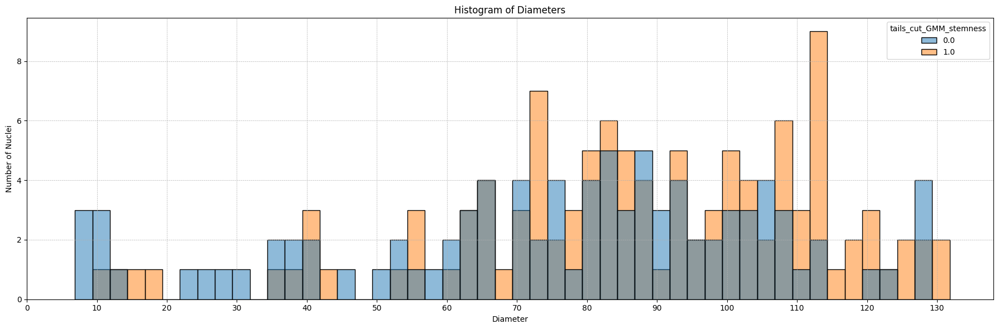

In [77]:
plt.figure(figsize=(18, 6))
sns.histplot(df, x='equivalent_diameter', hue='tails_cut_GMM_stemness', bins=50, element='bars', stat='count', alpha=0.5)

# Plot customization to resemble the original plot
plt.title('Histogram of Diameters')
plt.xlabel('Diameter')
plt.ylabel('Number of Nuclei')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

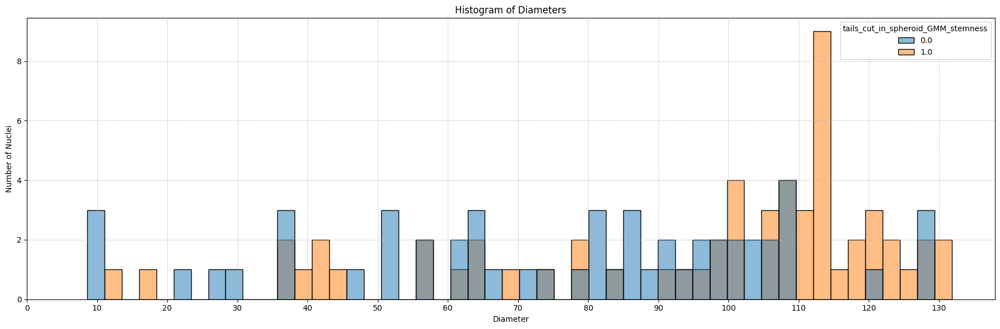

In [78]:
plt.figure(figsize=(18, 6))
sns.histplot(df, x='equivalent_diameter', hue='tails_cut_in_spheroid_GMM_stemness', bins=50, element='bars', stat='count', alpha=0.5)

# Plot customization to resemble the original plot
plt.title('Histogram of Diameters')
plt.xlabel('Diameter')
plt.ylabel('Number of Nuclei')

# Set x-ticks starting from 0 and every 10 units
xmax = plt.xlim()[1]  # Get the current maximum xlim value
plt.xticks(np.arange(0, xmax+1, 10))

plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()

### Distribución Radial de Diámetros
Primero hacemos un scatterplot con todos los puntos, coloreando por stemness (usé `tails_cut_GMM_stemness`, pero se puede cambiar el criterio fácilmente). Luego hice una regresión lineal de todas juntas, y discriminando por stemness, para ver si había una tendencia (incluyendo una versión con `statsmodels` que tiene un reporte más detallado). Obtuve también la matriz de covarianza; la componente no diagonal positiva era esperable ya que el ajuste tiene pendiente positiva.


In [79]:
df[['distance_to_center', 'equivalent_diameter', 'tails_cut_GMM_stemness', 'tails_cut_in_spheroid_GMM_stemness']]

,distance_to_center,equivalent_diameter,tails_cut_GMM_stemness,tails_cut_in_spheroid_GMM_stemness
0,941.004496,79.460650,1.0,NaN
1,822.367606,70.467256,1.0,NaN
2,341.340373,61.978736,1.0,1.0
3,722.149977,74.703473,0.0,NaN
4,837.360672,73.742838,1.0,NaN
...,...,...,...,...
199,634.740822,126.971489,0.0,0.0
200,536.186143,36.213764,0.0,0.0
201,789.104489,6.863663,0.0,NaN
202,893.674336,87.374735,1.0,NaN


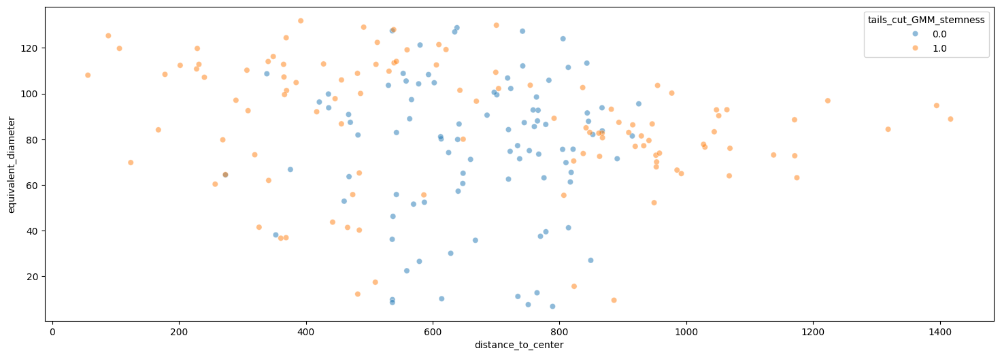

In [80]:
# Let's do a scatter plot of distance to center vs equivalent diameter, colored by stemness
plt.figure(figsize=(18, 6))
sns.scatterplot(data=df, x='distance_to_center', y='equivalent_diameter', hue='tails_cut_GMM_stemness', alpha=0.5)
plt.show()

In [81]:
# Let's obtain the covariance matrix of equivalent diameter and distance to center
df[['equivalent_diameter', 'distance_to_center']].cov()

,equivalent_diameter,distance_to_center
equivalent_diameter,853.909646,-1024.024495
distance_to_center,-1024.024495,65913.312725


All cells, fit coefficients: 
	Slope: -0.0155 
	Intercept: 91.9712



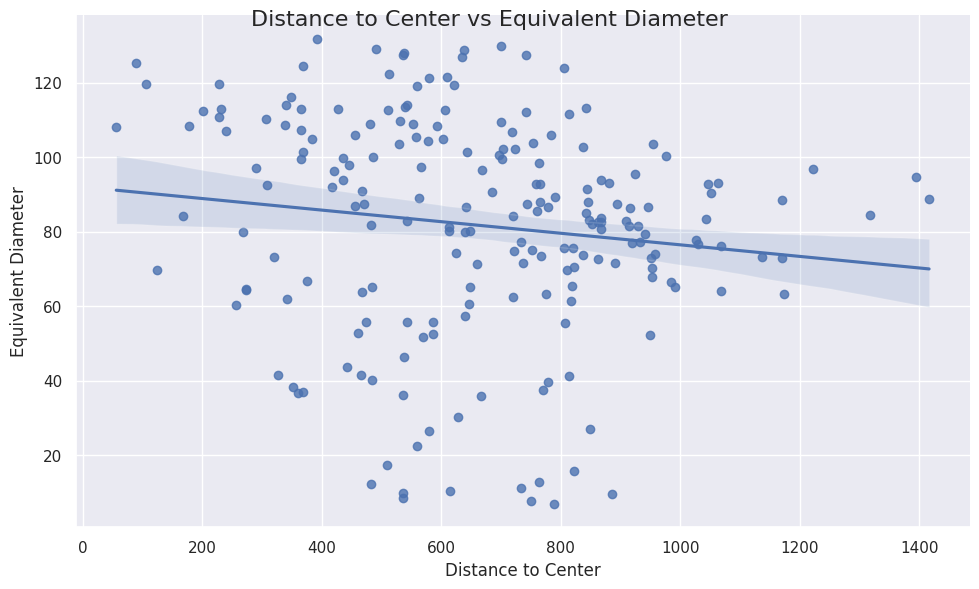

In [82]:
# Set the style
sns.set(style="darkgrid")

# Create the lmplot
g = sns.lmplot(
    x="distance_to_center",
    y="equivalent_diameter",
    # hue="tails_cut_GMM_stemness",
    data=df,
    # markers=["o", "x"], 
    fit_reg=True,
    height=6,  
    aspect=1.66
)

# Function to print the slope and intercept
def print_fit_parameters(coefficients, label):
    slope, intercept = coefficients
    print(f"{label}, fit coefficients: \n\tSlope: {slope:.4f} \n\tIntercept: {intercept:.4f}\n")

# Calculate and print regression parameters for all cells
coefficients = np.polyfit(df['distance_to_center'], df['equivalent_diameter'], 1)
print_fit_parameters(coefficients, "All cells")

# Improve the legend and axis labels
g.set_axis_labels('Distance to Center', 'Equivalent Diameter')
g.fig.suptitle('Distance to Center vs Equivalent Diameter', fontsize=16)

# Show the plot
plt.show()



Non-stem cells, fit coefficients: 
	Slope: 0.0072 
	Intercept: 70.7252

Stem cells, fit coefficients: 
	Slope: -0.0187 
	Intercept: 99.2087



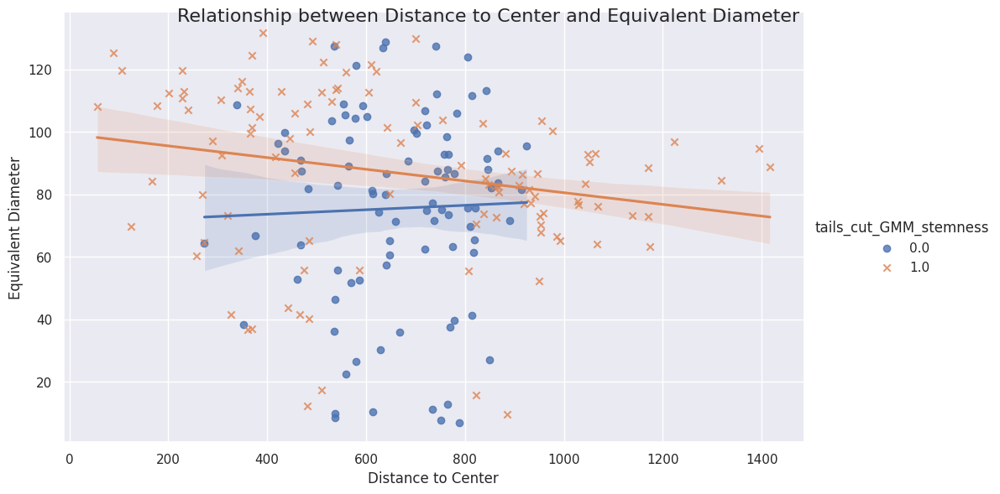

In [83]:
# Set the style
sns.set(style="darkgrid")

# Create the lmplot
g = sns.lmplot(
    x="distance_to_center",
    y="equivalent_diameter",
    hue="tails_cut_GMM_stemness",
    data=df, markers=["o", "x"], 
    fit_reg=True,
    height=6,  
    aspect=1.66
)

# Function to print the slope and intercept
def print_fit_parameters(coefficients, label):
    slope, intercept = coefficients
    print(f"{label}, fit coefficients: \n\tSlope: {slope:.4f} \n\tIntercept: {intercept:.4f}\n")

# Calculate and print regression parameters for non-stem cells
non_stem = df[df['tails_cut_GMM_stemness'] == 0]
coefficients_ns = np.polyfit(non_stem['distance_to_center'], non_stem['equivalent_diameter'], 1)
print_fit_parameters(coefficients_ns, "Non-stem cells")

# Calculate and print regression parameters for stem cells
stem = df[df['tails_cut_GMM_stemness'] == 1]
coefficients_s = np.polyfit(stem['distance_to_center'], stem['equivalent_diameter'], 1)
print_fit_parameters(coefficients_s, "Stem cells")

# Improve the legend and axis labels
g.set_axis_labels('Distance to Center', 'Equivalent Diameter')
g.fig.suptitle('Relationship between Distance to Center and Equivalent Diameter', fontsize=16)

# Show the plot
plt.show()


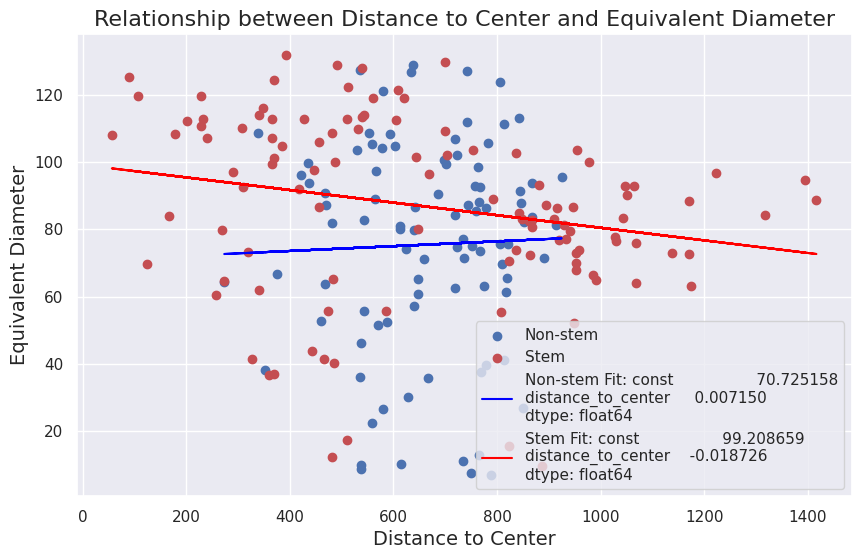

                             OLS Regression Results                            
Dep. Variable:     equivalent_diameter   R-squared:                       0.001
Model:                             OLS   Adj. R-squared:                 -0.010
Method:                  Least Squares   F-statistic:                   0.09761
Date:                 Thu, 04 Jan 2024   Prob (F-statistic):              0.755
Time:                         21:23:14   Log-Likelihood:                -450.96
No. Observations:                   93   AIC:                             905.9
Df Residuals:                       91   BIC:                             911.0
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 70.7

In [84]:
# ====== MORE DETAILED STATISTICS ======

# Set the style
sns.set(style="darkgrid")

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Scatter plot
non_stem = df[df['tails_cut_GMM_stemness'] == 0]
stem = df[df['tails_cut_GMM_stemness'] == 1]
ax.scatter(non_stem['distance_to_center'], non_stem['equivalent_diameter'], label='Non-stem', color='b')
ax.scatter(stem['distance_to_center'], stem['equivalent_diameter'], label='Stem', color='r')

# Fit and plot regression line for Non-stem
X_ns = sm.add_constant(non_stem['distance_to_center'])  # adding a constant
model_ns = sm.OLS(non_stem['equivalent_diameter'], X_ns).fit()
predictions_ns = model_ns.predict(X_ns)
ax.plot(non_stem['distance_to_center'], predictions_ns, color='blue', label=f'Non-stem Fit: {model_ns.params}')

# Fit and plot regression line for Stem
X_s = sm.add_constant(stem['distance_to_center'])  # adding a constant
model_s = sm.OLS(stem['equivalent_diameter'], X_s).fit()
predictions_s = model_s.predict(X_s)
ax.plot(stem['distance_to_center'], predictions_s, color='red', label=f'Stem Fit: {model_s.params}')

# Customize the axes and title
ax.set_title('Relationship between Distance to Center and Equivalent Diameter', fontsize=16)
ax.set_xlabel('Distance to Center', fontsize=14)
ax.set_ylabel('Equivalent Diameter', fontsize=14)

# Legend
ax.legend()

# Show the plot
plt.show()

# Print the summary of the regression models
print(model_ns.summary())
print(model_s.summary())


### Diámetro del esferoide completo
De los gráficos de las distribuciones se ve que el radio del esferoide $r$ es aprox. $r \simeq 125 \mu \text{m}$. Una cota para el radio es $r<180 \mu \text{m}$.

In [85]:
print(f'spacing_x: {spacing_x}')
print(f'spacing_y: {spacing_y}')

spacing_x: 1.236463351755339e-07
spacing_y: 1.2364633517553394e-07


In [86]:
# Extract the spacing values
# spacing_y, spacing_x = 1.2364633517553391e-7, 1.2364633517553391e-7  # meters per pixel in y and x dimensions

# Calculate the new centroid coordinates
df['centroid-0_meters'] = df['centroid-0'].astype('float64') * spacing_y
df['centroid-1_meters'] = df['centroid-1'].astype('float64') * spacing_x

# Calculate the center of the spheroid in meters
center_of_spheroid_meters = np.mean(df[['centroid-0_meters', 'centroid-1_meters']], axis=0)

# Calculate the distance of each object to the center of the spheroid
df['distance_to_center_meters'] = np.sqrt((df['centroid-0_meters'] - center_of_spheroid_meters[0])**2 +
                                          (df['centroid-1_meters'] - center_of_spheroid_meters[1])**2)

# Convert distance from meters to micrometers (1 meter = 1,000,000 micrometers)
df['distance_to_center_micrometers'] = df['distance_to_center_meters'] * 1e6

# Set display options for floating-point numbers
pd.set_option('display.float_format', '{:.2e}'.format)  # decimal places in scientific notation
# pd.reset_option('display.float_format') # to go back to default

# Now df includes the centroids in meters
df[['centroid-0', 'centroid-1', 'centroid-0_meters', 'centroid-1_meters', 'distance_to_center_meters', 'distance_to_center_micrometers']]


537389200.py (12): Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
537389200.py (13): Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


,centroid-0,centroid-1,centroid-0_meters,centroid-1_meters,distance_to_center_meters,distance_to_center_micrometers
0,2.17e+03,1.42e+03,2.68e-04,1.76e-04,1.16e-04,1.16e+02
1,1.19e+03,2.06e+03,1.47e-04,2.55e-04,1.02e-04,1.02e+02
2,1.58e+03,1.30e+03,1.95e-04,1.61e-04,4.22e-05,4.22e+01
3,1.95e+03,1.09e+03,2.41e-04,1.35e-04,8.93e-05,8.93e+01
4,4.33e+02,1.03e+03,5.35e-05,1.27e-04,1.04e-04,1.04e+02
...,...,...,...,...,...,...
199,9.66e+02,1.81e+03,1.19e-04,2.24e-04,7.85e-05,7.85e+01
200,1.75e+03,1.07e+03,2.17e-04,1.33e-04,6.63e-05,6.63e+01
201,1.77e+03,1.83e+03,2.19e-04,2.26e-04,9.76e-05,9.76e+01
202,1.77e+03,1.96e+03,2.19e-04,2.43e-04,1.10e-04,1.10e+02


In [87]:
df[['distance_to_center_meters', 'distance_to_center_micrometers']].describe()

,distance_to_center_meters,distance_to_center_micrometers
count,2.04e+02,2.04e+02
mean,8.17e-05,8.17e+01
std,3.17e-05,3.17e+01
min,6.96e-06,6.96e+00
25%,5.96e-05,5.96e+01
50%,8.01e-05,8.01e+01
75%,1.04e-04,1.04e+02
max,1.75e-04,1.75e+02


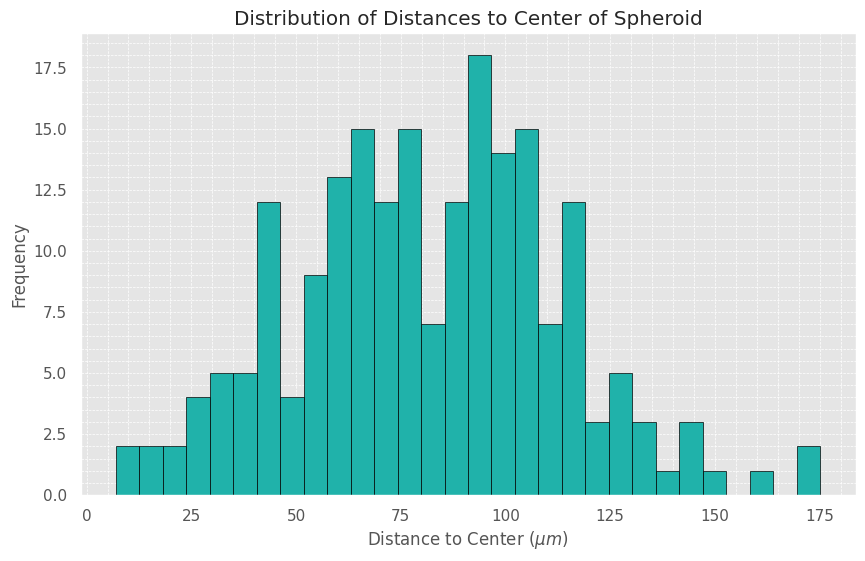

In [88]:
# Set the style of the plot
plt.style.use('ggplot')

# Plotting the distribution of distances in micrometers
plt.figure(figsize=(10, 6))
# plt.hist(df['distance_to_center_meters'], bins=30, color='skyblue', edgecolor='black')
plt.hist(df['distance_to_center_micrometers'], bins=30, color='lightseagreen', edgecolor='black')
plt.title('Distribution of Distances to Center of Spheroid')
plt.xlabel('Distance to Center ($\mu m$)')
plt.ylabel('Frequency')

# Adding the grid
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Showing x and y ticks
plt.minorticks_on()

plt.show()


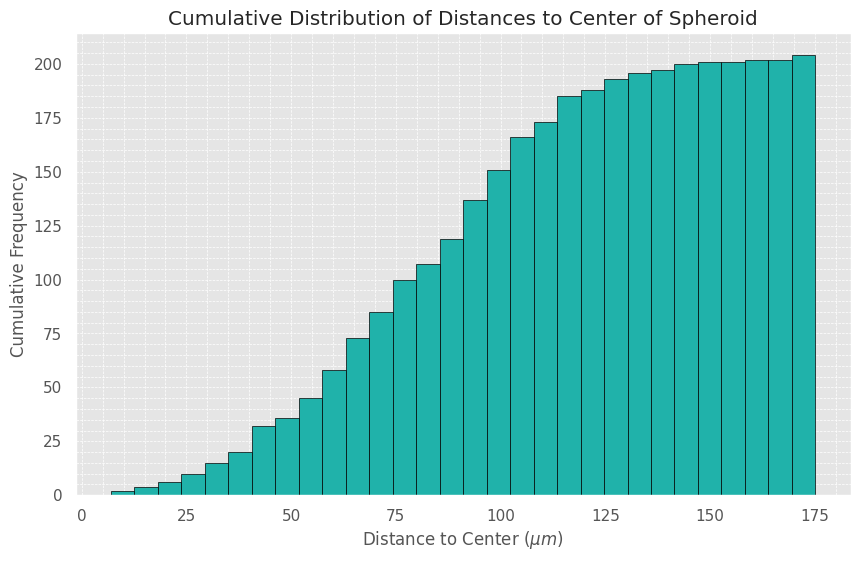

In [89]:
# Set the style of the plot
plt.style.use('ggplot')

# Plotting the cumulative distribution of distances in micrometers
plt.figure(figsize=(10, 6))
plt.hist(df['distance_to_center_micrometers'], bins=30, color='lightseagreen', edgecolor='black', cumulative=True)
plt.title('Cumulative Distribution of Distances to Center of Spheroid')
plt.xlabel('Distance to Center ($\mu m$)')
plt.ylabel('Cumulative Frequency')

# Adding the grid
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Showing x and y ticks
plt.minorticks_on()

plt.show()


### Delaunay Triangulation
> If you take each of the points from a Voronoi diagram and link it with the points in its neighboring cells, you will obtain a graph called the Delaunay triangulation. In mathematical terms, the Delaunay triangulation is the dual graph of the Voronoi diagram. ([Source.](https://builtin.com/data-science/voronoi-diagram))

In [90]:
df[['label', 'centroid-0', 'centroid-1', 'tails_cut_GMM_stemness']].head()

,label,centroid-0,centroid-1,tails_cut_GMM_stemness
0,1,2.17e+03,1.42e+03,1.00e+00
1,2,1.19e+03,2.06e+03,1.00e+00
2,3,1.58e+03,1.30e+03,1.00e+00
3,4,1.95e+03,1.09e+03,0.00e+00
4,5,4.33e+02,1.03e+03,1.00e+00


In [91]:
# Extract the centroids and labels
x = df['centroid-0'].values
y = df['centroid-1'].values
labels = df['label'].values
points = np.array([x, y]).T  # Transpose to get (x, y) pairs

# Create Delaunay triangulation
tri = Delaunay(points)

# Create a NetworkX graph
G = nx.Graph()

# Add nodes with the 'tails_cut_GMM_stemness' attribute and original labels from df
for label, point, stemness in zip(labels, points, df['tails_cut_GMM_stemness']):
    G.add_node(label, pos=(point[0], point[1]), tails_cut_GMM_stemness=stemness)

# Add edges from Delaunay triangulation
for simplex in tri.simplices:
    for i in range(3):
        for j in range(i + 1, 3):
            G.add_edge(labels[simplex[i]], labels[simplex[j]])


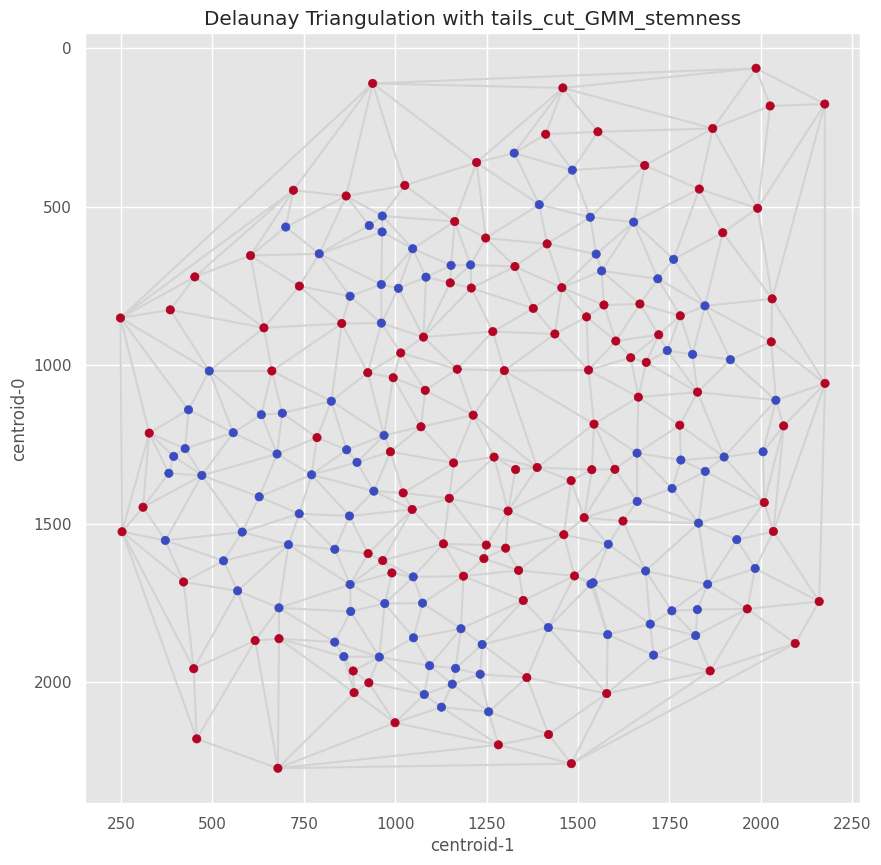

In [92]:
# Plotting settings
plt.figure(figsize=(10, 10), dpi=100)  # Increase plot size and DPI for better quality

# Plot Delaunay triangulation with centroid-1 on the x-axis and centroid-0 on the y-axis
plt.triplot(points[:, 1], points[:, 0], tri.simplices, color='lightgrey')
plt.scatter(points[:, 1], points[:, 0], c=df['tails_cut_GMM_stemness'], cmap='coolwarm')  # Color nodes based on 'tails_cut_GMM_stemness'
# plt.colorbar(label='tails_cut_GMM_stemness') # Colorbar shows the mapping from color to value 
# (1 -> stem -> red, 0 -> non-stem -> blue)
plt.title('Delaunay Triangulation with tails_cut_GMM_stemness')
plt.xlabel('centroid-1')
plt.ylabel('centroid-0')

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()


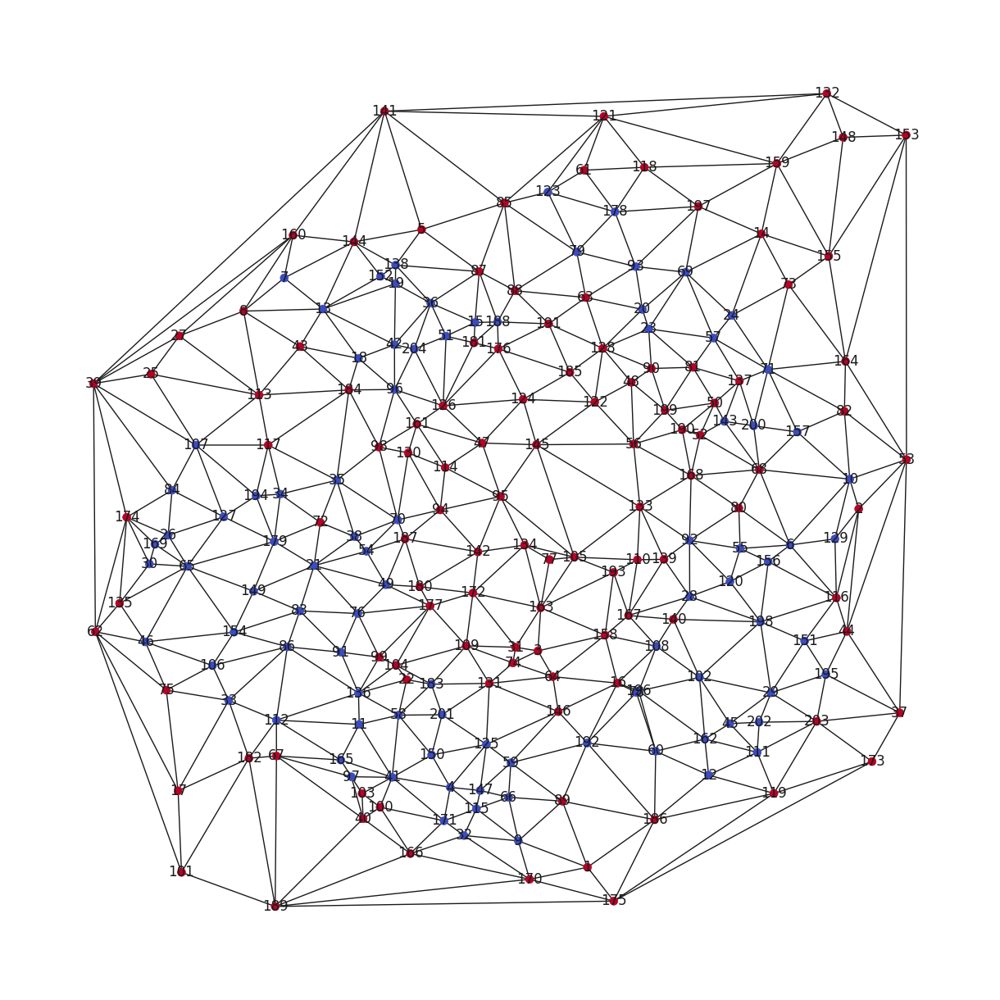

In [93]:
# Plotting settings
plt.figure(figsize=(12, 12), dpi=100)  # Increase plot size and DPI for better quality

# Extract positions
pos = nx.get_node_attributes(G, 'pos')

# Adjust positions: swap x and y coordinates to use centroid-1 as x and centroid-0 as y
adjusted_pos = {node: (pos[node][1], pos[node][0]) for node in pos}

# Draw the NetworkX graph with the adjusted positions
node_colors = list(nx.get_node_attributes(G, 'tails_cut_GMM_stemness').values())
nx.draw(G, adjusted_pos, node_size=50, node_color=node_colors, cmap='coolwarm', with_labels=True)

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()


#### Ways of measuring heterogeneity of distribution of CSCs

##### Homophily
If the CSCs are not distributed homogeneously, it follows that there're regions with more stem cells than others. As the Delaunay triangulation reflects which cells are neighbors, having many (non) stem cells next to each other will result in network homophily (i.e., more connections between cells of the same type). We can measure homophily by calculating the proportion of edges that connect nodes with the same `'tails_cut_GMM_stemness'` value versus those that connect nodes with different values.

In [94]:
# Calculate homophily
same_stemness_edges = 0
different_stemness_edges = 0

for edge in G.edges():
    node1, node2 = edge
    if G.nodes[node1]['tails_cut_GMM_stemness'] == G.nodes[node2]['tails_cut_GMM_stemness']:
        same_stemness_edges += 1
    else:
        different_stemness_edges += 1

total_edges = same_stemness_edges + different_stemness_edges
homophily_ratio = same_stemness_edges / total_edges
heterophily_ratio = different_stemness_edges / total_edges

print("Homophily Ratio (Same stemness):", homophily_ratio)
print("Heterophily Ratio (Different stemness):", heterophily_ratio)


Homophily Ratio (Same stemness): 0.7123745819397993
Heterophily Ratio (Different stemness): 0.28762541806020064


**Assortativity** is a preference for a network's nodes to attach to others that are similar in some way. In this case, we want to evaluate if they prefer to attach to nodes with the same stemness. The assortativity coefficient measures the similarity of connections in the graph with respect to the node attribute. A high assortativity coefficient indicates homophily.

In [95]:
assortativity = nx.attribute_assortativity_coefficient(G, 'tails_cut_GMM_stemness')
print("Assortativity Coefficient:", assortativity)


Assortativity Coefficient: 0.41965988467224113


When $r = 1$, the network is said to have perfect assortative mixing patterns, when $r = 0$ the network is non-assortative, while at $r = −1$ the network is completely disassortative. Since stem cells are less than a quarter of the total of cells, we'd expect that the network would be more dissortative were stem cells distributed randomly.

*Note:* having so many DCCs, some homophily is to be expected. We need to quantify what is to be expected if stem cells were distributed randomly.

*To do:* to quantify what is to be expected, make a new graph of the same number of nodes, randomly select nodes to be the stem cells (such that they make up the same quantity of stem cells as here), and calculate this coefficient.

##### Connected Components
Otra cosa que uno ve a simple vista y da cuenta de la heterogeneidad de la distribución de madres, es que las (no) madres parecen formar clusters. Podemos analizar esto armando subgrafos y calculando el número de componentes conexas para cada uno.

Notar que el número de componentes conexas para las madres es 11, mucho menor al número de células madre (72 según este criterio). Si estuvieran distribuidas de manera completamente aleatoria, uno esperaría un número mayor de clusters.

In [96]:
# Create subgraphs for each stemness value
subgraph_0 = G.subgraph([n for n, attrdict in G.nodes(data=True) if attrdict['tails_cut_GMM_stemness'] == 0])
subgraph_1 = G.subgraph([n for n, attrdict in G.nodes(data=True) if attrdict['tails_cut_GMM_stemness'] == 1])

# Calculate connected components
connected_components_0 = nx.number_connected_components(subgraph_0)
connected_components_1 = nx.number_connected_components(subgraph_1)

print("Connected components (Stemness 0):", connected_components_0)
print("Connected components (Stemness 1):", connected_components_1)


Connected components (Stemness 0): 2
Connected components (Stemness 1): 2


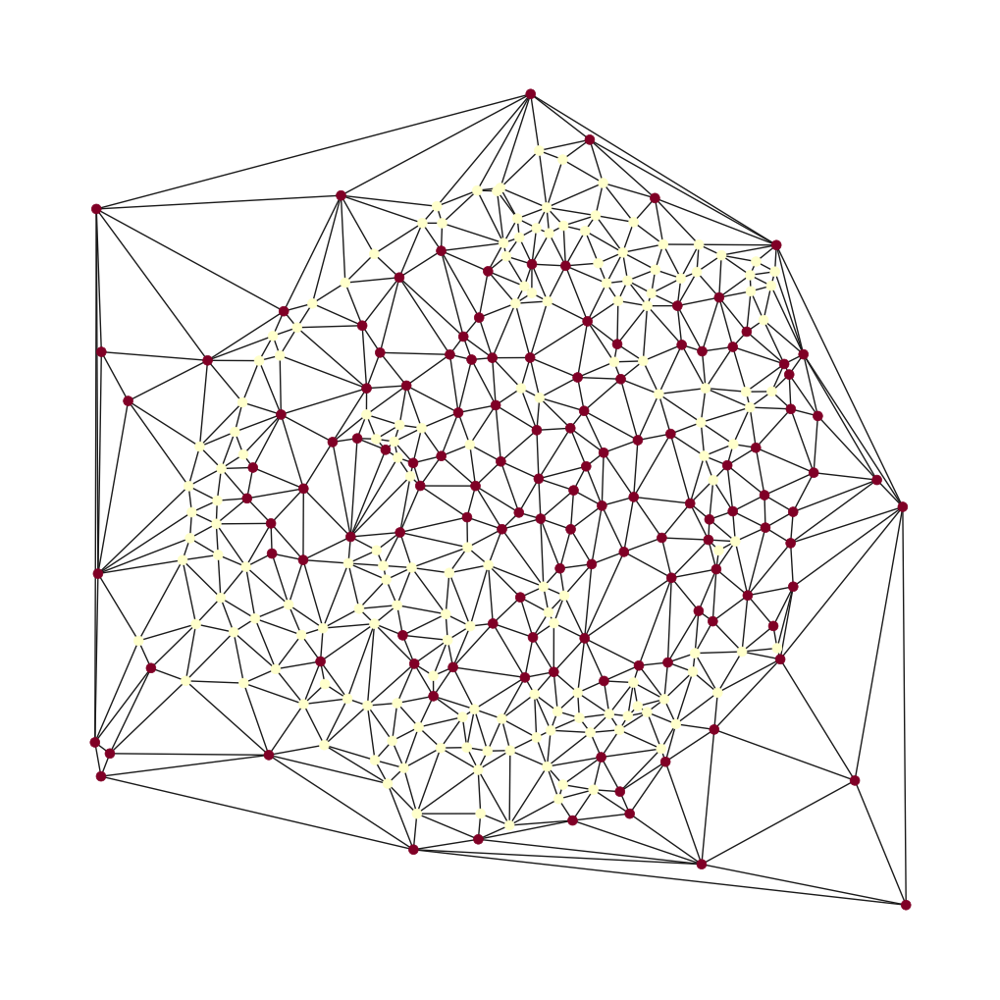

In [101]:
# Reds colormap for seeinng only stem cells (and identifying more easily their connected components)
# Plotting settings
plt.figure(figsize=(10, 10), dpi=100)  # Increase plot size and DPI for better quality

# Draw the NetworkX graph
pos = nx.get_node_attributes(G, 'pos')
nx.draw(G, pos, node_size=50, node_color=list(nx.get_node_attributes(G, 'tails_cut_GMM_stemness').values()), cmap='YlOrRd', with_labels=False)
plt.show()

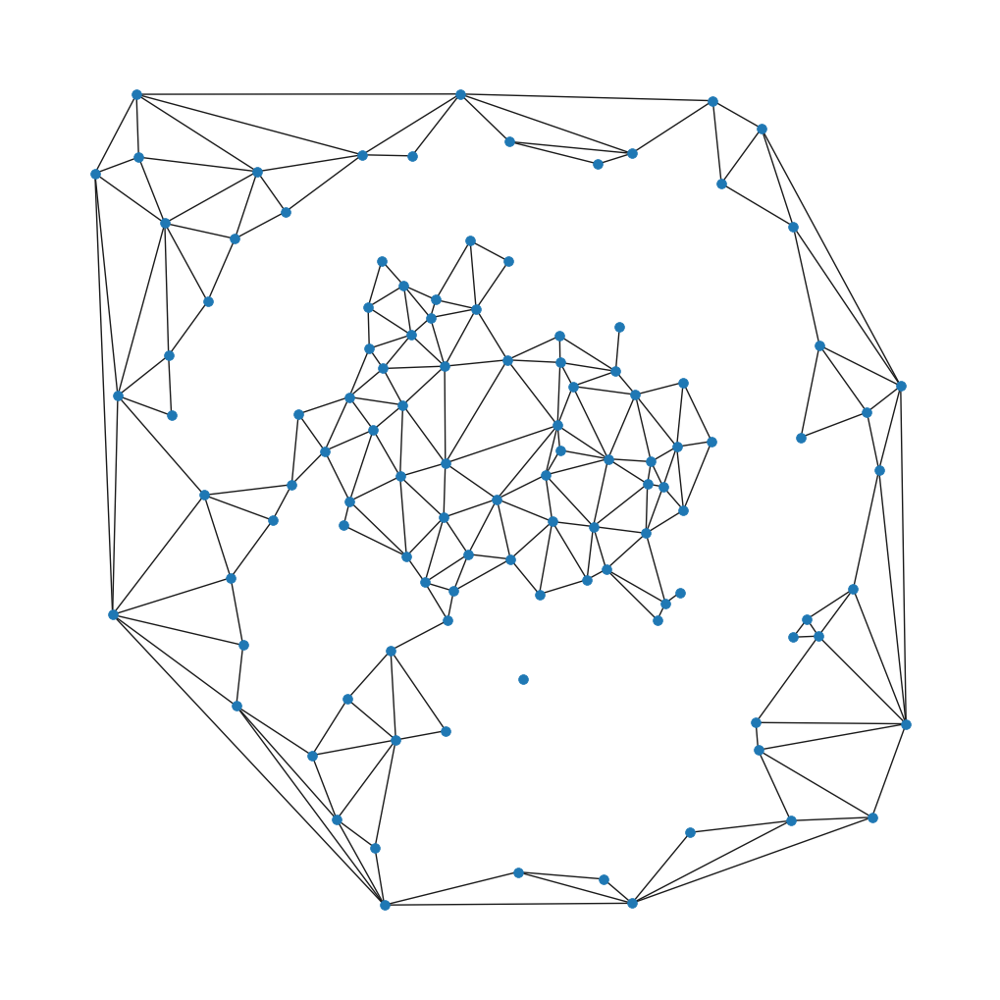

In [97]:
# Let's draw subgraph_1
# Plotting settings
plt.figure(figsize=(10, 10), dpi=100)  # Increase plot size and DPI for better quality

# Draw the NetworkX graph
pos = nx.get_node_attributes(subgraph_1, 'pos')
nx.draw(subgraph_1, pos, node_size=50, with_labels=False)
plt.show()

### Delaunay Triangulation: `in_spheroid` only

In [98]:
# Filter for cells in the spheroid
in_spheroid_df = df[df['in_spheroid'] == True]

# Extract the centroids and labels for cells within the spheroid
x_in_sph = in_spheroid_df['centroid-0'].values
y_in_sph = in_spheroid_df['centroid-1'].values
labels_in_sph = in_spheroid_df['label'].values
points_in_sph = np.array([x_in_sph, y_in_sph]).T  # Transpose to get (x, y) pairs

# Create Delaunay triangulation for the cells within the spheroid
tri_in_sph = Delaunay(points_in_sph)

# Create a NetworkX graph
G_in_sph = nx.Graph()

# Add nodes with the 'tails_cut_in_spheroid_GMM_stemness' attribute and original labels from in_spheroid_df
for label, point, stemness in zip(labels_in_sph, points_in_sph, in_spheroid_df['tails_cut_in_spheroid_GMM_stemness']):
    G_in_sph.add_node(label, pos=(point[0], point[1]), tails_cut_in_spheroid_GMM_stemness=stemness)

# Add edges from Delaunay triangulation for the cells within the spheroid
for simplex in tri_in_sph.simplices:
    for i in range(3):
        for j in range(i + 1, 3):
            G_in_sph.add_edge(labels_in_sph[simplex[i]], labels_in_sph[simplex[j]])


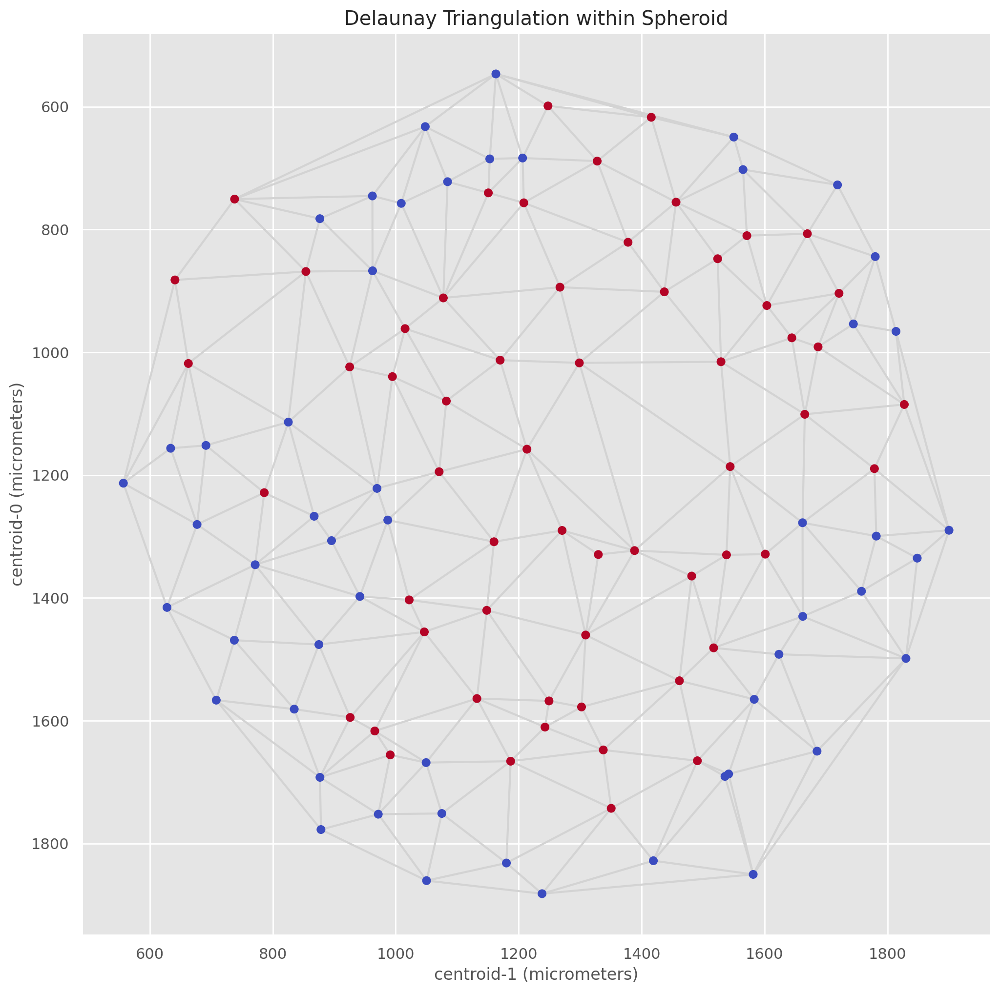

In [99]:
# Plotting settings for Delaunay triangulation
plt.figure(figsize=(12, 12), dpi=200)

# Plot Delaunay triangulation for in_spheroid points
plt.triplot(points_in_sph[:, 1], points_in_sph[:, 0], tri_in_sph.simplices, color='lightgrey')
plt.scatter(points_in_sph[:, 1], points_in_sph[:, 0], c=in_spheroid_df['tails_cut_in_spheroid_GMM_stemness'], cmap='coolwarm')
plt.title('Delaunay Triangulation within Spheroid')
plt.xlabel('centroid-1 (micrometers)')
plt.ylabel('centroid-0 (micrometers)')

# Invert the y-axis to match image conventions
plt.gca().invert_yaxis()

plt.show()


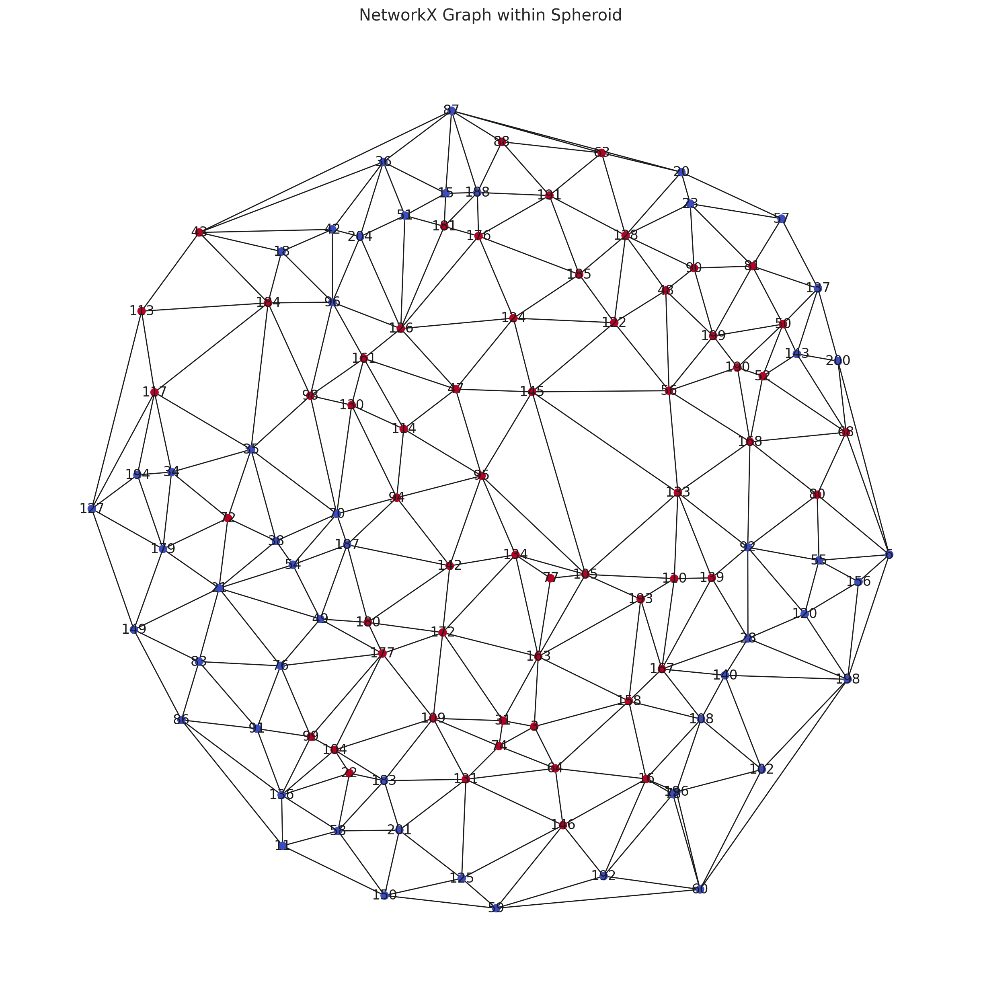

In [100]:
# Plotting settings for NetworkX graph
plt.figure(figsize=(12, 12), dpi=200)

# Extract positions
pos = nx.get_node_attributes(G_in_sph, 'pos')

# Adjust positions for in_spheroid points: swap x and y coordinates to use centroid-1 as x and centroid-0 as y
adjusted_pos_in_sph = {node: (pos[node][1], pos[node][0]) for node in pos}

# Draw the NetworkX graph for in_spheroid points with the adjusted positions
node_colors_in_sph = list(nx.get_node_attributes(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness').values())
nx.draw(G_in_sph, adjusted_pos_in_sph, node_size=50, node_color=node_colors_in_sph, cmap='coolwarm', with_labels=True)
plt.title('NetworkX Graph within Spheroid')

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()


##### Homophily


In [101]:
# Calculate homophily
same_stemness_edges_in_sph = 0
different_stemness_edges_in_sph = 0

for edge in G_in_sph.edges():
    node1, node2 = edge
    if G_in_sph.nodes[node1]['tails_cut_in_spheroid_GMM_stemness'] == G_in_sph.nodes[node2]['tails_cut_in_spheroid_GMM_stemness']:
        same_stemness_edges_in_sph += 1
    else:
        different_stemness_edges_in_sph += 1

total_edges_in_sph = same_stemness_edges_in_sph + different_stemness_edges_in_sph
homophily_ratio_in_sph = same_stemness_edges_in_sph / total_edges_in_sph
heterophily_ratio_in_sph = different_stemness_edges_in_sph / total_edges_in_sph

print("Homophily Ratio (Same stemness):", homophily_ratio_in_sph)
print("Heterophily Ratio (Different stemness):", heterophily_ratio_in_sph)

Homophily Ratio (Same stemness): 0.7381703470031545
Heterophily Ratio (Different stemness): 0.2618296529968454


In [102]:
# Calculate assortativity
assortativity_in_sph = nx.attribute_assortativity_coefficient(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness')
print("Assortativity Coefficient:", assortativity_in_sph)

Assortativity Coefficient: 0.4716083101547361


In [103]:
# Create subgraphs for each stemness value
subgraph_0_in_sph = G_in_sph.subgraph([n for n, attrdict in G_in_sph.nodes(data=True) if attrdict['tails_cut_in_spheroid_GMM_stemness'] == 0])
subgraph_1_in_sph = G_in_sph.subgraph([n for n, attrdict in G_in_sph.nodes(data=True) if attrdict['tails_cut_in_spheroid_GMM_stemness'] == 1])

# Calculate connected components
connected_components_0_in_sph = nx.number_connected_components(subgraph_0_in_sph)
connected_components_1_in_sph = nx.number_connected_components(subgraph_1_in_sph)

print("Connected components (Stemness 0):", connected_components_0_in_sph)
print("Connected components (Stemness 1):", connected_components_1_in_sph)


Connected components (Stemness 0): 1
Connected components (Stemness 1): 2


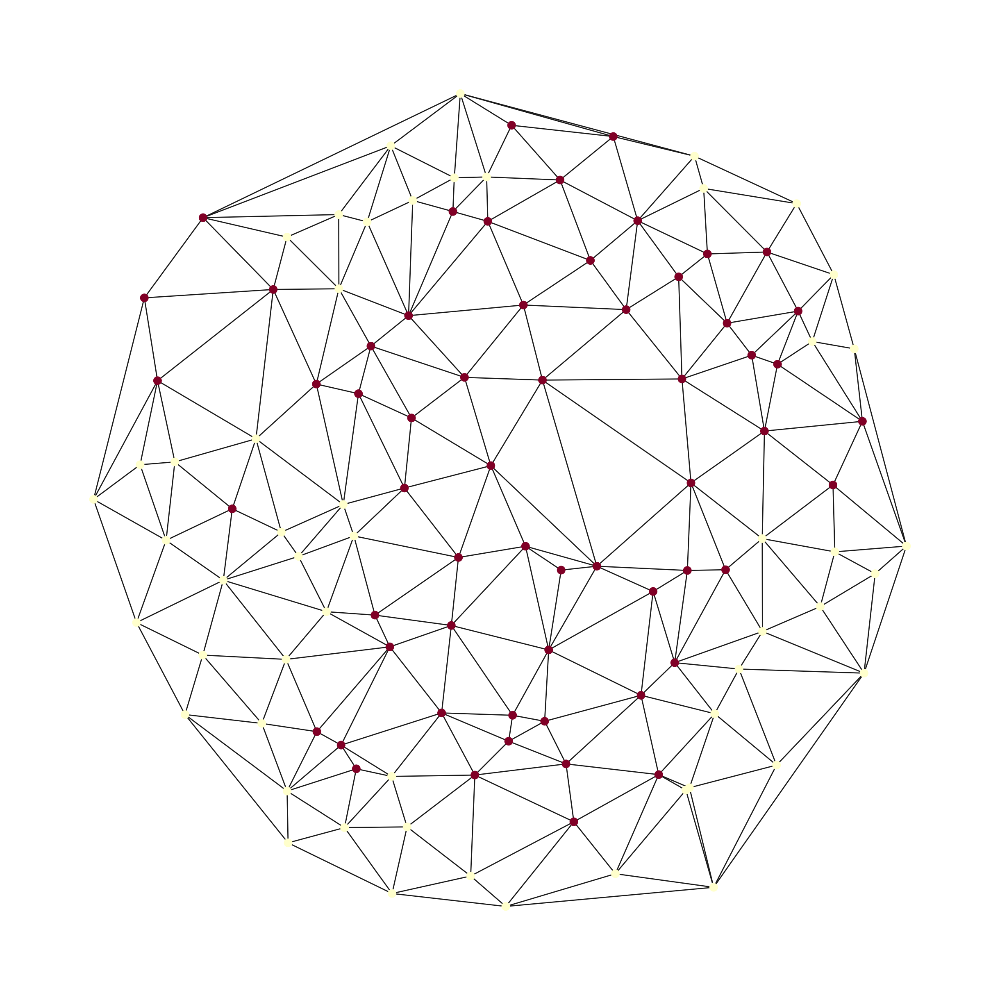

In [104]:
# Plotting settings for NetworkX graph
plt.figure(figsize=(12, 12), dpi=200)

# Extract positions
pos = nx.get_node_attributes(G_in_sph, 'pos')

# Adjust positions for in_spheroid points: swap x and y coordinates to use centroid-1 as x and centroid-0 as y
adjusted_pos_in_sph = {node: (pos[node][1], pos[node][0]) for node in pos}

# Draw the NetworkX graph for in_spheroid points with the adjusted positions
node_colors_in_sph = list(nx.get_node_attributes(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness').values())
nx.draw(G_in_sph, adjusted_pos_in_sph, node_size=50, node_color=list(nx.get_node_attributes(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness').values()), cmap='YlOrRd', with_labels=False)
# plt.title('NetworkX Graph within Spheroid')

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()

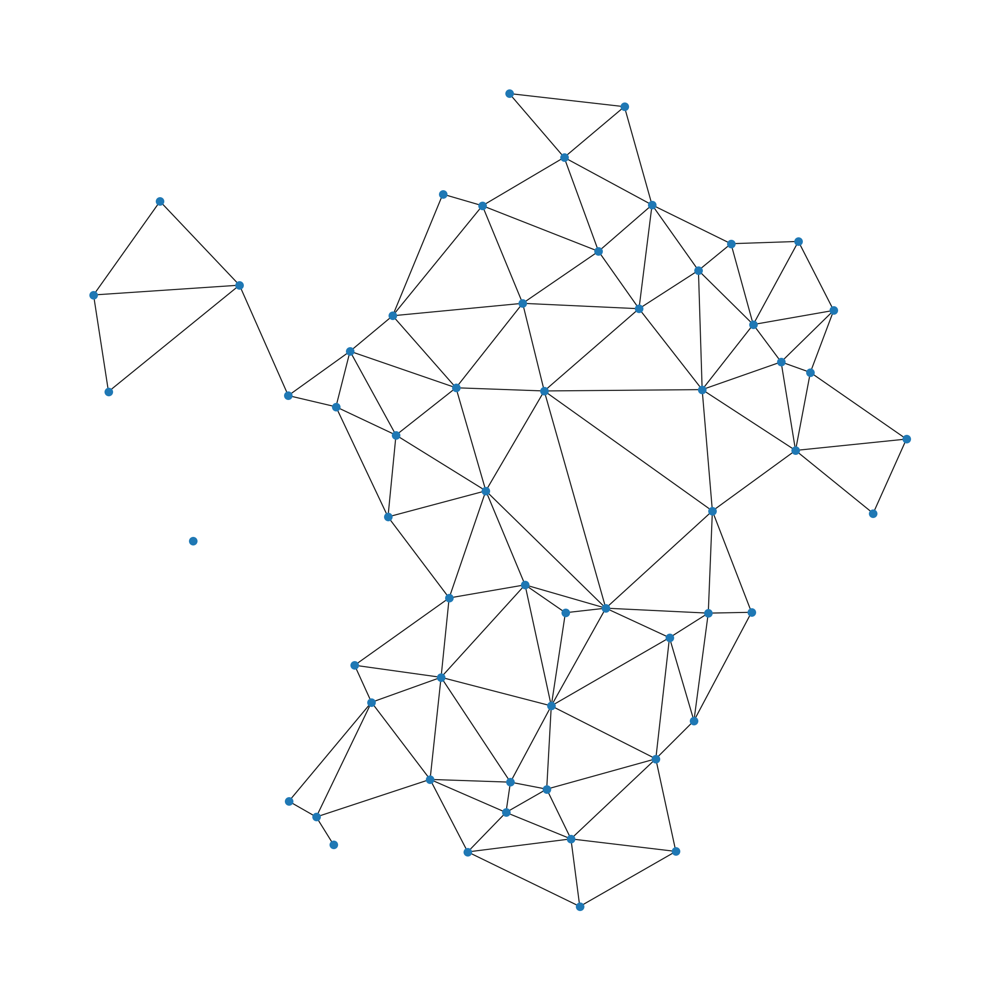

In [105]:
# Let's draw subgraph_1
# Plotting settings
plt.figure(figsize=(12, 12), dpi=200)  # Increase plot size and DPI for better quality

# Extract positions
pos_1_in_sph = nx.get_node_attributes(subgraph_1_in_sph, 'pos')

# Adjust positions for in_spheroid points: swap x and y coordinates to use centroid-1 as x and centroid-0 as y
adjusted_pos_1_in_sph = {node: (pos_1_in_sph[node][1], pos_1_in_sph[node][0]) for node in pos_1_in_sph}

# Draw the NetworkX graph
nx.draw(subgraph_1_in_sph, adjusted_pos_1_in_sph, node_size=50, with_labels=False)

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()

### Same Network with Randomly Placed CSCs
The goal here is to take the `G_in_sph` graph, make a copy of it, and randomly set a `stemness` attribute in such a way that there are the same number of stem cells in this copy than in `G_in_sph` (but randomly placed). In this way, we can compare the homophily parameters calculated before.

#### An example

In [106]:
# Step 1: Count the number of stem cells in the original graph
original_stem_count = sum(nx.get_node_attributes(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness').values())

# Convert original_stem_count to an integer if it's not already
original_stem_count = int(original_stem_count)

# Step 2: Make a copy of the original graph
G_randomized = G_in_sph.copy()

# Step 3: Randomly assign stemness attributes to nodes in the copied graph
nodes = list(G_randomized.nodes())
np.random.shuffle(nodes)  # Randomize the order of nodes

# Assign stemness to the first 'original_stem_count' nodes
for node in nodes[:original_stem_count]:
    G_randomized.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 1

# Assign non-stemness to the remaining nodes
for node in nodes[original_stem_count:]:
    G_randomized.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 0


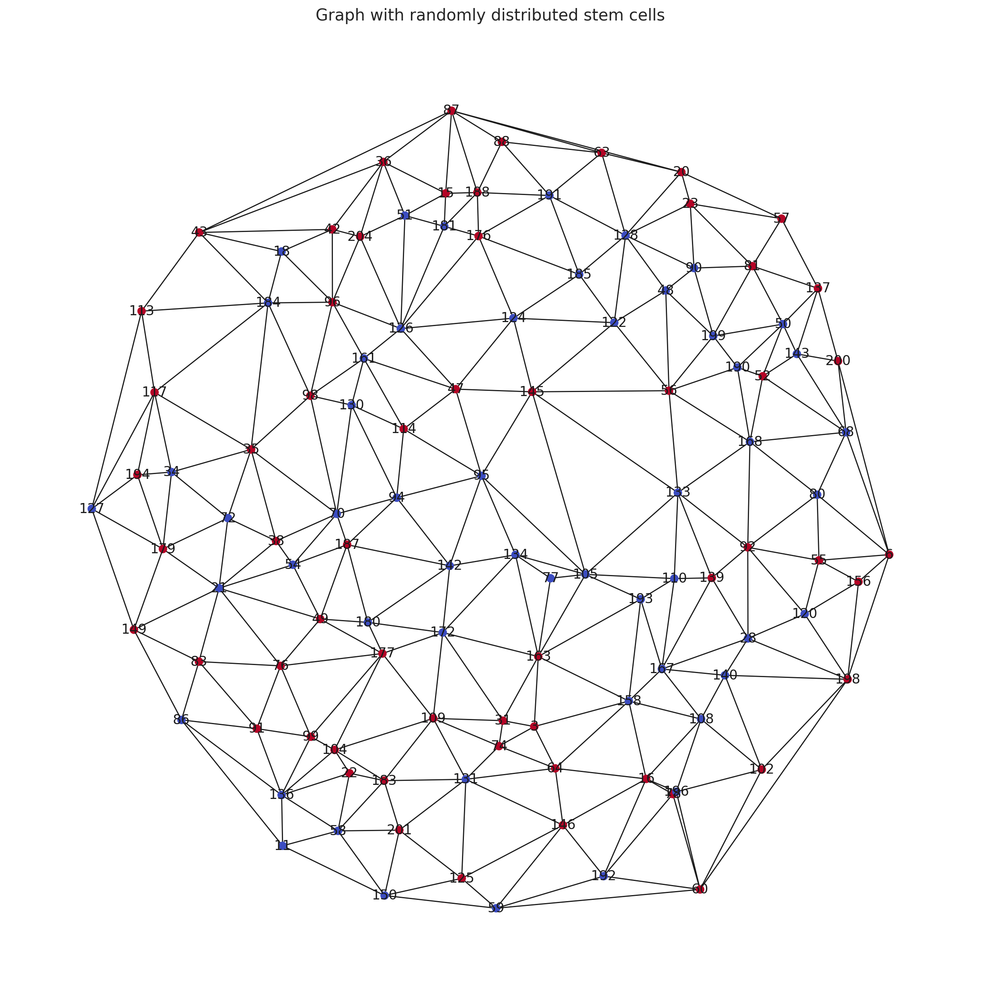

In [107]:
# Plotting settings for NetworkX graph
plt.figure(figsize=(12, 12), dpi=200)

# Extract positions
pos = nx.get_node_attributes(G_randomized, 'pos')

# Adjust positions for in_spheroid points: swap x and y coordinates to use centroid-1 as x and centroid-0 as y
adjusted_pos_in_sph = {node: (pos[node][1], pos[node][0]) for node in pos}

# Draw the NetworkX graph for in_spheroid points with the adjusted positions
node_colors_in_sph = list(nx.get_node_attributes(G_randomized, 'tails_cut_in_spheroid_GMM_stemness').values())
nx.draw(G_randomized, adjusted_pos_in_sph, node_size=50, node_color=node_colors_in_sph, cmap='coolwarm', with_labels=True)
plt.title('Graph with randomly distributed stem cells')

# Invert the y-axis to align with image coordinate system
plt.gca().invert_yaxis()

plt.show()

#### Ensamble of Random Graphs

In [108]:
# Set display options for floating-point numbers
# pd.set_option('display.float_format', '{:.2e}'.format)  # decimal places in scientific notation
pd.reset_option('display.float_format') # to go back to default

In [109]:
# Function to calculate homophily parameters for a given graph
def calculate_homophily_parameters(G, attribute):
    # Initialize counts
    same_attr_edges = 0
    different_attr_edges = 0

    # Calculate homophily and heterophily ratios
    for edge in G.edges():
        node1, node2 = edge
        if G.nodes[node1][attribute] == G.nodes[node2][attribute]:
            same_attr_edges += 1
        else:
            different_attr_edges += 1

    total_edges = same_attr_edges + different_attr_edges
    homophily_ratio = same_attr_edges / total_edges if total_edges > 0 else 0
    heterophily_ratio = different_attr_edges / total_edges if total_edges > 0 else 0

    # Calculate assortativity
    assortativity = nx.attribute_assortativity_coefficient(G, attribute)

    # Calculate connected components for each attribute value
    subgraphs = {
        attr_val: G.subgraph([n for n, attrdict in G.nodes(data=True) if attrdict[attribute] == attr_val])
        for attr_val in set(nx.get_node_attributes(G, attribute).values())
    }
    connected_components = {attr_val: nx.number_connected_components(subgraph) for attr_val, subgraph in subgraphs.items()}

    return homophily_ratio, heterophily_ratio, assortativity, connected_components

# Prepare the DataFrame to store the results
random_homophily_df = pd.DataFrame(columns=['iteration', 'homophily_ratio', 'heterophily_ratio', 'assortativity', 'connected_components_0', 'connected_components_1'])

# Number of iterations for randomization (ensamble size)
iterations = 10000

# Set the seed
np.random.seed(42)

# Number of stem cells in the original graph
stem_count = int(sum(nx.get_node_attributes(G_in_sph, 'tails_cut_in_spheroid_GMM_stemness').values()))

# Initialize list to store the results
results = []

for i in range(iterations):
    # Create a randomized version of the graph
    G_random = G_in_sph.copy()
    nodes = list(G_random.nodes())
    np.random.shuffle(nodes)
    
    # Randomly assign stemness
    for node in nodes[:stem_count]:
        G_random.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 1
    for node in nodes[stem_count:]:
        G_random.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 0

    # Calculate homophily parameters
    homophily_ratio, heterophily_ratio, assortativity, connected_components = calculate_homophily_parameters(G_random, 'tails_cut_in_spheroid_GMM_stemness')

    # Store the results in the list
    results.append({
        'iteration': i,
        'homophily_ratio': homophily_ratio,
        'heterophily_ratio': heterophily_ratio,
        'assortativity': assortativity,
        'connected_components_0': connected_components.get(0, 0),
        'connected_components_1': connected_components.get(1, 0),
    })

# Create the DataFrame from the list of results after the loop
random_homophily_df = pd.DataFrame(results)

# Display or save the DataFrame
random_homophily_df
# random_homophily_df.to_csv('random_homophily_analysis.csv', index=False)


,iteration,homophily_ratio,heterophily_ratio,assortativity,connected_components_0,connected_components_1
0,0,0.444795,0.555205,-0.113613,7,1
1,1,0.539432,0.460568,0.077313,3,3
2,2,0.460568,0.539432,-0.081620,7,3
3,3,0.451104,0.548896,-0.103601,6,2
4,4,0.492114,0.507886,-0.021629,7,2
...,...,...,...,...,...,...
9995,9995,0.511041,0.488959,0.020171,7,1
9996,9996,0.485804,0.514196,-0.033368,3,5
9997,9997,0.466877,0.533123,-0.067776,5,4
9998,9998,0.514196,0.485804,0.027220,3,6


In [110]:
random_homophily_df[['homophily_ratio', 'assortativity', 'connected_components_1']].describe()

,homophily_ratio,assortativity,connected_components_1
count,10000.000000,10000.000000,10000.000000
mean,0.496711,-0.009790,3.670400
std,0.027477,0.055116,1.510759
min,0.406940,-0.190396,1.000000
25%,0.476341,-0.048581,3.000000
50%,0.495268,-0.011729,4.000000
75%,0.514196,0.026754,5.000000
max,0.640379,0.278683,10.000000


In [111]:
print(int(np.sqrt(len(random_homophily_df))))

100


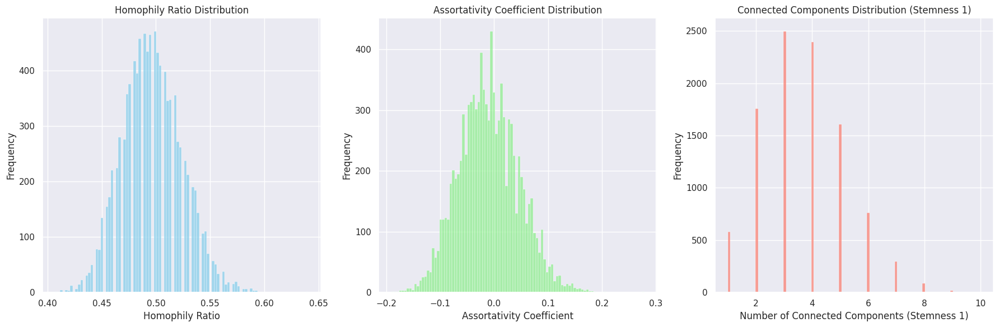

In [112]:
# Set the style of the plot
sns.set(style="darkgrid")

# Number of bins equal to sqrt of number of samples
# (100 in this case of sample of size 10000)
num_bins = 100 # int(np.sqrt(len(random_homophily_df)))

# Define the size of the entire plotting area
plt.figure(figsize=(18, 6))

# Define the plotting space (1 row, 3 columns)
plt.subplot(1, 3, 1)
sns.histplot(random_homophily_df['homophily_ratio'], bins=num_bins, kde=False, color='skyblue')
plt.title('Homophily Ratio Distribution')
plt.xlabel('Homophily Ratio')
plt.ylabel('Frequency')

plt.subplot(1, 3, 2)
sns.histplot(random_homophily_df['assortativity'], bins=num_bins, kde=False, color='lightgreen')
plt.title('Assortativity Coefficient Distribution')
plt.xlabel('Assortativity Coefficient')
plt.ylabel('Frequency')

plt.subplot(1, 3, 3)
sns.histplot(random_homophily_df['connected_components_1'], bins=num_bins, kde=False, color='salmon')
plt.title('Connected Components Distribution (Stemness 1)')
plt.xlabel('Number of Connected Components (Stemness 1)')
plt.ylabel('Frequency')

# Tight layout to ensure no overlap
plt.tight_layout()

plt.show()


They seem to follow a normal distribution, so a z-test will be appropriate (due to the Central Limit Theorem).

In [113]:
random_homophily_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   iteration               10000 non-null  int64  
 1   homophily_ratio         10000 non-null  float64
 2   heterophily_ratio       10000 non-null  float64
 3   assortativity           10000 non-null  float64
 4   connected_components_0  10000 non-null  int64  
 5   connected_components_1  10000 non-null  int64  
dtypes: float64(3), int64(3)
memory usage: 468.9 KB


In [114]:
print('Original values:')
print("Homophily Ratio (Same stemness):", homophily_ratio_in_sph)
print("Heterophily Ratio (Different stemness):", heterophily_ratio_in_sph)
print("Assortativity Coefficient:", assortativity_in_sph)
print("Connected components (Stemness 0):", connected_components_0_in_sph)
print("Connected components (Stemness 1):", connected_components_1_in_sph)

Original values:
Homophily Ratio (Same stemness): 0.7381703470031545
Heterophily Ratio (Different stemness): 0.2618296529968454
Assortativity Coefficient: 0.4716083101547361
Connected components (Stemness 0): 1
Connected components (Stemness 1): 2


#### Statistical Tests for Homophily

To statistically test whether the original network exhibits homophily in the `tails_cut_in_spheroid_GMM_stemness` attribute, we can compare the homophily parameters (like the homophily ratio or assortativity coefficient) of the original graph to the distribution of these parameters in the randomized graphs. One possible approach for this is using a [z-test](https://en.wikipedia.org/wiki/Z-test). The idea is to determine how extreme the original graph's homophily parameter is compared to the randomized distribution. This is appropriate because we're using a large sample (of size $10000 \gg 30$), so the Central Limit Theorem would imply normality provided that the original distribution has well defined first and second momentums (which seems likely from the distribution plots). E.g., for the homophily, the test would be as follows: 

1. **Null Hypothesis (H0)**: The observed homophily in the original graph is not significantly different from what would be expected in a graph with randomly assigned stemness attributes (no homophily).
2. **Alternative Hypothesis (H1)**: The observed homophily in the original graph is significantly higher (or lower) than what would be expected by chance.

The test statistic will be the z-score, which is the number of standard deviations the original homophily ratio is away from the mean of the randomized ratios:

$$ z = \frac{{\text{{Original Homophily Ratio}} - \text{{Mean of Randomized Homophily Ratios}}}}{{\text{{Standard Deviation of Randomized Homophily Ratios}}}} $$

The p-value tells us the probability of observing a test statistic as extreme as, or more extreme than, the one observed under the null hypothesis. We can calculate this based on the z-score assuming the randomized homophily ratios are normally distributed (which, as our sample is large, they should be due to the Central Limit Theorem).

Based on the p-value and a predefined significance level (commonly 0.05), you can reject or fail to reject the null hypothesis. A low p-value (typically $\leq 0.05$) indicates that the observed homophily is significantly different from random. Here, we've used an even more restrictive significance of $\alpha=0.001$, just to be sure.


In [115]:
# Original homophily ratio from G_in_sph
original_homophily_ratio = homophily_ratio_in_sph

# Calculate mean and standard deviation of the homophily ratio from the random graphs
mean_random_homophily = random_homophily_df['homophily_ratio'].mean()
std_random_homophily = random_homophily_df['homophily_ratio'].std()

# Calculate the z-score
z_score = (original_homophily_ratio - mean_random_homophily) / std_random_homophily

# Calculate the p-value (two-tailed test)
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

# Print the results
print("Z-score:", z_score)
print("p-value:", p_value)

# Determine whether to reject the null hypothesis
alpha_test = 0.001  # significance level
if p_value < alpha_test:
    print("Reject the null hypothesis: The network exhibits significant homophily.")
else:
    print("Fail to reject the null hypothesis: The network does not exhibit significant homophily.")


Z-score: 8.787674711956887
p-value: 0.0
Reject the null hypothesis: The network exhibits significant homophily.


In [116]:
# Original Assortativity from G_in_sph
original_assortativity = assortativity_in_sph

# Calculate mean and standard deviation of the homophily ratio from the random graphs
mean_random_assortativity = random_homophily_df['assortativity'].mean()
std_random_assortativity = random_homophily_df['assortativity'].std()

# Calculate the z-score
z_score = (original_assortativity - mean_random_assortativity) / std_random_assortativity

# Calculate the p-value (two-tailed test)
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

# Print the results
print("Z-score:", z_score)
print("p-value:", p_value)

# Determine whether to reject the null hypothesis
alpha_test = 0.001  # significance level
if p_value < alpha_test:
    print("Reject the null hypothesis: The network exhibits significant assortativity.")
else:
    print("Fail to reject the null hypothesis: The network does not exhibit significant assortativity.")

Z-score: 8.734216509591507
p-value: 0.0
Reject the null hypothesis: The network exhibits significant assortativity.


In [117]:
# Original Number of Stem Connected Components from G_in_sph
original_stem_connected_components = connected_components_1_in_sph

# Calculate mean and standard deviation of the homophily ratio from the random graphs
mean_random_stem_connected_components = random_homophily_df['connected_components_1'].mean()
std_random_stem_connected_components = random_homophily_df['connected_components_1'].std()

# Calculate the z-score
z_score = (original_stem_connected_components - mean_random_stem_connected_components) / std_random_stem_connected_components

# Calculate the p-value (two-tailed test)
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

# Print the results
print("Z-score:", z_score)
print("p-value:", p_value)

# Determine whether to reject the null hypothesis
alpha_test = 0.001  # significance level
if p_value < alpha_test:
    print("Reject the null hypothesis: The (experimental) network exhibits significantly less stem connected components.")
else:
    print("Fail to reject the null hypothesis: The network does not exhibit significantly less stem connected components.")

Z-score: -1.105669565886692
p-value: 0.2688695674332542
Fail to reject the null hypothesis: The network does not exhibit significantly less stem connected components.


### Degree Distribution
Of `G_in_sph` and `subgraph_1_in_sph`. La distribución de grado del grafo completo es independiente del stemness. Lo más interesante es cómo varía la del subgrafo de madres.

#### Grafo original

Mean degree: 4.47457627118644
Standard deviation of degrees: 1.7109411841755782
Skewness of degree distribution: -0.21049450063825353
Kurtosis of degree distribution: -0.32646759652952984


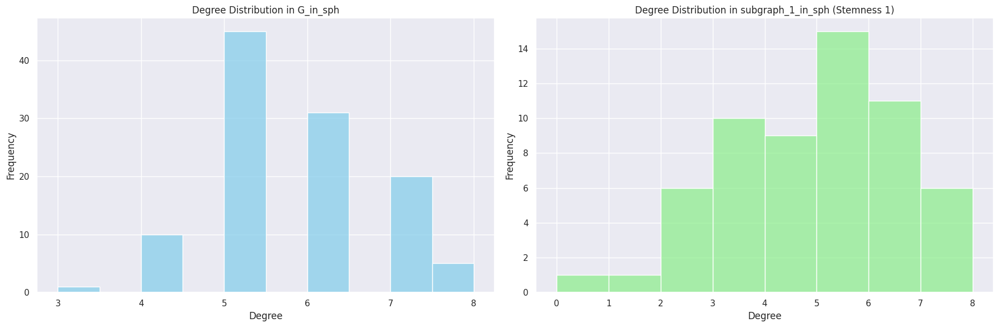

In [118]:
# Calculate the degree of each node in G_in_sph
degrees_in_sph = [degree for node, degree in G_in_sph.degree()]

# Calculate the degree of each node in subgraph_1_in_sph
degrees_subgraph_1_in_sph = [degree for node, degree in subgraph_1_in_sph.degree()]

# Calculate statistics
mean_degrees = np.mean(degrees_subgraph_1_in_sph)
std_dev_degrees = np.std(degrees_subgraph_1_in_sph)
skewness_degrees = stats.skew(degrees_subgraph_1_in_sph)
kurtosis_degrees = stats.kurtosis(degrees_subgraph_1_in_sph)

# Display the statistics
print(f"Mean degree: {mean_degrees}")
print(f"Standard deviation of degrees: {std_dev_degrees}")
print(f"Skewness of degree distribution: {skewness_degrees}")
print(f"Kurtosis of degree distribution: {kurtosis_degrees}")

# Set the style of the plot
sns.set(style="darkgrid")

# Calculate the square root of the number of nodes for each graph to determine the number of bins
bins_in_sph = int(np.sqrt(len(G_in_sph.nodes())))
bins_subgraph_1_in_sph = 8 # int(np.sqrt(len(subgraph_1_in_sph.nodes())))

# Define the size of the entire plotting area
plt.figure(figsize=(18, 6))

# Plotting the degree distribution of G_in_sph
plt.subplot(1, 2, 1)
sns.histplot(degrees_in_sph, bins=bins_in_sph, kde=False, color='skyblue')
plt.title('Degree Distribution in G_in_sph')
plt.xlabel('Degree')
plt.ylabel('Frequency')

# Plotting the degree distribution of subgraph_1_in_sph
plt.subplot(1, 2, 2)
sns.histplot(degrees_subgraph_1_in_sph, bins=bins_subgraph_1_in_sph, kde=False, color='lightgreen')
plt.title('Degree Distribution in subgraph_1_in_sph (Stemness 1)')
plt.xlabel('Degree')
plt.ylabel('Frequency')

# Tight layout to ensure no overlap
plt.tight_layout()

plt.show()



#### Ensamble aleatorizado
Para comparar, veamos la distribución de grados en una muestra de los grafos con ubicación aleatoria de las madres.

In [119]:
# Prepare a list to store the degree distributions
degree_distributions = []

# Number of iterations for randomization (sample size)
iterations = 100

# Set a seed for reproducibility
np.random.seed(42)

# Generate the random graphs and calculate the degree distributions
for i in range(iterations):
    # Create a randomized version of the graph
    G_random = G_in_sph.copy()
    nodes = list(G_random.nodes())
    np.random.shuffle(nodes)
    
    # Randomly assign stemness
    for node in nodes[:stem_count]:
        G_random.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 1
    for node in nodes[stem_count:]:
        G_random.nodes[node]['tails_cut_in_spheroid_GMM_stemness'] = 0

    # Extract the subgraph for stemness 1
    subgraph_1_random = G_random.subgraph([n for n, attrdict in G_random.nodes(data=True) if attrdict['tails_cut_in_spheroid_GMM_stemness'] == 1])

    # Calculate the degree of each node in the subgraph
    degrees = [deg for n, deg in subgraph_1_random.degree()]

    # Add the degree distribution to the list
    degree_distributions.append(degrees)

# Convert the list of degree distributions to a DataFrame for easier plotting
degree_df = pd.DataFrame(degree_distributions).melt(var_name='node_index_in_some_graph', value_name='Degree')

# Note: The 'node_index_in_some_graph' column is not useful,
# it's just a placeholder for the index of each degree distribution in the list.
# E.g., there are `iterations` (100) rows (nodes) with 'node_index_in_some_graph' = 0
# because there were 100 nodes with index 0, one for each randomized graph.

# Initialize lists to store the statistics
means = []
std_devs = []
skewnesses = []
kurtoses = []

# Calculate the statistics for each degree distribution
for degrees in degree_distributions:
    means.append(np.mean(degrees))
    std_devs.append(np.std(degrees))
    skewnesses.append(stats.skew(degrees))
    kurtoses.append(stats.kurtosis(degrees))

# Convert the lists to a DataFrame for easy viewing and analysis
stats_df = pd.DataFrame({
    'Mean': means,
    'Standard Deviation': std_devs,
    'Skewness': skewnesses,
    'Kurtosis': kurtoses
})

# Display the statistics
stats_df.head()

# Optionally, you can calculate and display the overall statistics for the sample
print("\nOverall statistics:")
print("Mean of means:", np.mean(means))
print("Standard deviation of means:", np.std(means))
print("Mean of standard deviations:", np.mean(std_devs))
print("Standard deviation of standard deviations:", np.std(std_devs))
print("Mean of skewnesses:", np.mean(skewnesses))
print("Mean of kurtoses:", np.mean(kurtoses))



Overall statistics:
Mean of means: 2.9664406779661023
Standard deviation of means: 0.17053879839530797
Mean of standard deviations: 1.2415056152776611
Standard deviation of standard deviations: 0.14372712761011405
Mean of skewnesses: 0.10884813521469079
Mean of kurtoses: -0.23142430789039342


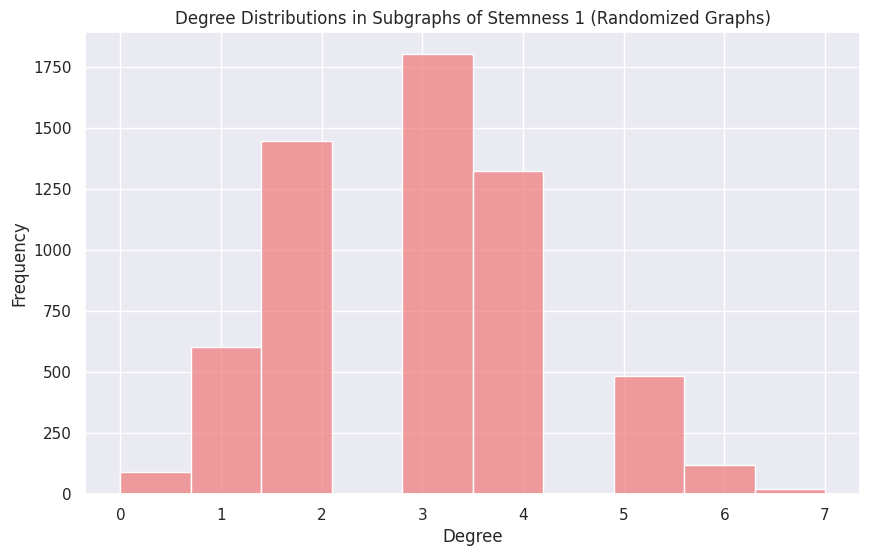

In [120]:
# Plot the degree distributions
plt.figure(figsize=(10, 6))
sns.histplot(degree_df, x='Degree', bins=int(np.sqrt(len(G_in_sph.nodes()))), kde=False, color='lightcoral')
plt.title('Degree Distributions in Subgraphs of Stemness 1 (Randomized Graphs)')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.show()

#### Test para media y desviación estándar de grado

In [121]:
# Display the statistics of the original graph
print(f"Mean degree: {mean_degrees}")
print(f"Standard deviation of degrees: {std_dev_degrees}")
print(f"Skewness of degree distribution: {skewness_degrees}")
print(f"Kurtosis of degree distribution: {kurtosis_degrees}")

Mean degree: 4.47457627118644
Standard deviation of degrees: 1.7109411841755782
Skewness of degree distribution: -0.21049450063825353
Kurtosis of degree distribution: -0.32646759652952984


In [122]:
# Display the statistics for the radomized ensamble
print("\nRandomized ensamble statistics:")
print("Mean of means:", np.mean(means))
print("Standard deviation of means:", np.std(means))
print("Mean of standard deviations:", np.mean(std_devs))
print("Standard deviation of standard deviations:", np.std(std_devs))
print("Mean of skewnesses:", np.mean(skewnesses))
print("Mean of kurtoses:", np.mean(kurtoses))


Randomized ensamble statistics:
Mean of means: 2.9664406779661023
Standard deviation of means: 0.17053879839530797
Mean of standard deviations: 1.2415056152776611
Standard deviation of standard deviations: 0.14372712761011405
Mean of skewnesses: 0.10884813521469079
Mean of kurtoses: -0.23142430789039342


In [123]:
# Original mean degree from subgraph_1_in_sph
original_mean_degree = mean_degrees

# Calculate mean and standard deviation of the mean degree from the random graphs
mean_mean_degree = np.mean(means)
std_mean_degree = np.std(means)

# Calculate the z-score
z_score = (original_mean_degree - mean_mean_degree) / std_mean_degree

# Calculate the p-value (two-tailed test)
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

# Print the results
print("Z-score:", z_score)
print("p-value:", p_value)

# Determine whether to reject the null hypothesis
alpha_test = 0.001  # significance level
if p_value < alpha_test:
    print("Reject the null hypothesis: The networks exhibit significantly different mean degrees.")
else:
    print("Fail to reject the null hypothesis: The networks do not exhibit significantly different mean degrees.")

Z-score: 8.843357684064879
p-value: 0.0
Reject the null hypothesis: The networks exhibit significantly different mean degrees.


In [124]:
# Original standard deviation in degree from subgraph_1_in_sph
original_std_in_degree = std_dev_degrees

# Calculate mean and standard deviation of the standard deviation in degree from the random graphs
mean_std_in_degree = np.mean(std_devs)
std_std_in_degree = np.std(std_devs)

# Calculate the z-score
z_score = (original_std_in_degree - mean_std_in_degree) / std_std_in_degree

# Calculate the p-value (two-tailed test)
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))

# Print the results
print("Z-score:", z_score)
print("p-value:", p_value)

# Determine whether to reject the null hypothesis
alpha_test = 0.001  # significance level
if p_value < alpha_test:
    print("Reject the null hypothesis: The degree distributions of the networks exhibit significantly different standard deviations.")
else:
    print("Fail to reject the null hypothesis: The degree distributions of the networks do not exhibit significantly different standard deviations.")

Z-score: 3.2661584260651635
p-value: 0.0010901723988878675
Fail to reject the null hypothesis: The degree distributions of the networks do not exhibit significantly different standard deviations.


De esto concluimos que la media de la distribución de grado de los nodos del subgrafo de madres (del grafo original) es significativamente diferente a la de un ensamble de grafos con las madres localizadas aleatoriamente. Es mayore para el subgrafo de madres del grafo original (`subgraph_1_in_sph`). 
> Una media mayor indica que las células madres están más conectadas entre sí que lo esperable si estuvieran distribuídas aleatoriamente.

Las desviaciones estándar no son diferentes (la observada para el grafo original está a una desv. est. de la media del ensamble).